In [ ]:
# Install required packages
!pip install tensorflow
!pip install torch torchvision torchaudio

# Simple CNN

In [5]:
import torch.nn as nn

# Define the CNN model
class SimpleCNN(nn.Module):
    def __init__(self, num_classes=10):  # 10 classes for MNIST digits (0-9)
        super(SimpleCNN, self).__init__()
        self.conv1 = nn.Conv2d(1, 32, kernel_size=3, padding=1)  # Input channels = 1 for grayscale
        self.relu1 = nn.ReLU()
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, padding=1)
        self.relu2 = nn.ReLU()
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.flatten = nn.Flatten()
        self.fc1 = nn.Linear(64 * 7 * 7, 128)  
        self.relu3 = nn.ReLU()
        self.fc2 = nn.Linear(128, num_classes)

    def forward(self, x):
        x = self.pool1(self.relu1(self.conv1(x)))
        x = self.pool2(self.relu2(self.conv2(x)))
        x = self.flatten(x)
        x = self.relu3(self.fc1(x))
        x = self.fc2(x)
        return x


'\n# Load MNIST dataset\ntrain_dataset = datasets.MNIST(\n    root="./data", train=True, download=True, transform=transforms.ToTensor()\n)\ntrain_loader = torch.utils.data.DataLoader(train_dataset, batch_size=64, shuffle=True)\n\n# Create model, optimizer, and loss function\nmodel = SimpleCNN()\noptimizer = optim.Adam(model.parameters())\ncriterion = nn.CrossEntropyLoss()\n\n# Training loop\nnum_epochs = 5\nfor epoch in range(num_epochs):\n    for batch_idx, (data, target) in enumerate(train_loader):\n        optimizer.zero_grad()\n        output = model(data)\n        loss = criterion(output, target)\n        loss.backward()\n        optimizer.step()\n\n        if batch_idx % 100 == 0:\n            print(\n                "Train Epoch: {} [{}/{} ({:.0f}%)]\tLoss: {:.6f}".format(\n                    epoch + 1,\n                    batch_idx * len(data),\n                    len(train_loader.dataset),\n                    100.0 * batch_idx / len(train_loader),\n                    loss

# FiveFold Cross-Validation

In [10]:
import torch
from torchvision import datasets, transforms
from collections import Counter
import numpy as np
from sklearn.model_selection import StratifiedKFold
from collections import Counter
import random

# get imbalanced
def get_class_imabalnced(dataset, ratio):
  imbalanced_dataset = []
  for label in range(10):
    count = ratio[label]
    current_count = 0
    for data, target in dataset:
      if target == label and current_count < count:
        imbalanced_dataset.append((data, target))
        current_count += 1
  return imbalanced_dataset

def get_class_imabalnced2(dataset, ratio):
    imbalanced_dataset = []
    for label in range(10):
        count = ratio[label]
        current_count = 0

        # Shuffle data within the class:
        class_data = [(data, target) for data, target in dataset if target == label]
        random.shuffle(class_data)

        selected_indices = set()  # Keep track of selected indices

        for i, (data, target) in enumerate(class_data):  # Use enumerate
            if target == label and current_count < count and i not in selected_indices:
                imbalanced_dataset.append((data, target))
                current_count += 1
                selected_indices.add(i)
    return imbalanced_dataset

# Load dataset
mnist_dataset = datasets.MNIST(
  root="./data", 
  train=True, 
  download=True, 
  transform=transforms.ToTensor()
)

# Prepare data for k-fold cross-validation
X = [data for data, _ in mnist_dataset]
y = [target for _, target in mnist_dataset]

# Initialize k-fold cross-validation
num_folds = 5
batch_size = 100

# Assuming 'y' is your target variable containing class labels
min_samples_per_class = min(Counter(y).values())
max_desired_count = min_samples_per_class // 5  # Dividing by 5 for 5-fold cross-validation

print(f"Minimum samples per class: {min_samples_per_class}")
print(f"Maximum allowed desired_count: {max_desired_count}")

# Create an imbalanced dataset
train_counts = {
  0: 3000,
  1: 2000,
  2: 1000,
  3: 750,
  4: 500,
  5: 12,
  6: 10,
  7: 8,
  8: 6,
  9: 4,
}

test_counts = {
    0: max_desired_count,
    1: max_desired_count,
    2: max_desired_count,
    3: max_desired_count,
    4: max_desired_count,
    5: max_desired_count,
    6: max_desired_count,
    7: max_desired_count,
    8: max_desired_count,
    9: max_desired_count,
}

imbalanced_train_dataset_list = []

kf = StratifiedKFold(n_splits=num_folds, shuffle=True, random_state=42)
# Iterate over folds
folds_data = []
for fold, (train_index, test_index) in enumerate(kf.split(X,y)):
    print(f"Fold {fold + 1}")

    # Get the training data for this fold
    train_dataset_fold = [(X[i], y[i]) for i in train_index]

    # Apply the get_class_imabalnced function to enforce the desired distribution
    train_dataset = get_class_imabalnced2(train_dataset_fold, train_counts)

    imbalanced_train_dataset_list.append(train_dataset)

    # Create test dataset for this fold
    test_dataset_fold = [(X[i], y[i]) for i in test_index]
    test_dataset = get_class_imabalnced2(test_dataset_fold, test_counts)

    # Create datasets and dataloaders for this fold
    train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size , shuffle=True)
    test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size , shuffle=True)

    folds_data.append([train_loader, test_loader])

    # Print class distribution for this fold
    class_counts_train = Counter([label for _, label in train_dataset])
    class_counts_test = Counter([label for _, label in test_dataset])
    print("Class distribution in Train dataset:", class_counts_train)
    print("Class distribution in Test dataset:", class_counts_test)

Minimum samples per class: 5421
Maximum allowed desired_count: 1084
Fold 1
Class distribution in Train dataset: Counter({0: 3000, 1: 2000, 2: 1000, 3: 750, 4: 500, 5: 12, 6: 10, 7: 8, 8: 6, 9: 4})
Class distribution in Test dataset: Counter({0: 1084, 1: 1084, 2: 1084, 3: 1084, 4: 1084, 5: 1084, 6: 1084, 7: 1084, 8: 1084, 9: 1084})
Fold 2
Class distribution in Train dataset: Counter({0: 3000, 1: 2000, 2: 1000, 3: 750, 4: 500, 5: 12, 6: 10, 7: 8, 8: 6, 9: 4})
Class distribution in Test dataset: Counter({0: 1084, 1: 1084, 2: 1084, 3: 1084, 4: 1084, 5: 1084, 6: 1084, 7: 1084, 8: 1084, 9: 1084})
Fold 3
Class distribution in Train dataset: Counter({0: 3000, 1: 2000, 2: 1000, 3: 750, 4: 500, 5: 12, 6: 10, 7: 8, 8: 6, 9: 4})
Class distribution in Test dataset: Counter({0: 1084, 1: 1084, 2: 1084, 3: 1084, 4: 1084, 5: 1084, 6: 1084, 7: 1084, 8: 1084, 9: 1084})
Fold 4
Class distribution in Train dataset: Counter({0: 3000, 1: 2000, 2: 1000, 3: 750, 4: 500, 5: 12, 6: 10, 7: 8, 8: 6, 9: 4})
Class di

In [11]:
len(imbalanced_train_dataset_list)

5

In [12]:
folds_data

[[<torch.utils.data.dataloader.DataLoader at 0x29d5510ac90>,

In [13]:
# save rawdata
import numpy as np
pathsave = 'C:/Users/admin/Desktop/Suvaporn_Lab/DeepSMOTE/CLDeepSMOTE/rawdata_MNIST/train_test.npy'
np.save(pathsave,folds_data)

# Plain (Train-Test)

In [ ]:
# Rank avg list create
rank_acc,rank_pre,rank_rec,rank_f1 = [],[],[],[]

In [18]:
# Create model, optimizer, and loss function
#check gpu
import torch.optim as optim
import torch.nn as nn
import statistics
from tqdm import tqdm

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

#set hyperparameter

num_epochs = 5
LR = 0.01
model = SimpleCNN().to(device)#ResNetMNIST().to(device)#SimpleCNN().to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=LR, momentum=0.0, weight_decay=5e-4) #optim.Adam(model.parameters())

avg_accuracy_list = []
avg_sensitivity_list = []
avg_specificity_list = []
avg_precision_list = []

g_mean_list = []
f_measure_list = []
acsa_list = []
cm_list = []
acsa_list = []

# Training loop
for datatset in folds_data:
    imbalanced_train_loader = datatset[0]
    for epoch in tqdm(range(num_epochs),desc='Loading...'):
        for batch_idx, (data, target) in enumerate(imbalanced_train_loader):
            data = data.to(device)
            target = target.to(device)
            optimizer.zero_grad()

            output = model(data)

            loss = criterion(output, target)
            loss.backward()
            optimizer.step()

    print("Training finished!")

    # measure ACSA, GM, and FM from imbalanced_test_loader
    import numpy as np
    from sklearn.metrics import confusion_matrix

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.eval()  # Set the model to evaluation mode

    imbalanced_test_loader = datatset[1]
    true_labels = []
    predicted_labels = []

    with torch.no_grad():
        for data, target in imbalanced_test_loader:
            data = data.to(device)
            target = target.to(device)

            output = model(data)
            _, predicted = torch.max(output.data, 1)

            true_labels.extend(target.cpu().numpy())
            predicted_labels.extend(predicted.cpu().numpy())

    cm = confusion_matrix(true_labels, predicted_labels)
    cm_list.append(cm)

    ########################## Test ############################################
    # Calculate class-wise accuracy, sensitivity, specificity, and precision
    class_accuracies = []
    class_sensitivities = []
    class_specificities = []
    class_precisions = []

    for i in range(cm.shape[0]):
      tp = cm[i, i]
      fp = np.sum(cm[:, i]) - tp
      fn = np.sum(cm[i, :]) - tp
      tn = np.sum(cm) - tp - fp - fn

      class_accuracy = (tp + tn) / (tp + fp + fn + tn) if (tp + fp + fn + tn) > 0 else 0
      class_sensitivity = tp / (tp + fn) if (tp + fn) > 0 else 0
      class_specificity = tn / (tn + fp) if (tn + fp) > 0 else 0
      class_precision = tp / (tp + fp) if (tp + fp) > 0 else 0

      class_accuracies.append(class_accuracy)
      class_sensitivities.append(class_sensitivity)
      class_specificities.append(class_specificity)
      class_precisions.append(class_precision)

    # Calculate the average accuracy, sensitivity, specificity, and precision
    avg_accuracy = np.mean(class_accuracies)
    avg_sensitivity = np.mean(class_sensitivities)
    avg_specificity = np.mean(class_specificities)
    avg_precision = np.mean(class_precisions)

    # Calculate G-mean and F-measure
    g_mean = np.sqrt(avg_sensitivity * avg_specificity)
    f_measure = 2 * (avg_precision * avg_sensitivity) / (avg_precision + avg_sensitivity) if (avg_precision + avg_sensitivity) > 0 else 0

    # Calculate ACSA (Average Class-wise Sensitivity and Accuracy)
    acsa = (avg_sensitivity + avg_accuracy) / 2

    ## Keep ALL values to list
    avg_accuracy_list.append(avg_accuracy)
    print(avg_accuracy_list)
    avg_sensitivity_list.append(avg_sensitivity)
    avg_specificity_list.append(avg_specificity)
    avg_precision_list.append(avg_precision)
    g_mean_list.append(g_mean)
    f_measure_list.append(f_measure)
    acsa_list.append(acsa)

print("Average Accuracy:", statistics.mean(avg_accuracy_list))
print("Average Sensitivity:", statistics.mean(avg_sensitivity_list))
print("Average Specificity:", statistics.mean(avg_specificity_list))
print("Average Precision:", statistics.mean(avg_precision_list))

print("\nG-mean:", statistics.mean(g_mean_list))
print("F-measure:", statistics.mean(f_measure_list))
print("\nACSA:", statistics.mean(acsa_list))

print(cm_list)

Loading...: 100%|██████████| 5/5 [00:11<00:00,  2.39s/it]


Training finished!
[0.8925276752767528]


Loading...: 100%|██████████| 5/5 [00:11<00:00,  2.30s/it]


Training finished!
[0.8925276752767528, 0.8950553505535057]


Loading...: 100%|██████████| 5/5 [00:11<00:00,  2.36s/it]


Training finished!
[0.8925276752767528, 0.8950553505535057, 0.8955719557195572]


Loading...: 100%|██████████| 5/5 [00:11<00:00,  2.36s/it]


Training finished!
[0.8925276752767528, 0.8950553505535057, 0.8955719557195572, 0.8959040590405906]


Loading...: 100%|██████████| 5/5 [00:11<00:00,  2.36s/it]


Training finished!
[0.8925276752767528, 0.8950553505535057, 0.8955719557195572, 0.8959040590405906, 0.8961808118081181]
Average Accuracy: 0.8950479704797049
Average Sensitivity: 0.47523985239852395
Average Specificity: 0.9416933169331694
Average Precision: 0.2645096320624609

G-mean: 0.6689625901340559
F-measure: 0.3382560923026418

ACSA: 0.6851439114391145
[array([[1066,    4,    2,    8,    4,    0,    0,    0,    0,    0],
       [   0, 1069,    8,    7,    0,    0,    0,    0,    0,    0],
       [  23,   28,  966,   46,   21,    0,    0,    0,    0,    0],
       [  24,   60,   47,  944,    9,    0,    0,    0,    0,    0],
       [  14,   74,   21,    5,  970,    0,    0,    0,    0,    0],
       [ 414,  131,   33,  366,  140,    0,    0,    0,    0,    0],
       [ 276,  109,  630,   19,   50,    0,    0,    0,    0,    0],
       [ 175,  226,   30,  397,  256,    0,    0,    0,    0,    0],
       [ 204,  276,   73,  413,  118,    0,    0,    0,    0,    0],
       [  77,  157

In [19]:
rank_acc.append(avg_accuracy_list)
rank_pre.append(avg_precision_list)
rank_rec.append(avg_sensitivity_list)
rank_f1.append(f_measure_list)

# DeepCLSMOTE (Train-Test)

In [60]:
import torch
import torch.nn as nn
from torch.utils.data import TensorDataset
import numpy as np
from sklearn.neighbors import NearestNeighbors
import time
import os
import sys
from tqdm import tqdm


print(torch.version.cuda) 
device = 'cuda' if torch.cuda.is_available() else 'cpu'
t3 = time.time()
##############################################################################
args = {}
args['dim_h'] = 64         # factor controlling size of hidden layers
args['n_channel'] = 1      # number of channels in the input data
args['n_z'] = 20           # number of dimensions in latent space.
args['sigma'] = 1.0        # variance in n_z
args['lambda'] = 0.01      # hyper param for weight of discriminator loss
args['lr'] = 0.0002        # learning rate for Adam optimizer 
args['epochs'] = 200       # how many epochs to run 
args['batch_size'] = 100   # batch size for SGD
args['dataset'] = 'mnist'  #'fmnist' # specify which dataset to use
args['num_class'] = 10
##############################################################################


## create encoder model and decoder model
class Encoder(nn.Module):
    def __init__(self, args):
        super(Encoder, self).__init__()

        self.n_channel = args['n_channel']
        self.dim_h = args['dim_h']
        self.n_z = args['n_z']

        # convolutional 
        self.conv = nn.Sequential(
            nn.Conv2d(self.n_channel, self.dim_h, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(self.dim_h, self.dim_h * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(self.dim_h * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(self.dim_h * 2, self.dim_h * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(self.dim_h * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(self.dim_h * 4, self.dim_h * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(self.dim_h * 8), 
            nn.LeakyReLU(0.2, inplace=True) )

        # final layer is fully connected
        self.fc = nn.Linear(self.dim_h * (2 ** 3), self.n_z)
    def forward(self, x, labsn):

        x = self.conv(x)

        # For Class_loss
        train_list = [[] for _ in range(args['num_class'])]
        list_class_latent = [[] for _ in range(args['num_class'])]

        for i, label in enumerate(labsn):
          train_list[label].append(torch.tensor(x[i].cpu().detach().numpy()))

        for i, label in enumerate(labsn):
          test = torch.stack(train_list[label])
          #Each class
          x0 =  test.squeeze().to(device) 
          x0_linear = self.fc(x0)
          list_class_latent[label] = x0_linear

        # Mixed Class
        x = x.squeeze()
        x = self.fc(x)

        return x, list_class_latent


class Decoder(nn.Module):
    def __init__(self, args):
        super(Decoder, self).__init__()

        self.n_channel = args['n_channel']
        self.dim_h = args['dim_h']
        self.n_z = args['n_z']

        # first layer is fully connected
        self.fc = nn.Sequential(
            nn.Linear(self.n_z, self.dim_h * 8 * 7 * 7),
            nn.ReLU())

        # deconvolutional filters, essentially inverse of convolutional filters
        self.deconv = nn.Sequential(
            nn.ConvTranspose2d(self.dim_h * 8, self.dim_h * 4, 4),
            nn.BatchNorm2d(self.dim_h * 4),
            nn.ReLU(True),
            nn.ConvTranspose2d(self.dim_h * 4, self.dim_h * 2, 4),
            nn.BatchNorm2d(self.dim_h * 2),
            nn.ReLU(True),
            nn.ConvTranspose2d(self.dim_h * 2, 1, 4, stride=2),
            nn.Tanh())

    def forward(self, x):
        x = self.fc(x)
        x = x.view(-1, self.dim_h * 8, 7, 7)
        x = self.deconv(x)
        return x

##############################################################################
"""set models, loss functions"""
# control which parameters are frozen / free for optimization
def free_params(module: nn.Module):
    for p in module.parameters():
        p.requires_grad = True

def frozen_params(module: nn.Module):
    for p in module.parameters():
        p.requires_grad = False

##############################################################################
"""functions to create SMOTE images"""

def biased_get_class1(c,data,target):

    xbeg = data[target == c]  # Filter data based on target value
    ybeg = target[target == c]  # Filter target based on target value

    return xbeg ,ybeg

def G_SM1(X, y,n_to_sample,cl):


    # fitting the model
    n_neigh = min(5 + 1,len(X))
    nn = NearestNeighbors(n_neighbors=n_neigh, n_jobs=1)
    nn.fit(X)
    dist, ind = nn.kneighbors(X)

    # generating samples
    base_indices = np.random.choice(list(range(len(X))),n_to_sample)
    neighbor_indices = np.random.choice(list(range(1, n_neigh)),n_to_sample)

    X_base = X[base_indices]
    X_neighbor = X[ind[base_indices, neighbor_indices]]
    samples = X_base + np.multiply(np.random.rand(n_to_sample,1),
            X_neighbor - X_base)


    #use 10 as label because 0 to 9 real classes and 1 fake/smoted = 10
    return samples, [cl]*n_to_sample

#xsamp, ysamp = SM(xclass,yclass)
###############################################################################
def calculate_diffs(z):
    """
    Calculate the differences between elements in the input list 'z'
    and return the total sum of all differences for each original element.

    Args:
        z (list): A list of lists containing numerical values.

    Returns:
        list: A list containing the total sum of differences for each original element in 'z'.
    """
    all_diffs_list = []  # List to store lists of differences
    for i, arr1 in enumerate(z):
        diffs_for_arr1 = []  # Store differences for this arr1
        for j, arr2 in enumerate(z):
            if i != j:  # Skip comparing with itself
                diffs = []  # Store diffs for this pair of arr1, arr2
                for el1 in arr1:
                    # Calculate the sum of Euclidean distances between el1 and all elements in arr2
                    diff_for_el1 = sum(np.linalg.norm(np.array([el1.cpu().detach().numpy()]) - np.array([el2.cpu().detach().numpy()])) for el2 in arr2)
                    diffs.append(diff_for_el1)  # Append diff for el1 to diffs
                diffs_for_arr1.append(diffs)  # Append the diffs list for the current arr2
        all_diffs_list.append(diffs_for_arr1)  # Append the diffs_for_arr1

    # Sum all elements within each array to get a single total sum
    total_sums = [sum(sum(inner_list) for inner_list in outer_list) for outer_list in all_diffs_list]

    return total_sums

###############################################################################


None



99
cpu


Loading...: 100%|██████████| 73/73 [00:57<00:00,  1.26it/s]


Epoch: 0 	Train Loss: 12.699866 	mse loss: 12.612751 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 1 	Train Loss: 3.420422 	mse loss: 3.345575 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.07s/it]


Epoch: 2 	Train Loss: 2.525722 	mse loss: 2.452240 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.18s/it]


Epoch: 3 	Train Loss: 2.160179 	mse loss: 2.086275 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.10s/it]


Epoch: 4 	Train Loss: 1.888697 	mse loss: 1.819308 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 5 	Train Loss: 1.745598 	mse loss: 1.677562 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 6 	Train Loss: 1.624427 	mse loss: 1.556715 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 7 	Train Loss: 1.517707 	mse loss: 1.452881 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 8 	Train Loss: 1.453649 	mse loss: 1.387695 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 9 	Train Loss: 1.387146 	mse loss: 1.323626 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 10 	Train Loss: 1.346514 	mse loss: 1.280708 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:17<00:00,  1.07s/it]


Epoch: 11 	Train Loss: 1.271860 	mse loss: 1.202659 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 12 	Train Loss: 1.240445 	mse loss: 1.177310 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:26<00:00,  1.19s/it]


Epoch: 13 	Train Loss: 1.203292 	mse loss: 1.138206 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.07s/it]


Epoch: 14 	Train Loss: 1.163899 	mse loss: 1.097674 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:19<00:00,  1.09s/it]


Epoch: 15 	Train Loss: 1.158694 	mse loss: 1.095083 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.07s/it]


Epoch: 16 	Train Loss: 1.109206 	mse loss: 1.044803 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:19<00:00,  1.09s/it]


Epoch: 17 	Train Loss: 1.078415 	mse loss: 1.016332 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:19<00:00,  1.08s/it]


Epoch: 18 	Train Loss: 1.043852 	mse loss: 0.981066 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.08s/it]


Epoch: 19 	Train Loss: 1.044173 	mse loss: 0.980852 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.07s/it]


Epoch: 20 	Train Loss: 1.013697 	mse loss: 0.953307 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.07s/it]


Epoch: 21 	Train Loss: 0.992821 	mse loss: 0.930861 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.08s/it]


Epoch: 22 	Train Loss: 0.983331 	mse loss: 0.921657 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.07s/it]


Epoch: 23 	Train Loss: 0.953547 	mse loss: 0.891237 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.08s/it]


Epoch: 24 	Train Loss: 0.936773 	mse loss: 0.873685 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.08s/it]


Epoch: 25 	Train Loss: 0.940959 	mse loss: 0.878736 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:17<00:00,  1.07s/it]


Epoch: 26 	Train Loss: 0.913177 	mse loss: 0.852352 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:19<00:00,  1.09s/it]


Epoch: 27 	Train Loss: 0.905310 	mse loss: 0.843501 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.08s/it]


Epoch: 28 	Train Loss: 0.880424 	mse loss: 0.819306 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:19<00:00,  1.09s/it]


Epoch: 29 	Train Loss: 0.893412 	mse loss: 0.831265 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:19<00:00,  1.08s/it]


Epoch: 30 	Train Loss: 0.853342 	mse loss: 0.792372 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:17<00:00,  1.06s/it]


Epoch: 31 	Train Loss: 0.852600 	mse loss: 0.796294 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.07s/it]


Epoch: 32 	Train Loss: 0.846526 	mse loss: 0.785552 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:17<00:00,  1.07s/it]


Epoch: 33 	Train Loss: 0.814749 	mse loss: 0.754702 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:17<00:00,  1.06s/it]


Epoch: 34 	Train Loss: 0.821325 	mse loss: 0.763188 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:17<00:00,  1.06s/it]


Epoch: 35 	Train Loss: 0.799319 	mse loss: 0.739058 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:16<00:00,  1.05s/it]


Epoch: 36 	Train Loss: 0.776094 	mse loss: 0.719041 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.11s/it]


Epoch: 37 	Train Loss: 0.787417 	mse loss: 0.728064 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:17<00:00,  1.06s/it]


Epoch: 38 	Train Loss: 0.772819 	mse loss: 0.712991 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:17<00:00,  1.07s/it]


Epoch: 39 	Train Loss: 0.769399 	mse loss: 0.708746 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:16<00:00,  1.05s/it]


Epoch: 40 	Train Loss: 0.757615 	mse loss: 0.699126 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:17<00:00,  1.06s/it]


Epoch: 41 	Train Loss: 0.748136 	mse loss: 0.689135 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.10s/it]


Epoch: 42 	Train Loss: 0.742959 	mse loss: 0.683861 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.07s/it]


Epoch: 43 	Train Loss: 0.728004 	mse loss: 0.671420 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:16<00:00,  1.05s/it]


Epoch: 44 	Train Loss: 0.727035 	mse loss: 0.667538 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:17<00:00,  1.07s/it]


Epoch: 45 	Train Loss: 0.717281 	mse loss: 0.660051 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.10s/it]


Epoch: 46 	Train Loss: 0.714888 	mse loss: 0.657116 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.07s/it]


Epoch: 47 	Train Loss: 0.689675 	mse loss: 0.632050 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:17<00:00,  1.07s/it]


Epoch: 48 	Train Loss: 0.679288 	mse loss: 0.620607 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.07s/it]


Epoch: 49 	Train Loss: 0.698546 	mse loss: 0.640269 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.07s/it]


Epoch: 50 	Train Loss: 0.672504 	mse loss: 0.616531 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:19<00:00,  1.09s/it]


Epoch: 51 	Train Loss: 0.664354 	mse loss: 0.605969 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:19<00:00,  1.09s/it]


Epoch: 52 	Train Loss: 0.667329 	mse loss: 0.611787 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.07s/it]


Epoch: 53 	Train Loss: 0.663851 	mse loss: 0.602788 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:17<00:00,  1.06s/it]


Epoch: 54 	Train Loss: 0.652578 	mse loss: 0.594289 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:19<00:00,  1.09s/it]


Epoch: 55 	Train Loss: 0.648793 	mse loss: 0.593348 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.08s/it]


Epoch: 56 	Train Loss: 0.654559 	mse loss: 0.596674 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:19<00:00,  1.09s/it]


Epoch: 57 	Train Loss: 0.634648 	mse loss: 0.576658 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.10s/it]


Epoch: 58 	Train Loss: 0.617981 	mse loss: 0.559409 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:17<00:00,  1.07s/it]


Epoch: 59 	Train Loss: 0.630540 	mse loss: 0.573207 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:17<00:00,  1.06s/it]


Epoch: 60 	Train Loss: 0.638342 	mse loss: 0.580332 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:19<00:00,  1.09s/it]


Epoch: 61 	Train Loss: 0.630658 	mse loss: 0.573744 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:19<00:00,  1.09s/it]


Epoch: 62 	Train Loss: 0.601588 	mse loss: 0.545176 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.08s/it]


Epoch: 63 	Train Loss: 0.615154 	mse loss: 0.559451 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.07s/it]


Epoch: 64 	Train Loss: 0.591959 	mse loss: 0.534309 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.07s/it]


Epoch: 65 	Train Loss: 0.597664 	mse loss: 0.538792 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:16<00:00,  1.05s/it]


Epoch: 66 	Train Loss: 0.590784 	mse loss: 0.531775 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:19<00:00,  1.09s/it]


Epoch: 67 	Train Loss: 0.578543 	mse loss: 0.523404 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 68 	Train Loss: 0.582686 	mse loss: 0.527586 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:19<00:00,  1.09s/it]


Epoch: 69 	Train Loss: 0.591175 	mse loss: 0.534897 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.08s/it]


Epoch: 70 	Train Loss: 0.579076 	mse loss: 0.522529 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.08s/it]


Epoch: 71 	Train Loss: 0.570218 	mse loss: 0.514645 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:16<00:00,  1.05s/it]


Epoch: 72 	Train Loss: 0.568772 	mse loss: 0.510430 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 73 	Train Loss: 0.572660 	mse loss: 0.516667 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 74 	Train Loss: 0.545238 	mse loss: 0.489227 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 75 	Train Loss: 0.559051 	mse loss: 0.501856 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 76 	Train Loss: 0.542102 	mse loss: 0.488148 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 77 	Train Loss: 0.542840 	mse loss: 0.487151 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 78 	Train Loss: 0.550548 	mse loss: 0.491778 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 79 	Train Loss: 0.533116 	mse loss: 0.476610 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 80 	Train Loss: 0.535269 	mse loss: 0.476732 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:26<00:00,  1.18s/it]


Epoch: 81 	Train Loss: 0.521396 	mse loss: 0.465310 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 82 	Train Loss: 0.525745 	mse loss: 0.469741 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 83 	Train Loss: 0.521386 	mse loss: 0.465966 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 84 	Train Loss: 0.506813 	mse loss: 0.451494 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 85 	Train Loss: 0.526480 	mse loss: 0.468339 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 86 	Train Loss: 0.515990 	mse loss: 0.460121 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 87 	Train Loss: 0.509849 	mse loss: 0.453785 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 88 	Train Loss: 0.513522 	mse loss: 0.456595 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 89 	Train Loss: 0.498428 	mse loss: 0.442273 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 90 	Train Loss: 0.499799 	mse loss: 0.443030 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 91 	Train Loss: 0.484366 	mse loss: 0.429481 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.12s/it]


Epoch: 92 	Train Loss: 0.498444 	mse loss: 0.443072 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 93 	Train Loss: 0.477200 	mse loss: 0.422310 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 94 	Train Loss: 0.494597 	mse loss: 0.440963 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 95 	Train Loss: 0.489239 	mse loss: 0.433822 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.12s/it]


Epoch: 96 	Train Loss: 0.487033 	mse loss: 0.431204 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 97 	Train Loss: 0.471720 	mse loss: 0.417001 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 98 	Train Loss: 0.469387 	mse loss: 0.412578 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 99 	Train Loss: 0.479500 	mse loss: 0.424834 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 100 	Train Loss: 0.476477 	mse loss: 0.422122 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 101 	Train Loss: 0.462032 	mse loss: 0.406688 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 102 	Train Loss: 0.469586 	mse loss: 0.414698 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 103 	Train Loss: 0.465112 	mse loss: 0.409900 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 104 	Train Loss: 0.463208 	mse loss: 0.406644 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:26<00:00,  1.18s/it]


Epoch: 105 	Train Loss: 0.458205 	mse loss: 0.403379 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 106 	Train Loss: 0.441015 	mse loss: 0.387069 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 107 	Train Loss: 0.447456 	mse loss: 0.392828 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 108 	Train Loss: 0.454914 	mse loss: 0.397951 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 109 	Train Loss: 0.434060 	mse loss: 0.379348 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 110 	Train Loss: 0.443555 	mse loss: 0.388860 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 111 	Train Loss: 0.443222 	mse loss: 0.388675 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 112 	Train Loss: 0.436951 	mse loss: 0.380654 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 113 	Train Loss: 0.435500 	mse loss: 0.379654 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 114 	Train Loss: 0.421168 	mse loss: 0.366370 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 115 	Train Loss: 0.433066 	mse loss: 0.375765 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 116 	Train Loss: 0.428723 	mse loss: 0.372669 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 117 	Train Loss: 0.426808 	mse loss: 0.371242 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.16s/it]


Epoch: 118 	Train Loss: 0.427624 	mse loss: 0.370638 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 119 	Train Loss: 0.414430 	mse loss: 0.359325 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 120 	Train Loss: 0.408503 	mse loss: 0.352967 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 121 	Train Loss: 0.410607 	mse loss: 0.355015 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 122 	Train Loss: 0.411991 	mse loss: 0.356601 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 123 	Train Loss: 0.407353 	mse loss: 0.353665 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 124 	Train Loss: 0.409260 	mse loss: 0.354154 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 125 	Train Loss: 0.401062 	mse loss: 0.348439 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 126 	Train Loss: 0.405253 	mse loss: 0.351266 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 127 	Train Loss: 0.400320 	mse loss: 0.346038 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 128 	Train Loss: 0.406695 	mse loss: 0.348984 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 129 	Train Loss: 0.397640 	mse loss: 0.344902 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:26<00:00,  1.18s/it]


Epoch: 130 	Train Loss: 0.387138 	mse loss: 0.333023 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 131 	Train Loss: 0.394789 	mse loss: 0.337217 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 132 	Train Loss: 0.385441 	mse loss: 0.330230 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 133 	Train Loss: 0.389643 	mse loss: 0.336362 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.08s/it]


Epoch: 134 	Train Loss: 0.396831 	mse loss: 0.341194 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 135 	Train Loss: 0.390334 	mse loss: 0.335654 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 136 	Train Loss: 0.387346 	mse loss: 0.332444 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.18s/it]


Epoch: 137 	Train Loss: 0.385752 	mse loss: 0.332541 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 138 	Train Loss: 0.379604 	mse loss: 0.326004 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.18s/it]


Epoch: 139 	Train Loss: 0.379301 	mse loss: 0.323898 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 140 	Train Loss: 0.381567 	mse loss: 0.328336 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 141 	Train Loss: 0.366367 	mse loss: 0.310281 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 142 	Train Loss: 0.362146 	mse loss: 0.307825 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 143 	Train Loss: 0.368509 	mse loss: 0.315090 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 144 	Train Loss: 0.372327 	mse loss: 0.315774 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.18s/it]


Epoch: 145 	Train Loss: 0.367325 	mse loss: 0.313482 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 146 	Train Loss: 0.364247 	mse loss: 0.309776 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 147 	Train Loss: 0.363000 	mse loss: 0.309445 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 148 	Train Loss: 0.368031 	mse loss: 0.313815 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.12s/it]


Epoch: 149 	Train Loss: 0.355409 	mse loss: 0.299659 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 150 	Train Loss: 0.356376 	mse loss: 0.302983 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 151 	Train Loss: 0.366523 	mse loss: 0.310812 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 152 	Train Loss: 0.347431 	mse loss: 0.293141 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.16s/it]


Epoch: 153 	Train Loss: 0.345445 	mse loss: 0.290839 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 154 	Train Loss: 0.353228 	mse loss: 0.299925 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 155 	Train Loss: 0.344245 	mse loss: 0.287218 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 156 	Train Loss: 0.343133 	mse loss: 0.288948 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 157 	Train Loss: 0.358177 	mse loss: 0.304412 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 158 	Train Loss: 0.343764 	mse loss: 0.288629 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.27s/it]


Epoch: 159 	Train Loss: 0.348622 	mse loss: 0.294013 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:33<00:00,  1.28s/it]


Epoch: 160 	Train Loss: 0.341232 	mse loss: 0.287158 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.22s/it]


Epoch: 161 	Train Loss: 0.341865 	mse loss: 0.285919 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:27<00:00,  1.19s/it]


Epoch: 162 	Train Loss: 0.338792 	mse loss: 0.284964 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:26<00:00,  1.18s/it]


Epoch: 163 	Train Loss: 0.339587 	mse loss: 0.286180 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:26<00:00,  1.19s/it]


Epoch: 164 	Train Loss: 0.335522 	mse loss: 0.282036 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:26<00:00,  1.19s/it]


Epoch: 165 	Train Loss: 0.334600 	mse loss: 0.281103 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.22s/it]


Epoch: 166 	Train Loss: 0.339702 	mse loss: 0.286256 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.25s/it]


Epoch: 167 	Train Loss: 0.335456 	mse loss: 0.282385 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.25s/it]


Epoch: 168 	Train Loss: 0.323340 	mse loss: 0.271183 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.25s/it]


Epoch: 169 	Train Loss: 0.331587 	mse loss: 0.276039 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.24s/it]


Epoch: 170 	Train Loss: 0.332929 	mse loss: 0.279758 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.22s/it]


Epoch: 171 	Train Loss: 0.326102 	mse loss: 0.272731 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.25s/it]


Epoch: 172 	Train Loss: 0.332853 	mse loss: 0.279530 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:33<00:00,  1.28s/it]


Epoch: 173 	Train Loss: 0.323468 	mse loss: 0.269754 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:35<00:00,  1.30s/it]


Epoch: 174 	Train Loss: 0.331626 	mse loss: 0.277038 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.27s/it]


Epoch: 175 	Train Loss: 0.319397 	mse loss: 0.264510 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:39<00:00,  1.36s/it]


Epoch: 176 	Train Loss: 0.307913 	mse loss: 0.254449 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:39<00:00,  1.36s/it]


Epoch: 177 	Train Loss: 0.316081 	mse loss: 0.263789 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:39<00:00,  1.36s/it]


Epoch: 178 	Train Loss: 0.321452 	mse loss: 0.269821 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:40<00:00,  1.37s/it]


Epoch: 179 	Train Loss: 0.316348 	mse loss: 0.262478 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:39<00:00,  1.36s/it]


Epoch: 180 	Train Loss: 0.309598 	mse loss: 0.256344 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:41<00:00,  1.39s/it]


Epoch: 181 	Train Loss: 0.320700 	mse loss: 0.266644 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:42<00:00,  1.40s/it]


Epoch: 182 	Train Loss: 0.323839 	mse loss: 0.268866 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:44<00:00,  1.43s/it]


Epoch: 183 	Train Loss: 0.318989 	mse loss: 0.266083 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:45<00:00,  1.44s/it]


Epoch: 184 	Train Loss: 0.308424 	mse loss: 0.255325 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:42<00:00,  1.41s/it]


Epoch: 185 	Train Loss: 0.315147 	mse loss: 0.260455 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:38<00:00,  1.35s/it]


Epoch: 186 	Train Loss: 0.317455 	mse loss: 0.263190 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:35<00:00,  1.31s/it]


Epoch: 187 	Train Loss: 0.304176 	mse loss: 0.248335 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:39<00:00,  1.37s/it]


Epoch: 188 	Train Loss: 0.306195 	mse loss: 0.253811 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.26s/it]


Epoch: 189 	Train Loss: 0.299214 	mse loss: 0.245410 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:38<00:00,  1.35s/it]


Epoch: 190 	Train Loss: 0.305830 	mse loss: 0.252825 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:40<00:00,  1.38s/it]


Epoch: 191 	Train Loss: 0.310140 	mse loss: 0.257030 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:35<00:00,  1.30s/it]


Epoch: 192 	Train Loss: 0.295432 	mse loss: 0.242596 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:40<00:00,  1.37s/it]


Epoch: 193 	Train Loss: 0.297490 	mse loss: 0.241626 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:36<00:00,  1.32s/it]


Epoch: 194 	Train Loss: 0.303404 	mse loss: 0.249944 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:39<00:00,  1.37s/it]


Epoch: 195 	Train Loss: 0.293862 	mse loss: 0.239719 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:34<00:00,  1.30s/it]


Epoch: 196 	Train Loss: 0.292017 	mse loss: 0.238655 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:35<00:00,  1.31s/it]


Epoch: 197 	Train Loss: 0.297434 	mse loss: 0.245224 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:36<00:00,  1.32s/it]


Epoch: 198 	Train Loss: 0.294995 	mse loss: 0.241496 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 199 	Train Loss: 0.297146 	mse loss: 0.244738 	mse2 loss: 0.000000
C:/Users/admin/Desktop/Suvaporn_Lab/DeepSMOTE/CLDeepSMOTE/model/enc.pth
C:/Users/admin/Desktop/Suvaporn_Lab/DeepSMOTE/CLDeepSMOTE/model/dec.pth

total time(min): 281.35


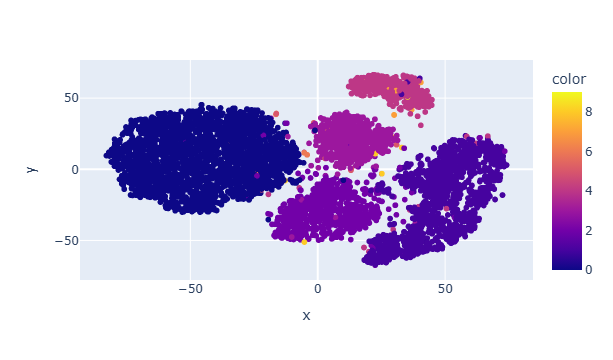

0
torch.Size([2000, 1, 28, 28])
class tensor(1)
torch.Size([2000, 20])
(1000, 20)
1000
(1000,)
(1000, 1, 28, 28)
(1000, 1, 28, 28)


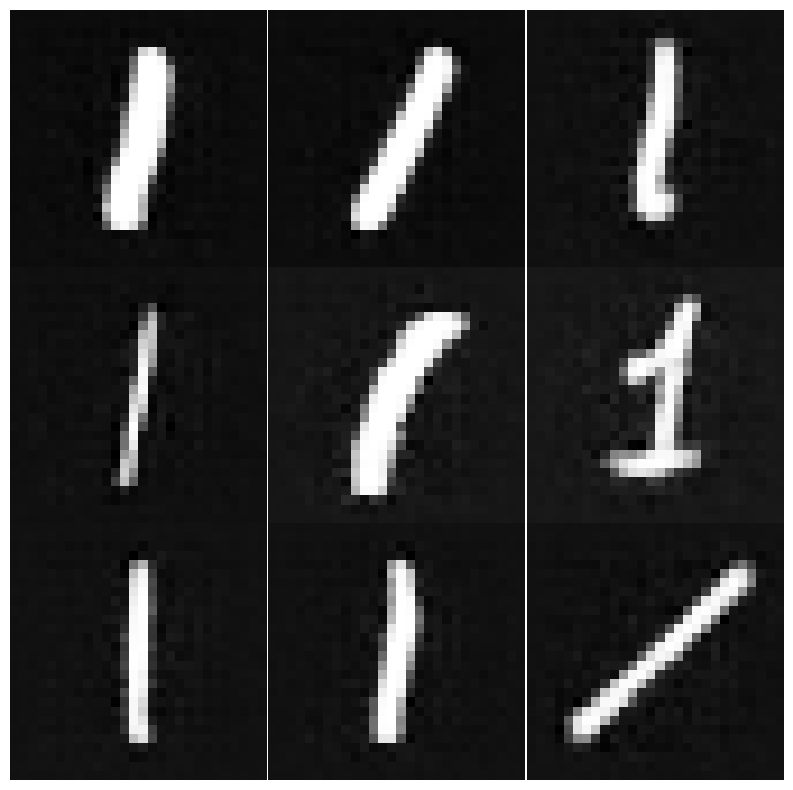

torch.Size([1000, 1, 28, 28])
class tensor(2)
torch.Size([1000, 20])
(2000, 20)
2000
(2000,)
(2000, 1, 28, 28)
(2000, 1, 28, 28)


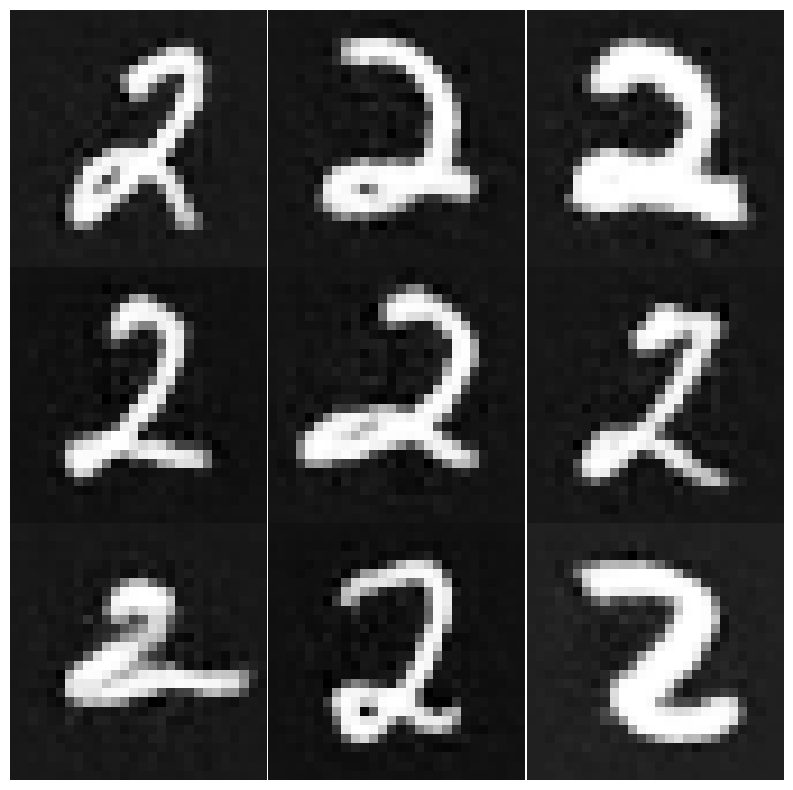

torch.Size([750, 1, 28, 28])
class tensor(3)
torch.Size([750, 20])
(2250, 20)
2250
(2250,)
(2250, 1, 28, 28)
(2250, 1, 28, 28)


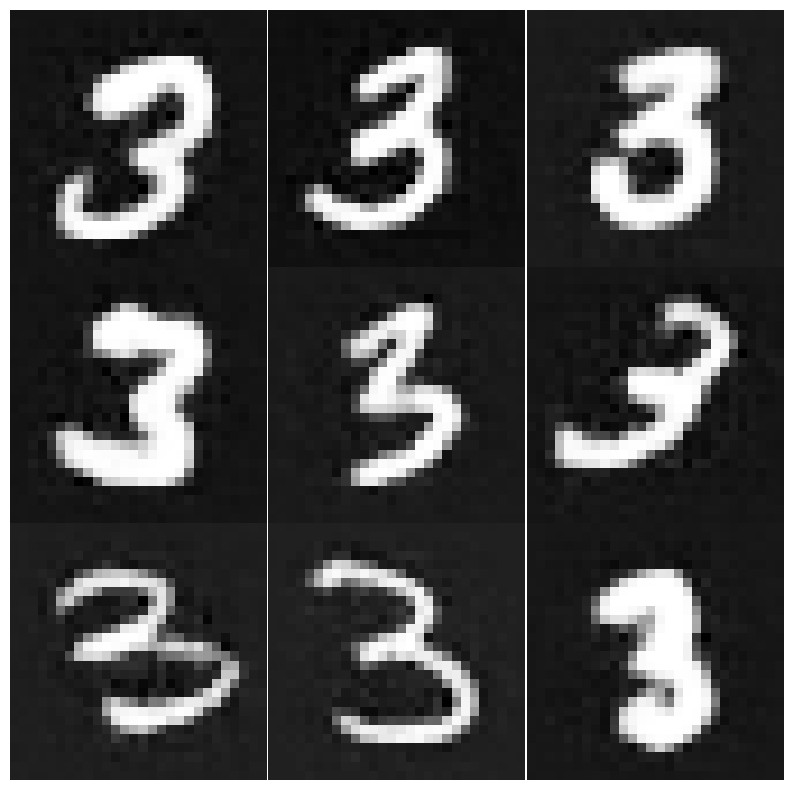

torch.Size([500, 1, 28, 28])
class tensor(4)
torch.Size([500, 20])
(2500, 20)
2500
(2500,)
(2500, 1, 28, 28)
(2500, 1, 28, 28)


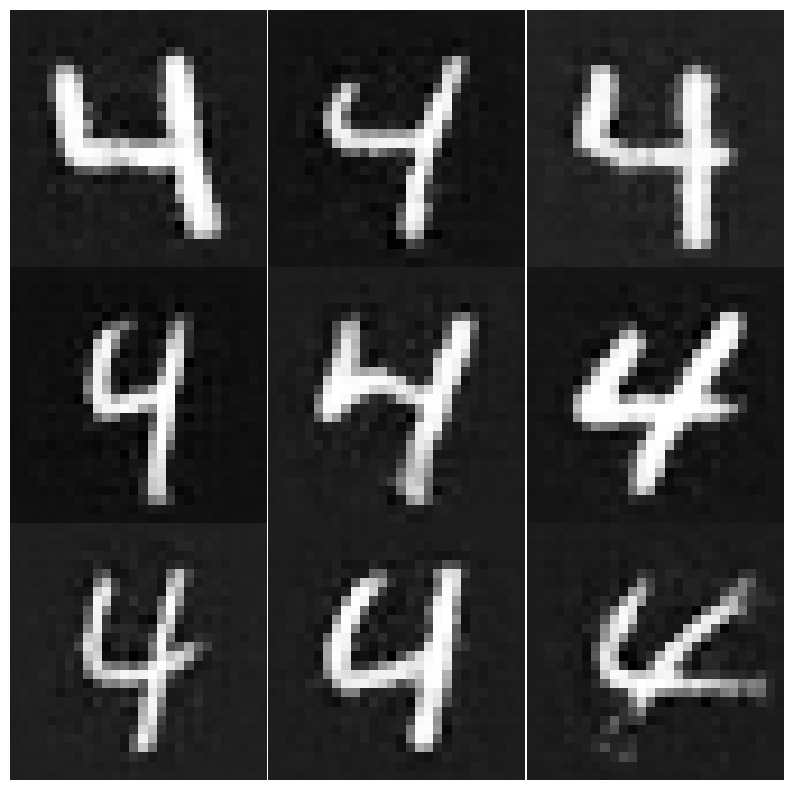

torch.Size([12, 1, 28, 28])
class tensor(5)
torch.Size([12, 20])
(2988, 20)
2988
(2988,)
(2988, 1, 28, 28)
(2988, 1, 28, 28)


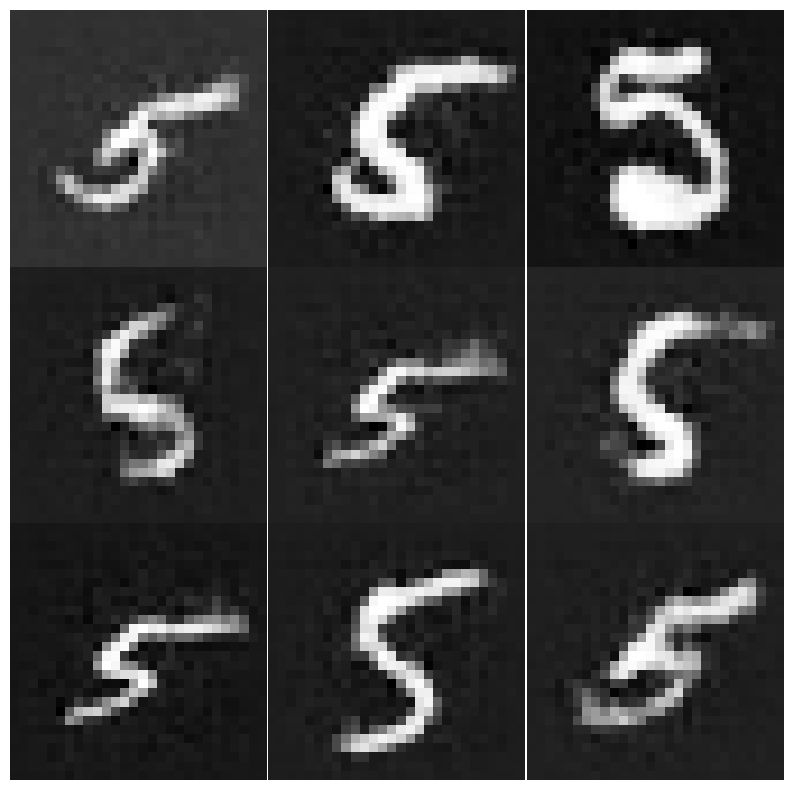

torch.Size([10, 1, 28, 28])
class tensor(6)
torch.Size([10, 20])
(2990, 20)
2990
(2990,)
(2990, 1, 28, 28)
(2990, 1, 28, 28)


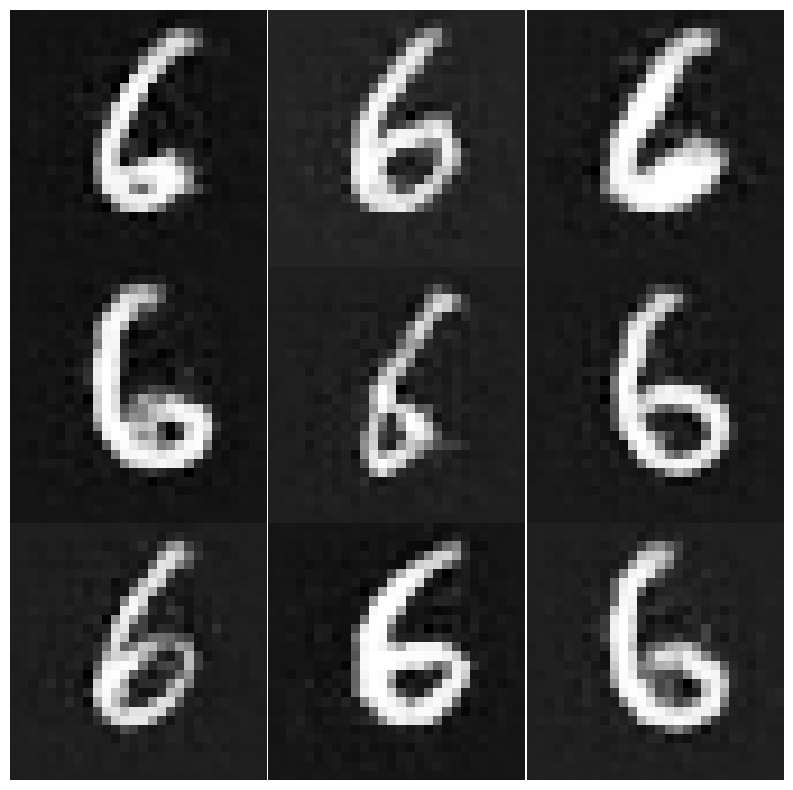

torch.Size([8, 1, 28, 28])
class tensor(7)
torch.Size([8, 20])
(2992, 20)
2992
(2992,)
(2992, 1, 28, 28)
(2992, 1, 28, 28)


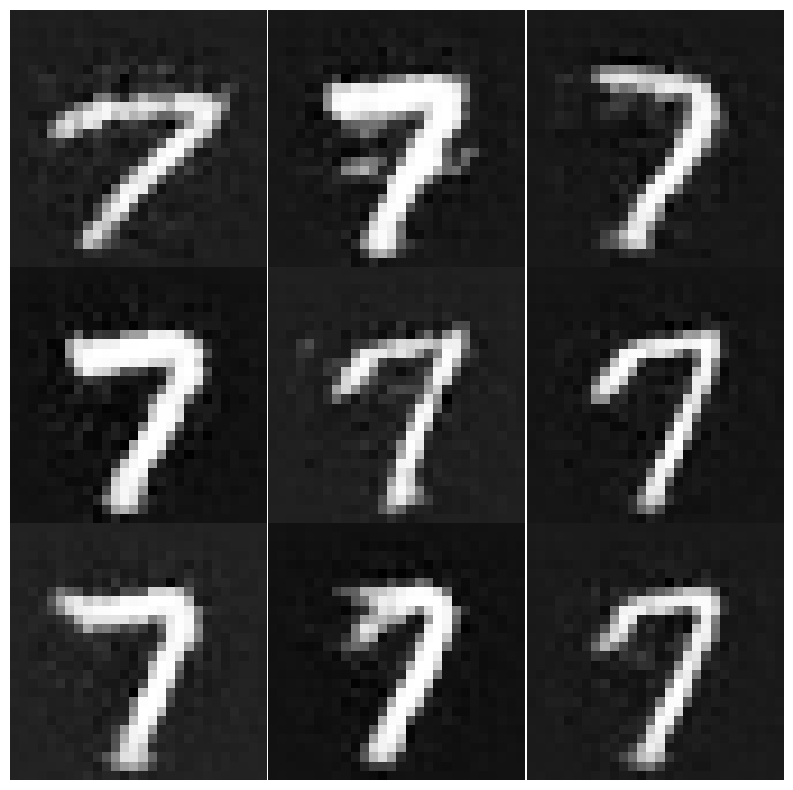

torch.Size([6, 1, 28, 28])
class tensor(8)
torch.Size([6, 20])
(2994, 20)
2994
(2994,)
(2994, 1, 28, 28)
(2994, 1, 28, 28)


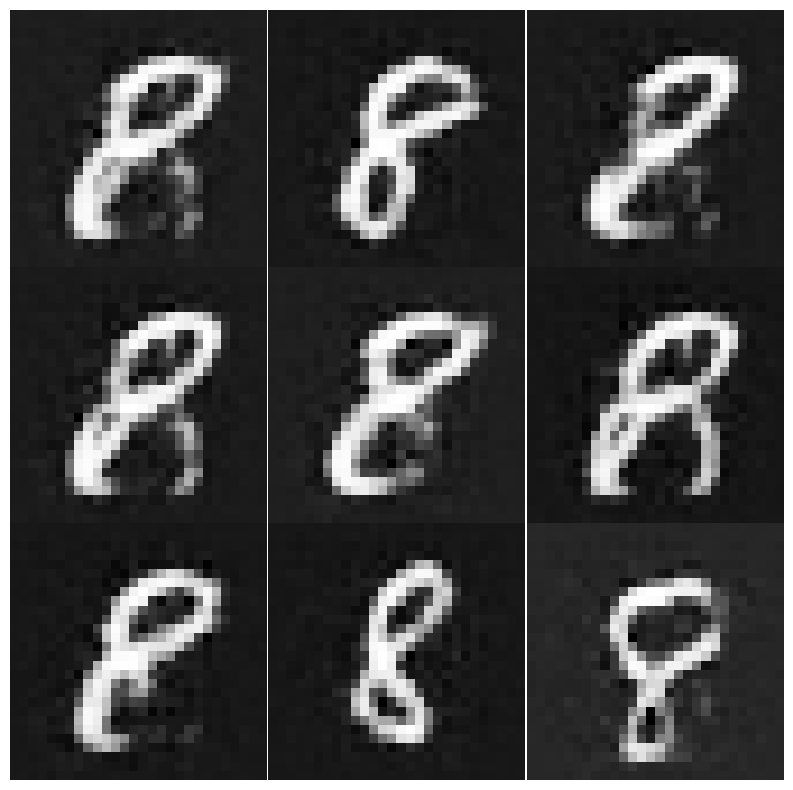

torch.Size([4, 1, 28, 28])
class tensor(9)
torch.Size([4, 20])
(2996, 20)
2996
(2996,)
(2996, 1, 28, 28)
(2996, 1, 28, 28)


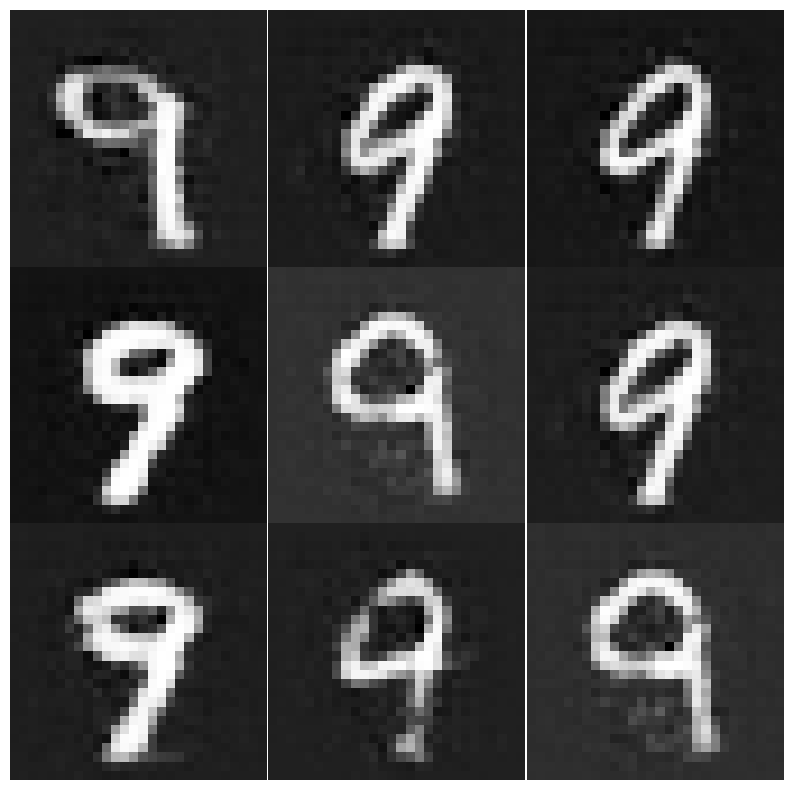

(22710, 1, 28, 28)
(22710,)
(22710, 784)
decx1  torch.Size([7290, 784])
(30000, 784)
(30000,)

final time(min): 1.36
#Dataset = 1


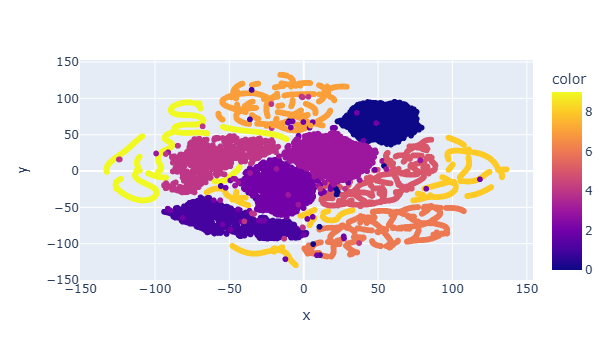

#Dataset = 1
(30000, 1, 28, 28)
(30000,)
Counter({1.0: 3000, 2.0: 3000, 3.0: 3000, 4.0: 3000, 5.0: 3000, 6.0: 3000, 7.0: 3000, 8.0: 3000, 9.0: 3000, 0.0: 3000})
train imgs after reshape  (30000, 1, 28, 28)
Train Epoch: 1 [1000/30000 (3%)]	Loss: 2.288446
Train Epoch: 1 [2000/30000 (7%)]	Loss: 2.271768
Train Epoch: 1 [3000/30000 (10%)]	Loss: 2.232247
Train Epoch: 1 [4000/30000 (13%)]	Loss: 2.169742
Train Epoch: 1 [5000/30000 (17%)]	Loss: 2.030448
Train Epoch: 1 [6000/30000 (20%)]	Loss: 1.463360
Train Epoch: 1 [7000/30000 (23%)]	Loss: 0.640813
Train Epoch: 1 [8000/30000 (27%)]	Loss: 0.602178
Train Epoch: 1 [9000/30000 (30%)]	Loss: 0.298240
Train Epoch: 1 [10000/30000 (33%)]	Loss: 0.247733
Train Epoch: 1 [11000/30000 (37%)]	Loss: 0.255757
Train Epoch: 1 [12000/30000 (40%)]	Loss: 0.305682
Train Epoch: 1 [13000/30000 (43%)]	Loss: 0.148772
Train Epoch: 1 [14000/30000 (47%)]	Loss: 0.131638
Train Epoch: 1 [15000/30000 (50%)]	Loss: 0.088834
Train Epoch: 1 [16000/30000 (53%)]	Loss: 0.260795
Train

Loading...: 100%|██████████| 73/73 [01:34<00:00,  1.30s/it]


Epoch: 0 	Train Loss: 12.722664 	mse loss: 12.629912 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.26s/it]


Epoch: 1 	Train Loss: 4.563682 	mse loss: 4.473798 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.26s/it]


Epoch: 2 	Train Loss: 3.305213 	mse loss: 3.219600 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.27s/it]


Epoch: 3 	Train Loss: 2.630212 	mse loss: 2.543165 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.26s/it]


Epoch: 4 	Train Loss: 2.057681 	mse loss: 1.970919 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.27s/it]


Epoch: 5 	Train Loss: 1.774848 	mse loss: 1.695484 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:34<00:00,  1.30s/it]


Epoch: 6 	Train Loss: 1.623565 	mse loss: 1.544807 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.26s/it]


Epoch: 7 	Train Loss: 1.564393 	mse loss: 1.484849 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.27s/it]


Epoch: 8 	Train Loss: 1.431365 	mse loss: 1.354537 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:35<00:00,  1.31s/it]


Epoch: 9 	Train Loss: 1.379684 	mse loss: 1.301383 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:33<00:00,  1.28s/it]


Epoch: 10 	Train Loss: 1.316726 	mse loss: 1.241140 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.25s/it]


Epoch: 11 	Train Loss: 1.261608 	mse loss: 1.189065 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:34<00:00,  1.29s/it]


Epoch: 12 	Train Loss: 1.225439 	mse loss: 1.150435 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.22s/it]


Epoch: 13 	Train Loss: 1.172354 	mse loss: 1.097853 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.23s/it]


Epoch: 14 	Train Loss: 1.142457 	mse loss: 1.071606 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.26s/it]


Epoch: 15 	Train Loss: 1.116194 	mse loss: 1.042566 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.25s/it]


Epoch: 16 	Train Loss: 1.094090 	mse loss: 1.022309 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.27s/it]


Epoch: 17 	Train Loss: 1.091697 	mse loss: 1.023571 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:35<00:00,  1.31s/it]


Epoch: 18 	Train Loss: 1.062014 	mse loss: 0.992419 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:33<00:00,  1.28s/it]


Epoch: 19 	Train Loss: 1.012257 	mse loss: 0.943623 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:33<00:00,  1.28s/it]


Epoch: 20 	Train Loss: 1.003074 	mse loss: 0.931499 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.27s/it]


Epoch: 21 	Train Loss: 0.983363 	mse loss: 0.912759 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:26<00:00,  1.18s/it]


Epoch: 22 	Train Loss: 0.962348 	mse loss: 0.892356 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 23 	Train Loss: 0.939359 	mse loss: 0.870908 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.24s/it]


Epoch: 24 	Train Loss: 0.920978 	mse loss: 0.851925 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:27<00:00,  1.20s/it]


Epoch: 25 	Train Loss: 0.918048 	mse loss: 0.848410 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.23s/it]


Epoch: 26 	Train Loss: 0.901354 	mse loss: 0.834053 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.22s/it]


Epoch: 27 	Train Loss: 0.898416 	mse loss: 0.832327 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.23s/it]


Epoch: 28 	Train Loss: 0.883641 	mse loss: 0.816861 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.23s/it]


Epoch: 29 	Train Loss: 0.874144 	mse loss: 0.808007 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:27<00:00,  1.20s/it]


Epoch: 30 	Train Loss: 0.889303 	mse loss: 0.820140 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:27<00:00,  1.20s/it]


Epoch: 31 	Train Loss: 0.846644 	mse loss: 0.780791 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.23s/it]


Epoch: 32 	Train Loss: 0.844365 	mse loss: 0.775704 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:27<00:00,  1.20s/it]


Epoch: 33 	Train Loss: 0.849928 	mse loss: 0.783120 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.21s/it]


Epoch: 34 	Train Loss: 0.827822 	mse loss: 0.760159 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.21s/it]


Epoch: 35 	Train Loss: 0.798159 	mse loss: 0.733235 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.21s/it]


Epoch: 36 	Train Loss: 0.790225 	mse loss: 0.722705 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:27<00:00,  1.20s/it]


Epoch: 37 	Train Loss: 0.798719 	mse loss: 0.732285 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.22s/it]


Epoch: 38 	Train Loss: 0.781352 	mse loss: 0.717098 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.24s/it]


Epoch: 39 	Train Loss: 0.765541 	mse loss: 0.702016 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:26<00:00,  1.18s/it]


Epoch: 40 	Train Loss: 0.740058 	mse loss: 0.675390 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.22s/it]


Epoch: 41 	Train Loss: 0.744302 	mse loss: 0.677949 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.23s/it]


Epoch: 42 	Train Loss: 0.738343 	mse loss: 0.674053 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.21s/it]


Epoch: 43 	Train Loss: 0.729780 	mse loss: 0.667245 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.27s/it]


Epoch: 44 	Train Loss: 0.734621 	mse loss: 0.671988 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.23s/it]


Epoch: 45 	Train Loss: 0.730587 	mse loss: 0.667520 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.21s/it]


Epoch: 46 	Train Loss: 0.700594 	mse loss: 0.639182 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.22s/it]


Epoch: 47 	Train Loss: 0.699752 	mse loss: 0.634466 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.21s/it]


Epoch: 48 	Train Loss: 0.692026 	mse loss: 0.629851 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.23s/it]


Epoch: 49 	Train Loss: 0.686580 	mse loss: 0.624887 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.23s/it]


Epoch: 50 	Train Loss: 0.700590 	mse loss: 0.634871 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:27<00:00,  1.20s/it]


Epoch: 51 	Train Loss: 0.674874 	mse loss: 0.613499 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:27<00:00,  1.20s/it]


Epoch: 52 	Train Loss: 0.668032 	mse loss: 0.606509 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.24s/it]


Epoch: 53 	Train Loss: 0.658283 	mse loss: 0.597245 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:27<00:00,  1.20s/it]


Epoch: 54 	Train Loss: 0.673848 	mse loss: 0.611137 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.21s/it]


Epoch: 55 	Train Loss: 0.648056 	mse loss: 0.586303 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:27<00:00,  1.19s/it]


Epoch: 56 	Train Loss: 0.643863 	mse loss: 0.583233 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.25s/it]


Epoch: 57 	Train Loss: 0.648816 	mse loss: 0.586142 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.24s/it]


Epoch: 58 	Train Loss: 0.642589 	mse loss: 0.581022 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.21s/it]


Epoch: 59 	Train Loss: 0.629520 	mse loss: 0.569266 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.21s/it]


Epoch: 60 	Train Loss: 0.621508 	mse loss: 0.557794 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.24s/it]


Epoch: 61 	Train Loss: 0.610971 	mse loss: 0.549305 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.21s/it]


Epoch: 62 	Train Loss: 0.617311 	mse loss: 0.555400 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.21s/it]


Epoch: 63 	Train Loss: 0.615416 	mse loss: 0.555562 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.22s/it]


Epoch: 64 	Train Loss: 0.610658 	mse loss: 0.548642 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.18s/it]


Epoch: 65 	Train Loss: 0.609497 	mse loss: 0.547789 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.23s/it]


Epoch: 66 	Train Loss: 0.580146 	mse loss: 0.521521 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.23s/it]


Epoch: 67 	Train Loss: 0.587643 	mse loss: 0.526966 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.22s/it]


Epoch: 68 	Train Loss: 0.585008 	mse loss: 0.524136 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.21s/it]


Epoch: 69 	Train Loss: 0.583793 	mse loss: 0.519457 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:27<00:00,  1.19s/it]


Epoch: 70 	Train Loss: 0.588154 	mse loss: 0.527099 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.21s/it]


Epoch: 71 	Train Loss: 0.572578 	mse loss: 0.508918 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.21s/it]


Epoch: 72 	Train Loss: 0.560732 	mse loss: 0.499735 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.23s/it]


Epoch: 73 	Train Loss: 0.574972 	mse loss: 0.515063 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.22s/it]


Epoch: 74 	Train Loss: 0.562136 	mse loss: 0.503201 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.22s/it]


Epoch: 75 	Train Loss: 0.560446 	mse loss: 0.500893 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.23s/it]


Epoch: 76 	Train Loss: 0.554204 	mse loss: 0.493017 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.23s/it]


Epoch: 77 	Train Loss: 0.563880 	mse loss: 0.503675 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.22s/it]


Epoch: 78 	Train Loss: 0.543830 	mse loss: 0.485636 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.23s/it]


Epoch: 79 	Train Loss: 0.540997 	mse loss: 0.483316 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.21s/it]


Epoch: 80 	Train Loss: 0.533586 	mse loss: 0.472471 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:27<00:00,  1.19s/it]


Epoch: 81 	Train Loss: 0.540879 	mse loss: 0.482640 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.22s/it]


Epoch: 82 	Train Loss: 0.539742 	mse loss: 0.480608 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.24s/it]


Epoch: 83 	Train Loss: 0.533302 	mse loss: 0.474254 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.25s/it]


Epoch: 84 	Train Loss: 0.529566 	mse loss: 0.471769 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:34<00:00,  1.29s/it]


Epoch: 85 	Train Loss: 0.494338 	mse loss: 0.437254 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.23s/it]


Epoch: 86 	Train Loss: 0.503094 	mse loss: 0.444989 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:35<00:00,  1.31s/it]


Epoch: 87 	Train Loss: 0.531091 	mse loss: 0.472480 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:34<00:00,  1.29s/it]


Epoch: 88 	Train Loss: 0.501045 	mse loss: 0.441521 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:34<00:00,  1.29s/it]


Epoch: 89 	Train Loss: 0.489003 	mse loss: 0.430429 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.26s/it]


Epoch: 90 	Train Loss: 0.502112 	mse loss: 0.444364 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.23s/it]


Epoch: 91 	Train Loss: 0.501404 	mse loss: 0.442947 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:33<00:00,  1.29s/it]


Epoch: 92 	Train Loss: 0.489847 	mse loss: 0.430512 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.22s/it]


Epoch: 93 	Train Loss: 0.499863 	mse loss: 0.441104 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:33<00:00,  1.29s/it]


Epoch: 94 	Train Loss: 0.484304 	mse loss: 0.425917 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.26s/it]


Epoch: 95 	Train Loss: 0.474338 	mse loss: 0.417670 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.23s/it]


Epoch: 96 	Train Loss: 0.482239 	mse loss: 0.424455 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:33<00:00,  1.28s/it]


Epoch: 97 	Train Loss: 0.469204 	mse loss: 0.411762 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.24s/it]


Epoch: 98 	Train Loss: 0.465382 	mse loss: 0.406100 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.23s/it]


Epoch: 99 	Train Loss: 0.460669 	mse loss: 0.402482 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.25s/it]


Epoch: 100 	Train Loss: 0.463370 	mse loss: 0.405532 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.25s/it]


Epoch: 101 	Train Loss: 0.463320 	mse loss: 0.406420 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.24s/it]


Epoch: 102 	Train Loss: 0.466594 	mse loss: 0.405716 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.27s/it]


Epoch: 103 	Train Loss: 0.461077 	mse loss: 0.402505 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.23s/it]


Epoch: 104 	Train Loss: 0.454847 	mse loss: 0.398373 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:33<00:00,  1.28s/it]


Epoch: 105 	Train Loss: 0.465947 	mse loss: 0.407247 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.25s/it]


Epoch: 106 	Train Loss: 0.458511 	mse loss: 0.402968 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:33<00:00,  1.28s/it]


Epoch: 107 	Train Loss: 0.456731 	mse loss: 0.400530 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.21s/it]


Epoch: 108 	Train Loss: 0.457216 	mse loss: 0.397701 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.25s/it]


Epoch: 109 	Train Loss: 0.442685 	mse loss: 0.382725 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.25s/it]


Epoch: 110 	Train Loss: 0.435614 	mse loss: 0.380216 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.24s/it]


Epoch: 111 	Train Loss: 0.445315 	mse loss: 0.388219 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.25s/it]


Epoch: 112 	Train Loss: 0.437379 	mse loss: 0.380366 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.27s/it]


Epoch: 113 	Train Loss: 0.433586 	mse loss: 0.377698 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.25s/it]


Epoch: 114 	Train Loss: 0.438842 	mse loss: 0.379138 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.23s/it]


Epoch: 115 	Train Loss: 0.420760 	mse loss: 0.364207 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.23s/it]


Epoch: 116 	Train Loss: 0.419663 	mse loss: 0.361467 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:33<00:00,  1.28s/it]


Epoch: 117 	Train Loss: 0.411519 	mse loss: 0.356273 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.25s/it]


Epoch: 118 	Train Loss: 0.409128 	mse loss: 0.353049 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:33<00:00,  1.29s/it]


Epoch: 119 	Train Loss: 0.413108 	mse loss: 0.356969 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.25s/it]


Epoch: 120 	Train Loss: 0.410431 	mse loss: 0.352747 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.22s/it]


Epoch: 121 	Train Loss: 0.414314 	mse loss: 0.358531 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.25s/it]


Epoch: 122 	Train Loss: 0.406238 	mse loss: 0.351115 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.25s/it]


Epoch: 123 	Train Loss: 0.418830 	mse loss: 0.363458 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:33<00:00,  1.28s/it]


Epoch: 124 	Train Loss: 0.406777 	mse loss: 0.351616 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.26s/it]


Epoch: 125 	Train Loss: 0.401373 	mse loss: 0.344706 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.26s/it]


Epoch: 126 	Train Loss: 0.408283 	mse loss: 0.354277 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.25s/it]


Epoch: 127 	Train Loss: 0.406390 	mse loss: 0.350770 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.27s/it]


Epoch: 128 	Train Loss: 0.410441 	mse loss: 0.352658 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.24s/it]


Epoch: 129 	Train Loss: 0.391868 	mse loss: 0.334215 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.24s/it]


Epoch: 130 	Train Loss: 0.390527 	mse loss: 0.334255 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.23s/it]


Epoch: 131 	Train Loss: 0.395491 	mse loss: 0.338974 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.22s/it]


Epoch: 132 	Train Loss: 0.379653 	mse loss: 0.322287 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.25s/it]


Epoch: 133 	Train Loss: 0.392505 	mse loss: 0.336185 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.24s/it]


Epoch: 134 	Train Loss: 0.391630 	mse loss: 0.337909 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.26s/it]


Epoch: 135 	Train Loss: 0.380425 	mse loss: 0.323711 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:34<00:00,  1.30s/it]


Epoch: 136 	Train Loss: 0.382827 	mse loss: 0.327251 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.23s/it]


Epoch: 137 	Train Loss: 0.375515 	mse loss: 0.321177 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:27<00:00,  1.20s/it]


Epoch: 138 	Train Loss: 0.381473 	mse loss: 0.324089 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.25s/it]


Epoch: 139 	Train Loss: 0.396783 	mse loss: 0.341421 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.26s/it]


Epoch: 140 	Train Loss: 0.418816 	mse loss: 0.363357 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.25s/it]


Epoch: 141 	Train Loss: 0.382464 	mse loss: 0.327392 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.24s/it]


Epoch: 142 	Train Loss: 0.375610 	mse loss: 0.319391 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.27s/it]


Epoch: 143 	Train Loss: 0.370772 	mse loss: 0.315528 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.26s/it]


Epoch: 144 	Train Loss: 0.356297 	mse loss: 0.303474 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.24s/it]


Epoch: 145 	Train Loss: 0.377085 	mse loss: 0.321827 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.26s/it]


Epoch: 146 	Train Loss: 0.368075 	mse loss: 0.312275 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.23s/it]


Epoch: 147 	Train Loss: 0.369445 	mse loss: 0.313868 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.22s/it]


Epoch: 148 	Train Loss: 0.357372 	mse loss: 0.302988 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.22s/it]


Epoch: 149 	Train Loss: 0.354288 	mse loss: 0.296995 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.26s/it]


Epoch: 150 	Train Loss: 0.354019 	mse loss: 0.298513 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.23s/it]


Epoch: 151 	Train Loss: 0.358724 	mse loss: 0.301862 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.25s/it]


Epoch: 152 	Train Loss: 0.365480 	mse loss: 0.308753 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.24s/it]


Epoch: 153 	Train Loss: 0.362554 	mse loss: 0.305525 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.24s/it]


Epoch: 154 	Train Loss: 0.349356 	mse loss: 0.293956 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.27s/it]


Epoch: 155 	Train Loss: 0.344210 	mse loss: 0.289679 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.26s/it]


Epoch: 156 	Train Loss: 0.343144 	mse loss: 0.288952 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:33<00:00,  1.27s/it]


Epoch: 157 	Train Loss: 0.337170 	mse loss: 0.282294 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.26s/it]


Epoch: 158 	Train Loss: 0.345815 	mse loss: 0.292618 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.23s/it]


Epoch: 159 	Train Loss: 0.348239 	mse loss: 0.292867 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.27s/it]


Epoch: 160 	Train Loss: 0.337834 	mse loss: 0.285542 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:33<00:00,  1.28s/it]


Epoch: 161 	Train Loss: 0.343708 	mse loss: 0.288534 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.24s/it]


Epoch: 162 	Train Loss: 0.337985 	mse loss: 0.282516 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.27s/it]


Epoch: 163 	Train Loss: 0.340390 	mse loss: 0.285615 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.26s/it]


Epoch: 164 	Train Loss: 0.338819 	mse loss: 0.283589 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.24s/it]


Epoch: 165 	Train Loss: 0.338069 	mse loss: 0.281940 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.26s/it]


Epoch: 166 	Train Loss: 0.329479 	mse loss: 0.276033 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.26s/it]


Epoch: 167 	Train Loss: 0.322167 	mse loss: 0.267470 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.25s/it]


Epoch: 168 	Train Loss: 0.327294 	mse loss: 0.273042 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.26s/it]


Epoch: 169 	Train Loss: 0.324819 	mse loss: 0.271558 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.25s/it]


Epoch: 170 	Train Loss: 0.330450 	mse loss: 0.275386 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.25s/it]


Epoch: 171 	Train Loss: 0.324768 	mse loss: 0.270469 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:30<00:00,  1.24s/it]


Epoch: 172 	Train Loss: 0.324613 	mse loss: 0.270611 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:31<00:00,  1.25s/it]


Epoch: 173 	Train Loss: 0.331979 	mse loss: 0.278182 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.27s/it]


Epoch: 174 	Train Loss: 0.315932 	mse loss: 0.261713 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:48<00:00,  1.49s/it]


Epoch: 175 	Train Loss: 0.323988 	mse loss: 0.268376 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 176 	Train Loss: 0.324992 	mse loss: 0.271248 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:07<00:00,  1.08it/s]


Epoch: 177 	Train Loss: 0.311838 	mse loss: 0.257652 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:26<00:00,  1.19s/it]


Epoch: 178 	Train Loss: 0.317569 	mse loss: 0.261080 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:45<00:00,  1.45s/it]


Epoch: 179 	Train Loss: 0.323611 	mse loss: 0.268764 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:42<00:00,  1.40s/it]


Epoch: 180 	Train Loss: 0.315459 	mse loss: 0.261349 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:43<00:00,  1.42s/it]


Epoch: 181 	Train Loss: 0.309141 	mse loss: 0.252479 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:47<00:00,  1.48s/it]


Epoch: 182 	Train Loss: 0.320312 	mse loss: 0.264151 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:41<00:00,  1.40s/it]


Epoch: 183 	Train Loss: 0.306047 	mse loss: 0.251064 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:41<00:00,  1.39s/it]


Epoch: 184 	Train Loss: 0.306144 	mse loss: 0.253402 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:45<00:00,  1.44s/it]


Epoch: 185 	Train Loss: 0.318511 	mse loss: 0.265284 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:44<00:00,  1.43s/it]


Epoch: 186 	Train Loss: 0.311850 	mse loss: 0.257721 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:44<00:00,  1.44s/it]


Epoch: 187 	Train Loss: 0.294413 	mse loss: 0.241281 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:46<00:00,  1.46s/it]


Epoch: 188 	Train Loss: 0.305406 	mse loss: 0.251392 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:37<00:00,  1.33s/it]


Epoch: 189 	Train Loss: 0.298177 	mse loss: 0.243341 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:45<00:00,  1.44s/it]


Epoch: 190 	Train Loss: 0.300454 	mse loss: 0.244772 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:45<00:00,  1.44s/it]


Epoch: 191 	Train Loss: 0.304510 	mse loss: 0.248116 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.22s/it]


Epoch: 192 	Train Loss: 0.301092 	mse loss: 0.245510 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.10s/it]


Epoch: 193 	Train Loss: 0.297847 	mse loss: 0.242814 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:19<00:00,  1.09s/it]


Epoch: 194 	Train Loss: 0.290294 	mse loss: 0.237389 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 195 	Train Loss: 0.289490 	mse loss: 0.234617 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.12s/it]


Epoch: 196 	Train Loss: 0.288017 	mse loss: 0.235679 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 197 	Train Loss: 0.282868 	mse loss: 0.227515 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 198 	Train Loss: 0.286849 	mse loss: 0.232893 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 199 	Train Loss: 0.304846 	mse loss: 0.251061 	mse2 loss: 0.000000
C:/Users/admin/Desktop/Suvaporn_Lab/DeepSMOTE/CLDeepSMOTE/model/enc.pth
C:/Users/admin/Desktop/Suvaporn_Lab/DeepSMOTE/CLDeepSMOTE/model/dec.pth

total time(min): 303.82


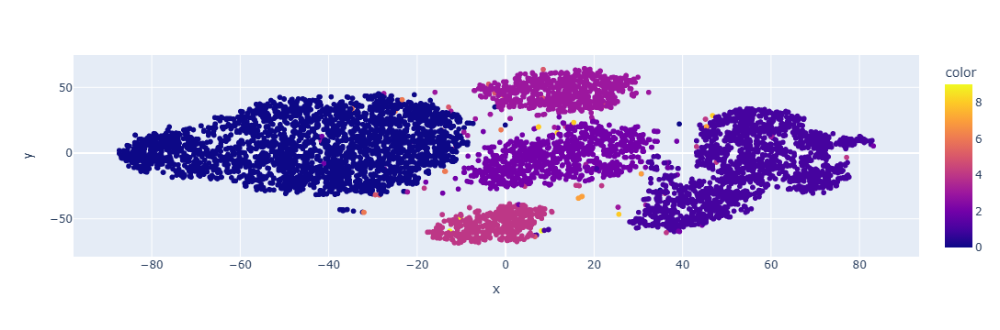

0
torch.Size([2000, 1, 28, 28])
class tensor(1)
torch.Size([2000, 20])
(1000, 20)
1000
(1000,)
(1000, 1, 28, 28)
(1000, 1, 28, 28)


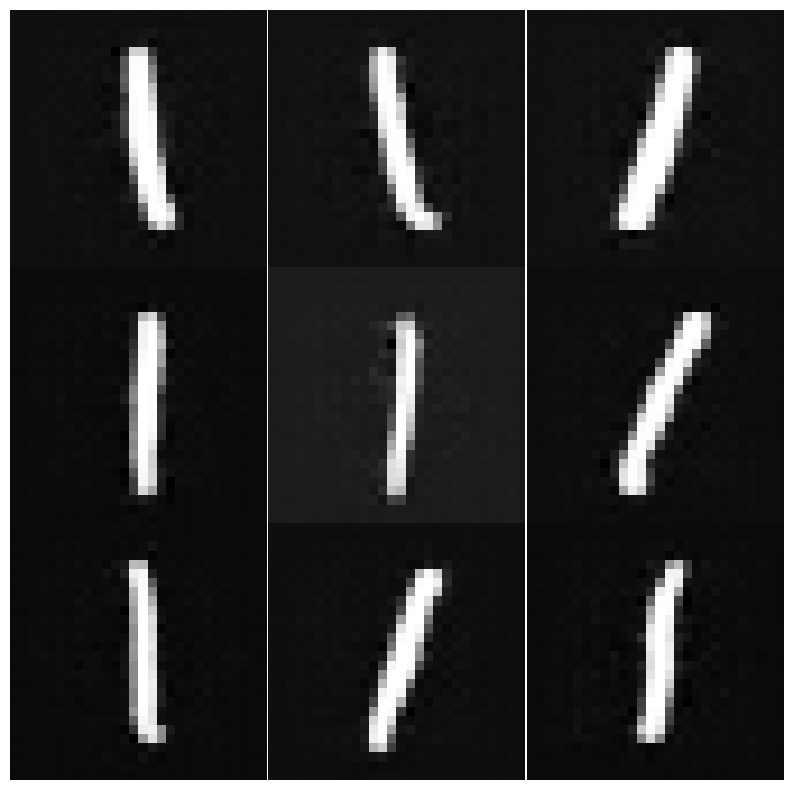

torch.Size([1000, 1, 28, 28])
class tensor(2)
torch.Size([1000, 20])
(2000, 20)
2000
(2000,)
(2000, 1, 28, 28)
(2000, 1, 28, 28)


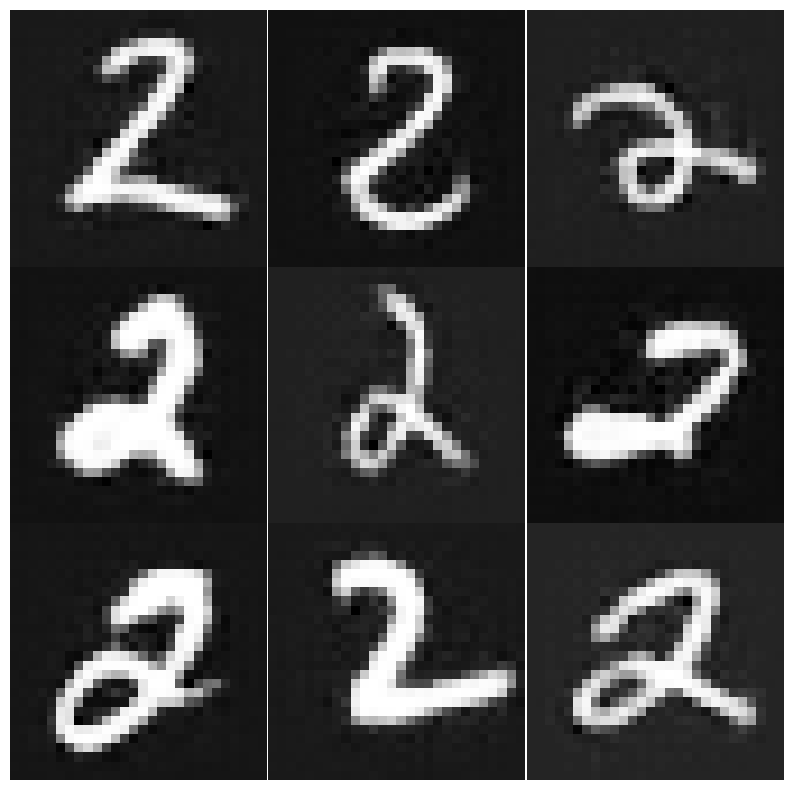

torch.Size([750, 1, 28, 28])
class tensor(3)
torch.Size([750, 20])
(2250, 20)
2250
(2250,)
(2250, 1, 28, 28)
(2250, 1, 28, 28)


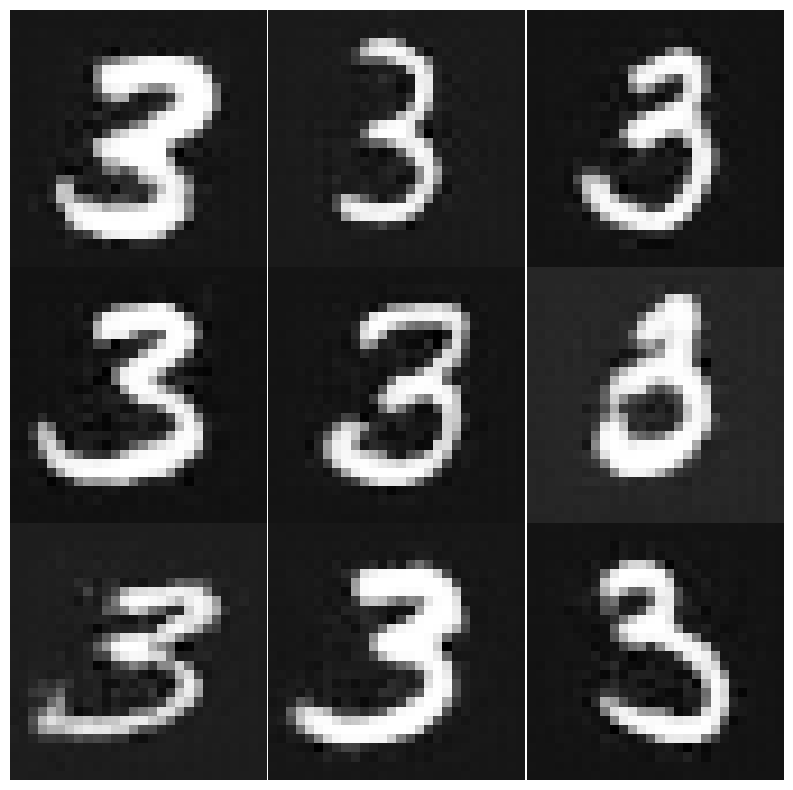

torch.Size([500, 1, 28, 28])
class tensor(4)
torch.Size([500, 20])
(2500, 20)
2500
(2500,)
(2500, 1, 28, 28)
(2500, 1, 28, 28)


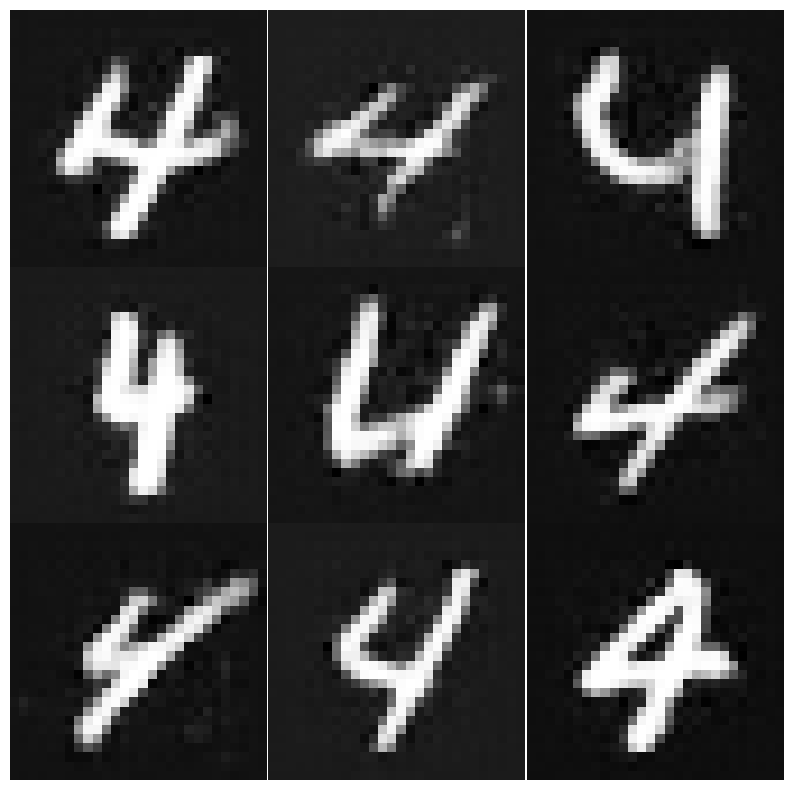

torch.Size([12, 1, 28, 28])
class tensor(5)
torch.Size([12, 20])
(2988, 20)
2988
(2988,)
(2988, 1, 28, 28)
(2988, 1, 28, 28)


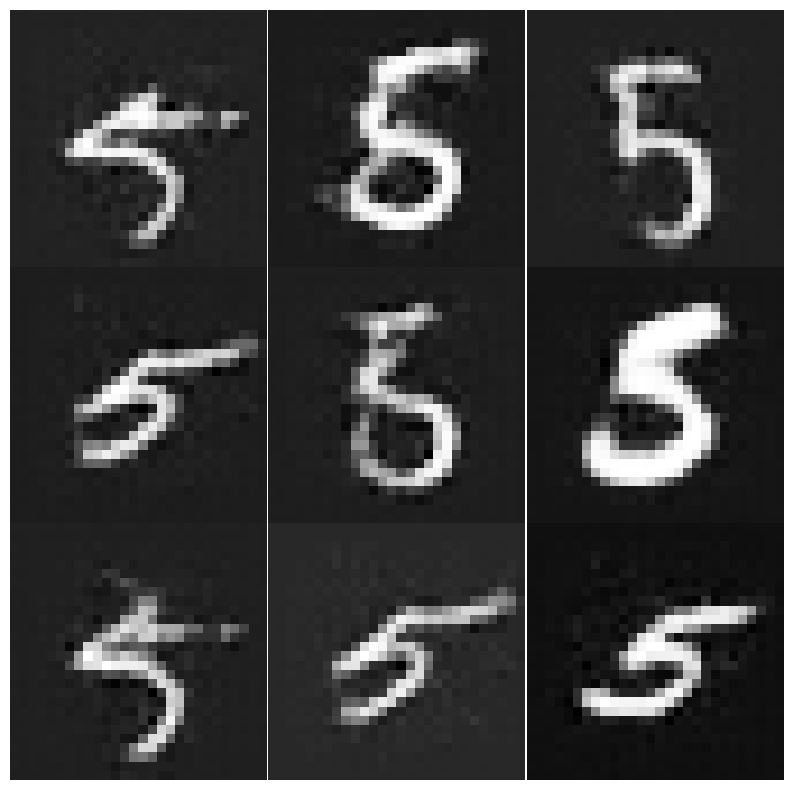

torch.Size([10, 1, 28, 28])
class tensor(6)
torch.Size([10, 20])
(2990, 20)
2990
(2990,)
(2990, 1, 28, 28)
(2990, 1, 28, 28)


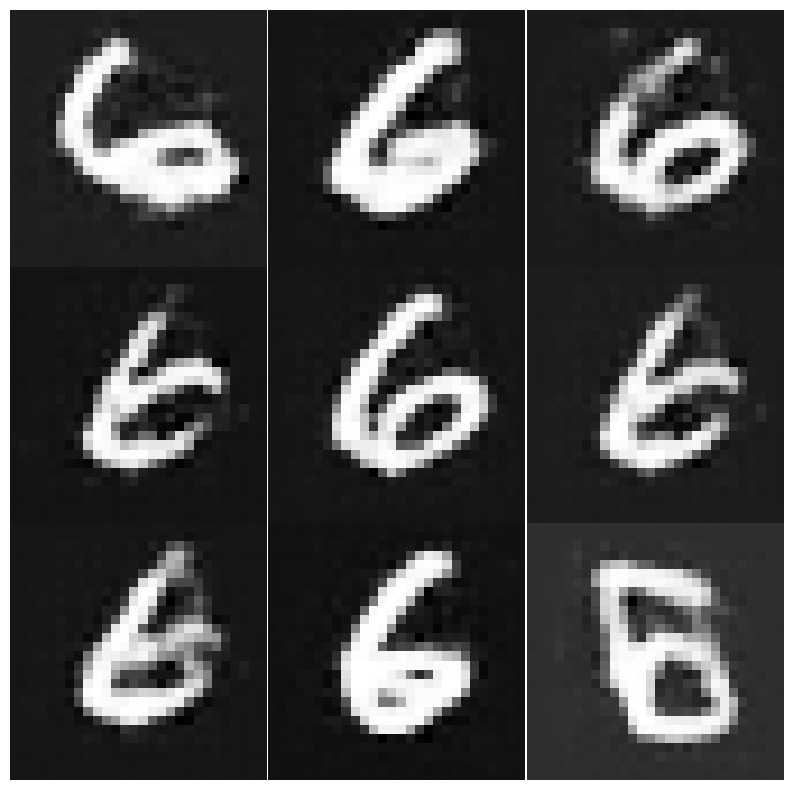

torch.Size([8, 1, 28, 28])
class tensor(7)
torch.Size([8, 20])
(2992, 20)
2992
(2992,)
(2992, 1, 28, 28)
(2992, 1, 28, 28)


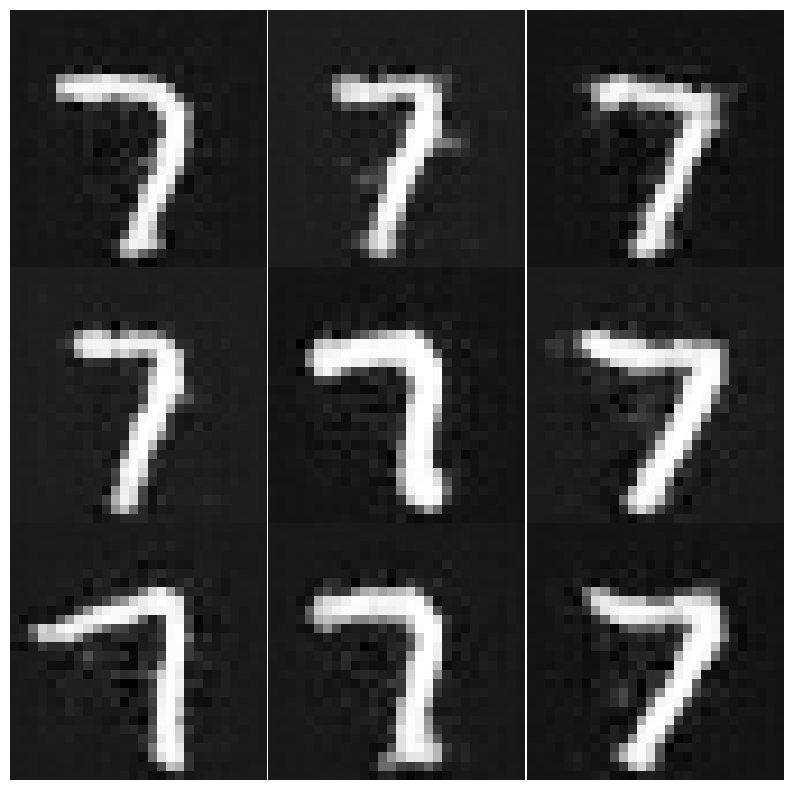

torch.Size([6, 1, 28, 28])
class tensor(8)
torch.Size([6, 20])
(2994, 20)
2994
(2994,)
(2994, 1, 28, 28)
(2994, 1, 28, 28)


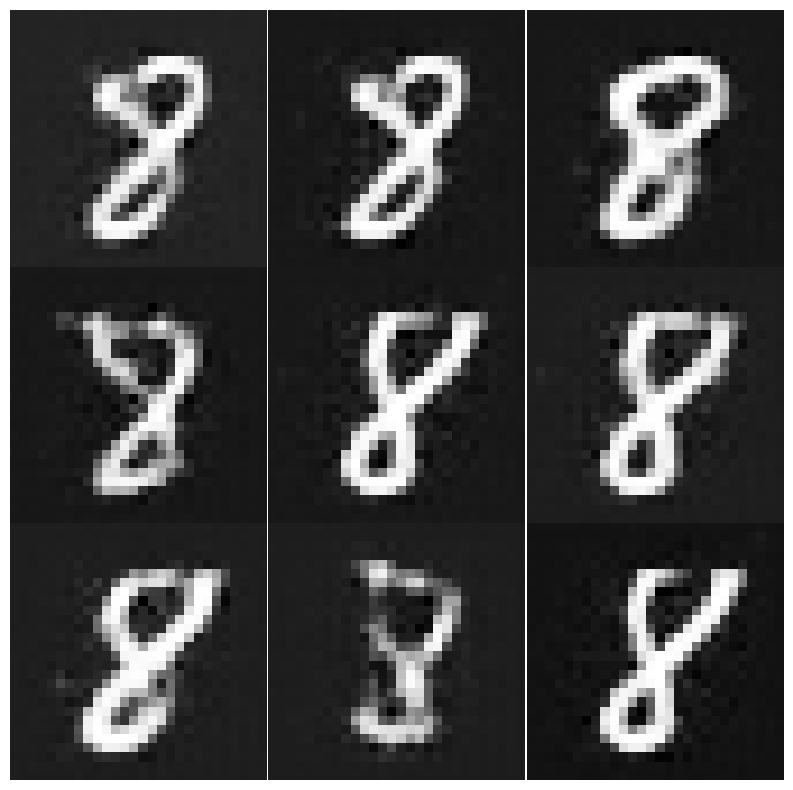

torch.Size([4, 1, 28, 28])
class tensor(9)
torch.Size([4, 20])
(2996, 20)
2996
(2996,)
(2996, 1, 28, 28)
(2996, 1, 28, 28)


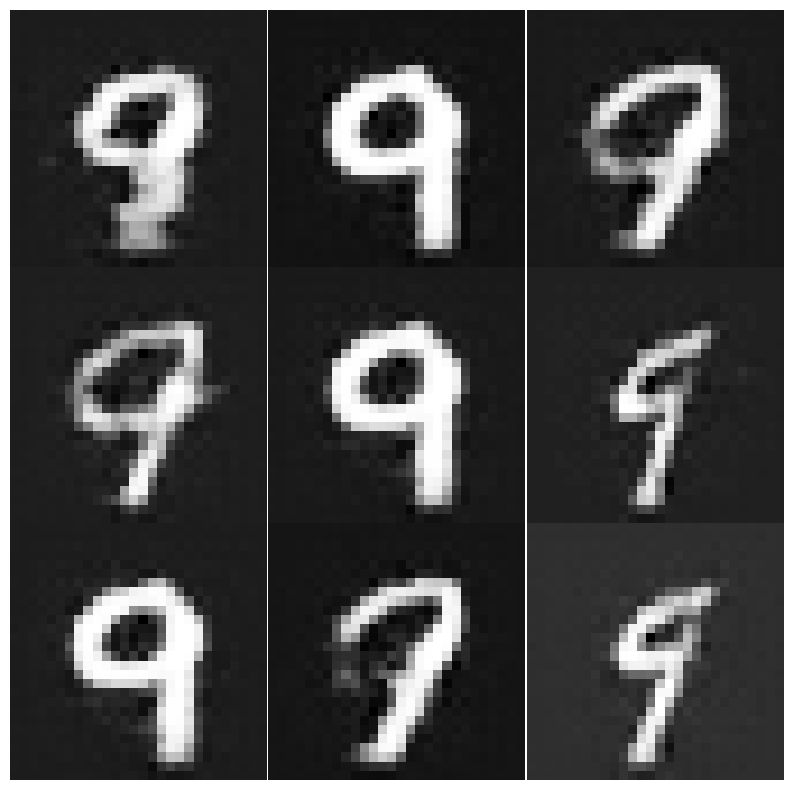

(22710, 1, 28, 28)
(22710,)
(22710, 784)
decx1  torch.Size([7290, 784])
(30000, 784)
(30000,)

final time(min): 0.89
#Dataset = 1


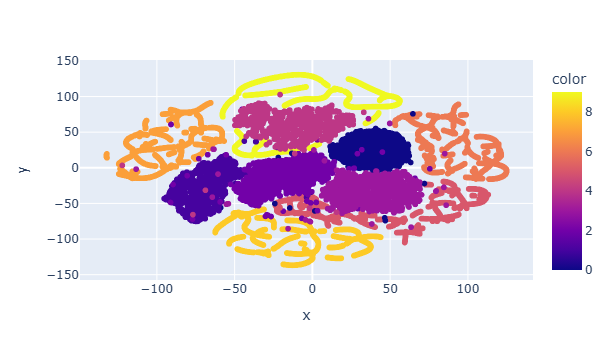

#Dataset = 1
(30000, 1, 28, 28)
(30000,)
Counter({1.0: 3000, 2.0: 3000, 3.0: 3000, 4.0: 3000, 5.0: 3000, 6.0: 3000, 7.0: 3000, 8.0: 3000, 9.0: 3000, 0.0: 3000})
train imgs after reshape  (30000, 1, 28, 28)
Train Epoch: 1 [1000/30000 (3%)]	Loss: 2.282320
Train Epoch: 1 [2000/30000 (7%)]	Loss: 2.230222
Train Epoch: 1 [3000/30000 (10%)]	Loss: 2.076710
Train Epoch: 1 [4000/30000 (13%)]	Loss: 1.721270
Train Epoch: 1 [5000/30000 (17%)]	Loss: 0.903612
Train Epoch: 1 [6000/30000 (20%)]	Loss: 0.522046
Train Epoch: 1 [7000/30000 (23%)]	Loss: 0.261711
Train Epoch: 1 [8000/30000 (27%)]	Loss: 0.265597
Train Epoch: 1 [9000/30000 (30%)]	Loss: 0.291686
Train Epoch: 1 [10000/30000 (33%)]	Loss: 0.295005
Train Epoch: 1 [11000/30000 (37%)]	Loss: 0.186019
Train Epoch: 1 [12000/30000 (40%)]	Loss: 0.129894
Train Epoch: 1 [13000/30000 (43%)]	Loss: 0.163351
Train Epoch: 1 [14000/30000 (47%)]	Loss: 0.192097
Train Epoch: 1 [15000/30000 (50%)]	Loss: 0.050099
Train Epoch: 1 [16000/30000 (53%)]	Loss: 0.190529
Train

Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 0 	Train Loss: 14.871677 	mse loss: 14.778683 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 1 	Train Loss: 4.722361 	mse loss: 4.635195 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 2 	Train Loss: 3.311214 	mse loss: 3.225459 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 3 	Train Loss: 2.750494 	mse loss: 2.666207 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 4 	Train Loss: 2.175049 	mse loss: 2.089341 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 5 	Train Loss: 1.980805 	mse loss: 1.897514 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 6 	Train Loss: 1.859244 	mse loss: 1.776467 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 7 	Train Loss: 1.609721 	mse loss: 1.528974 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.11s/it]


Epoch: 8 	Train Loss: 1.518150 	mse loss: 1.434802 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 9 	Train Loss: 1.421349 	mse loss: 1.337579 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 10 	Train Loss: 1.352682 	mse loss: 1.271612 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 11 	Train Loss: 1.283601 	mse loss: 1.201103 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 12 	Train Loss: 1.233096 	mse loss: 1.153195 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 13 	Train Loss: 1.221061 	mse loss: 1.144824 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 14 	Train Loss: 1.193993 	mse loss: 1.115617 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 15 	Train Loss: 1.130001 	mse loss: 1.052819 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 16 	Train Loss: 1.066662 	mse loss: 0.991052 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 17 	Train Loss: 1.068563 	mse loss: 0.993179 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 18 	Train Loss: 1.038794 	mse loss: 0.963518 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:19<00:00,  1.09s/it]


Epoch: 19 	Train Loss: 1.009705 	mse loss: 0.933867 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 20 	Train Loss: 1.005014 	mse loss: 0.929917 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 21 	Train Loss: 0.973631 	mse loss: 0.899952 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.11s/it]


Epoch: 22 	Train Loss: 0.967922 	mse loss: 0.891961 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 23 	Train Loss: 0.954891 	mse loss: 0.880928 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 24 	Train Loss: 0.939580 	mse loss: 0.860557 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 25 	Train Loss: 0.918275 	mse loss: 0.844573 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 26 	Train Loss: 0.900072 	mse loss: 0.829989 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 27 	Train Loss: 0.878497 	mse loss: 0.803486 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 28 	Train Loss: 0.870310 	mse loss: 0.795038 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 29 	Train Loss: 0.866415 	mse loss: 0.792185 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 30 	Train Loss: 0.849147 	mse loss: 0.777516 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 31 	Train Loss: 0.827169 	mse loss: 0.755555 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 32 	Train Loss: 0.836809 	mse loss: 0.764710 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 33 	Train Loss: 0.833508 	mse loss: 0.763361 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 34 	Train Loss: 0.825098 	mse loss: 0.752917 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 35 	Train Loss: 0.792823 	mse loss: 0.721386 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 36 	Train Loss: 0.781710 	mse loss: 0.708447 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.10s/it]


Epoch: 37 	Train Loss: 0.799255 	mse loss: 0.725358 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 38 	Train Loss: 0.778789 	mse loss: 0.707085 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 39 	Train Loss: 0.763054 	mse loss: 0.694346 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 40 	Train Loss: 0.761356 	mse loss: 0.690645 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 41 	Train Loss: 0.751874 	mse loss: 0.681692 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 42 	Train Loss: 0.744640 	mse loss: 0.672944 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 43 	Train Loss: 0.726558 	mse loss: 0.658403 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 44 	Train Loss: 0.726727 	mse loss: 0.656288 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 45 	Train Loss: 0.712107 	mse loss: 0.644241 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 46 	Train Loss: 0.720871 	mse loss: 0.652820 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 47 	Train Loss: 0.687734 	mse loss: 0.620236 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 48 	Train Loss: 0.717588 	mse loss: 0.646581 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 49 	Train Loss: 0.685384 	mse loss: 0.615129 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 50 	Train Loss: 0.678001 	mse loss: 0.608531 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 51 	Train Loss: 0.680355 	mse loss: 0.612292 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 52 	Train Loss: 0.672842 	mse loss: 0.599952 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:19<00:00,  1.09s/it]


Epoch: 53 	Train Loss: 0.678852 	mse loss: 0.606373 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 54 	Train Loss: 0.651150 	mse loss: 0.580119 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 55 	Train Loss: 0.669026 	mse loss: 0.598997 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 56 	Train Loss: 0.657889 	mse loss: 0.587910 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 57 	Train Loss: 0.654834 	mse loss: 0.584565 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 58 	Train Loss: 0.635440 	mse loss: 0.569320 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 59 	Train Loss: 0.619223 	mse loss: 0.547679 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 60 	Train Loss: 0.626535 	mse loss: 0.552814 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 61 	Train Loss: 0.620885 	mse loss: 0.547780 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 62 	Train Loss: 0.617091 	mse loss: 0.545076 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 63 	Train Loss: 0.619725 	mse loss: 0.550780 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 64 	Train Loss: 0.623960 	mse loss: 0.554525 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 65 	Train Loss: 0.602432 	mse loss: 0.534391 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.18s/it]


Epoch: 66 	Train Loss: 0.600279 	mse loss: 0.532109 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 67 	Train Loss: 0.597593 	mse loss: 0.528029 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 68 	Train Loss: 0.598281 	mse loss: 0.531111 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 69 	Train Loss: 0.578452 	mse loss: 0.509065 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 70 	Train Loss: 0.597833 	mse loss: 0.528212 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 71 	Train Loss: 0.581335 	mse loss: 0.513864 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 72 	Train Loss: 0.580298 	mse loss: 0.512832 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 73 	Train Loss: 0.584790 	mse loss: 0.517403 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 74 	Train Loss: 0.583235 	mse loss: 0.514433 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 75 	Train Loss: 0.553934 	mse loss: 0.485589 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 76 	Train Loss: 0.550646 	mse loss: 0.482139 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 77 	Train Loss: 0.543177 	mse loss: 0.475745 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.12s/it]


Epoch: 78 	Train Loss: 0.543185 	mse loss: 0.475563 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 79 	Train Loss: 0.545223 	mse loss: 0.477212 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 80 	Train Loss: 0.536444 	mse loss: 0.469775 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 81 	Train Loss: 0.550005 	mse loss: 0.482630 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 82 	Train Loss: 0.534828 	mse loss: 0.467121 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 83 	Train Loss: 0.533508 	mse loss: 0.465237 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 84 	Train Loss: 0.549627 	mse loss: 0.479402 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 85 	Train Loss: 0.530916 	mse loss: 0.458881 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 86 	Train Loss: 0.516252 	mse loss: 0.449349 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.11s/it]


Epoch: 87 	Train Loss: 0.513580 	mse loss: 0.447254 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 88 	Train Loss: 0.513063 	mse loss: 0.444410 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 89 	Train Loss: 0.516912 	mse loss: 0.448051 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.12s/it]


Epoch: 90 	Train Loss: 0.500223 	mse loss: 0.433786 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 91 	Train Loss: 0.500990 	mse loss: 0.432824 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 92 	Train Loss: 0.505380 	mse loss: 0.435702 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 93 	Train Loss: 0.506850 	mse loss: 0.438343 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 94 	Train Loss: 0.496791 	mse loss: 0.430061 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 95 	Train Loss: 0.533841 	mse loss: 0.463124 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 96 	Train Loss: 0.497406 	mse loss: 0.428957 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 97 	Train Loss: 0.478711 	mse loss: 0.409543 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.12s/it]


Epoch: 98 	Train Loss: 0.485031 	mse loss: 0.414421 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 99 	Train Loss: 0.481038 	mse loss: 0.414484 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 100 	Train Loss: 0.476922 	mse loss: 0.410541 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 101 	Train Loss: 0.473711 	mse loss: 0.407000 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 102 	Train Loss: 0.462205 	mse loss: 0.397044 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 103 	Train Loss: 0.458868 	mse loss: 0.393247 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 104 	Train Loss: 0.449677 	mse loss: 0.383542 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 105 	Train Loss: 0.468355 	mse loss: 0.401633 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.10s/it]


Epoch: 106 	Train Loss: 0.458291 	mse loss: 0.391707 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 107 	Train Loss: 0.467041 	mse loss: 0.398504 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.11s/it]


Epoch: 108 	Train Loss: 0.452660 	mse loss: 0.386481 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 109 	Train Loss: 0.448044 	mse loss: 0.381863 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 110 	Train Loss: 0.448650 	mse loss: 0.382351 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 111 	Train Loss: 0.444743 	mse loss: 0.377208 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 112 	Train Loss: 0.440039 	mse loss: 0.370931 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 113 	Train Loss: 0.457598 	mse loss: 0.390029 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 114 	Train Loss: 0.434888 	mse loss: 0.366730 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 115 	Train Loss: 0.437269 	mse loss: 0.370954 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 116 	Train Loss: 0.423367 	mse loss: 0.358513 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 117 	Train Loss: 0.432975 	mse loss: 0.367397 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 118 	Train Loss: 0.429373 	mse loss: 0.364212 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 119 	Train Loss: 0.432418 	mse loss: 0.365667 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 120 	Train Loss: 0.431780 	mse loss: 0.362301 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 121 	Train Loss: 0.422527 	mse loss: 0.354452 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 122 	Train Loss: 0.414251 	mse loss: 0.348683 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 123 	Train Loss: 0.415009 	mse loss: 0.348799 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 124 	Train Loss: 0.417636 	mse loss: 0.354049 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 125 	Train Loss: 0.420979 	mse loss: 0.355388 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 126 	Train Loss: 0.398124 	mse loss: 0.331303 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 127 	Train Loss: 0.405422 	mse loss: 0.339240 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 128 	Train Loss: 0.403274 	mse loss: 0.338003 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 129 	Train Loss: 0.412998 	mse loss: 0.343855 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 130 	Train Loss: 0.396931 	mse loss: 0.329786 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 131 	Train Loss: 0.407791 	mse loss: 0.340103 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 132 	Train Loss: 0.408332 	mse loss: 0.342423 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 133 	Train Loss: 0.392633 	mse loss: 0.327295 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 134 	Train Loss: 0.390984 	mse loss: 0.324471 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 135 	Train Loss: 0.384748 	mse loss: 0.316326 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 136 	Train Loss: 0.388472 	mse loss: 0.322476 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 137 	Train Loss: 0.381213 	mse loss: 0.316945 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 138 	Train Loss: 0.387692 	mse loss: 0.318714 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 139 	Train Loss: 0.387310 	mse loss: 0.320595 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 140 	Train Loss: 0.384188 	mse loss: 0.317320 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 141 	Train Loss: 0.381078 	mse loss: 0.314758 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 142 	Train Loss: 0.387228 	mse loss: 0.322606 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 143 	Train Loss: 0.373866 	mse loss: 0.308470 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 144 	Train Loss: 0.376526 	mse loss: 0.308409 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.11s/it]


Epoch: 145 	Train Loss: 0.372808 	mse loss: 0.303680 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 146 	Train Loss: 0.377841 	mse loss: 0.309034 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.11s/it]


Epoch: 147 	Train Loss: 0.363204 	mse loss: 0.298565 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 148 	Train Loss: 0.373192 	mse loss: 0.307170 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 149 	Train Loss: 0.360592 	mse loss: 0.295039 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 150 	Train Loss: 0.376808 	mse loss: 0.311373 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 151 	Train Loss: 0.365313 	mse loss: 0.300451 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 152 	Train Loss: 0.357869 	mse loss: 0.290348 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 153 	Train Loss: 0.352937 	mse loss: 0.285612 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 154 	Train Loss: 0.365586 	mse loss: 0.298024 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 155 	Train Loss: 0.355344 	mse loss: 0.288197 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 156 	Train Loss: 0.370034 	mse loss: 0.302938 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 157 	Train Loss: 0.358667 	mse loss: 0.292846 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 158 	Train Loss: 0.354601 	mse loss: 0.287225 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 159 	Train Loss: 0.363234 	mse loss: 0.298019 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 160 	Train Loss: 0.353215 	mse loss: 0.285157 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 161 	Train Loss: 0.348880 	mse loss: 0.283089 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 162 	Train Loss: 0.340946 	mse loss: 0.272624 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 163 	Train Loss: 0.339877 	mse loss: 0.274847 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 164 	Train Loss: 0.339150 	mse loss: 0.275960 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.12s/it]


Epoch: 165 	Train Loss: 0.341186 	mse loss: 0.273901 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 166 	Train Loss: 0.340378 	mse loss: 0.275037 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 167 	Train Loss: 0.335604 	mse loss: 0.268955 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 168 	Train Loss: 0.341453 	mse loss: 0.275200 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 169 	Train Loss: 0.336657 	mse loss: 0.271893 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 170 	Train Loss: 0.332908 	mse loss: 0.268097 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:00<00:00,  1.21it/s]


Epoch: 171 	Train Loss: 0.332500 	mse loss: 0.267092 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:15<00:00,  1.04s/it]


Epoch: 172 	Train Loss: 0.331582 	mse loss: 0.265900 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:08<00:00,  1.07it/s]


Epoch: 173 	Train Loss: 0.323251 	mse loss: 0.258610 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:00<00:00,  1.21it/s]


Epoch: 174 	Train Loss: 0.327648 	mse loss: 0.262295 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:00<00:00,  1.21it/s]


Epoch: 175 	Train Loss: 0.330444 	mse loss: 0.266775 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:00<00:00,  1.21it/s]


Epoch: 176 	Train Loss: 0.325613 	mse loss: 0.260087 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:00<00:00,  1.22it/s]


Epoch: 177 	Train Loss: 0.328277 	mse loss: 0.261707 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:00<00:00,  1.20it/s]


Epoch: 178 	Train Loss: 0.330582 	mse loss: 0.263602 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:19<00:00,  1.09s/it]


Epoch: 179 	Train Loss: 0.325094 	mse loss: 0.260084 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 180 	Train Loss: 0.327252 	mse loss: 0.262894 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 181 	Train Loss: 0.326903 	mse loss: 0.261847 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 182 	Train Loss: 0.314881 	mse loss: 0.249525 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.12s/it]


Epoch: 183 	Train Loss: 0.322457 	mse loss: 0.256661 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 184 	Train Loss: 0.322327 	mse loss: 0.257537 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 185 	Train Loss: 0.320757 	mse loss: 0.255499 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 186 	Train Loss: 0.316612 	mse loss: 0.249924 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 187 	Train Loss: 0.321089 	mse loss: 0.253761 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 188 	Train Loss: 0.321037 	mse loss: 0.253347 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 189 	Train Loss: 0.311778 	mse loss: 0.248119 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 190 	Train Loss: 0.306981 	mse loss: 0.242732 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.11s/it]


Epoch: 191 	Train Loss: 0.314033 	mse loss: 0.246739 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 192 	Train Loss: 0.323917 	mse loss: 0.256155 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 193 	Train Loss: 0.307505 	mse loss: 0.242238 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 194 	Train Loss: 0.310976 	mse loss: 0.245273 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 195 	Train Loss: 0.303565 	mse loss: 0.238939 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 196 	Train Loss: 0.303028 	mse loss: 0.237617 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 197 	Train Loss: 0.304786 	mse loss: 0.237714 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 198 	Train Loss: 0.320642 	mse loss: 0.255729 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 199 	Train Loss: 0.298498 	mse loss: 0.230906 	mse2 loss: 0.000000
C:/Users/admin/Desktop/Suvaporn_Lab/DeepSMOTE/CLDeepSMOTE/model/enc.pth
C:/Users/admin/Desktop/Suvaporn_Lab/DeepSMOTE/CLDeepSMOTE/model/dec.pth

total time(min): 273.93


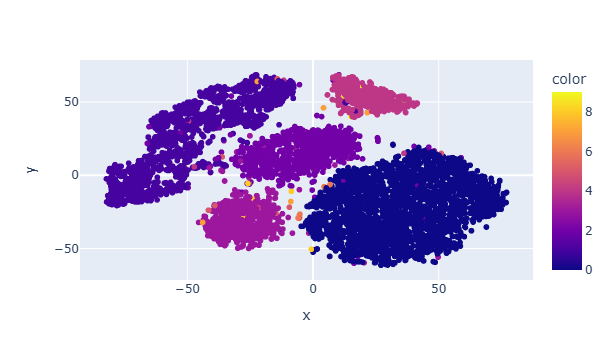

0
torch.Size([2000, 1, 28, 28])
class tensor(1)
torch.Size([2000, 20])
(1000, 20)
1000
(1000,)
(1000, 1, 28, 28)
(1000, 1, 28, 28)


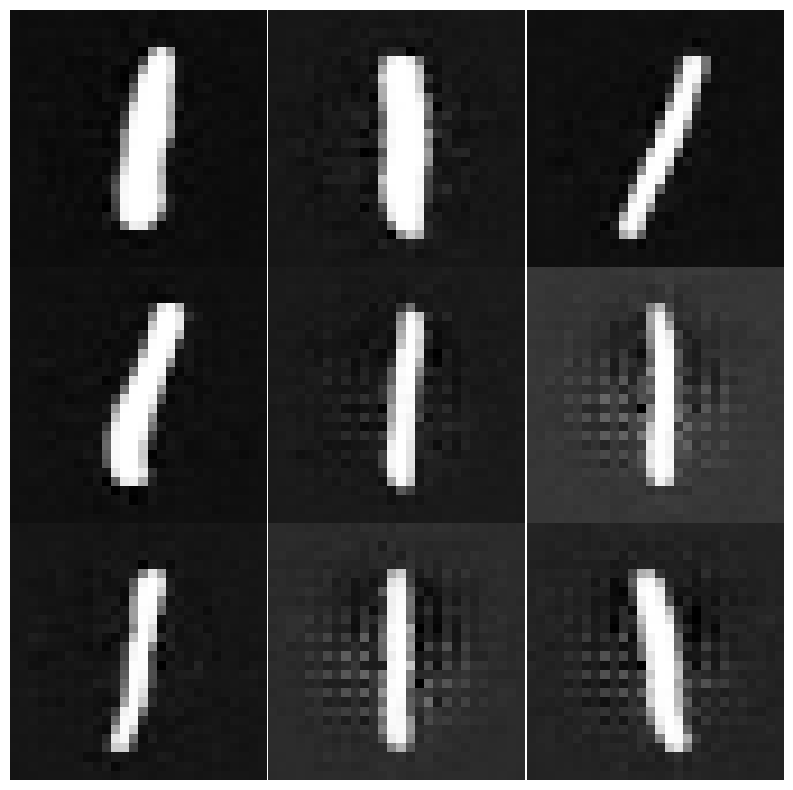

torch.Size([1000, 1, 28, 28])
class tensor(2)
torch.Size([1000, 20])
(2000, 20)
2000
(2000,)
(2000, 1, 28, 28)
(2000, 1, 28, 28)


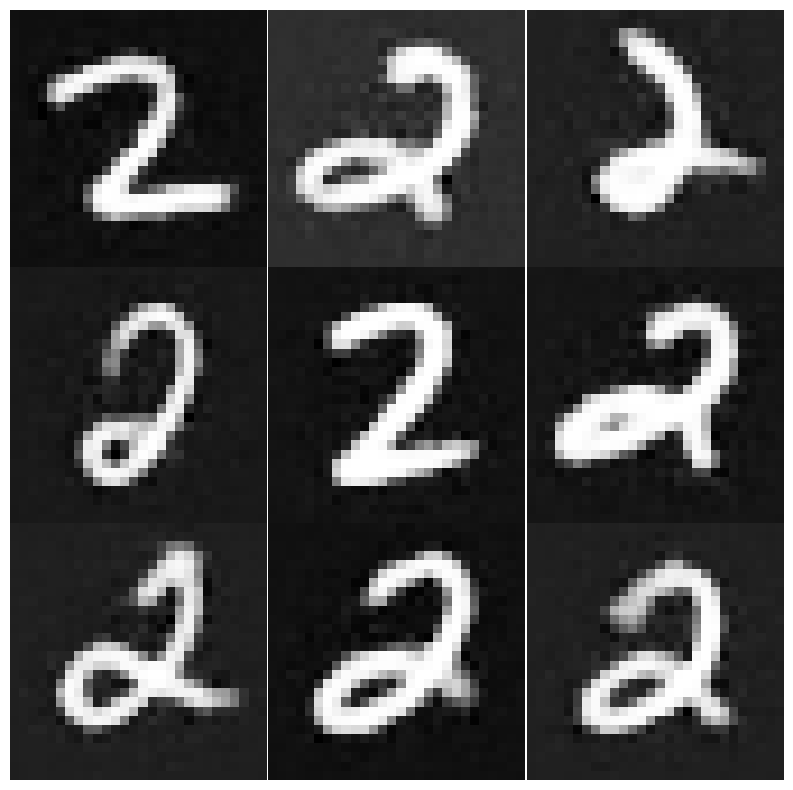

torch.Size([750, 1, 28, 28])
class tensor(3)
torch.Size([750, 20])
(2250, 20)
2250
(2250,)
(2250, 1, 28, 28)
(2250, 1, 28, 28)


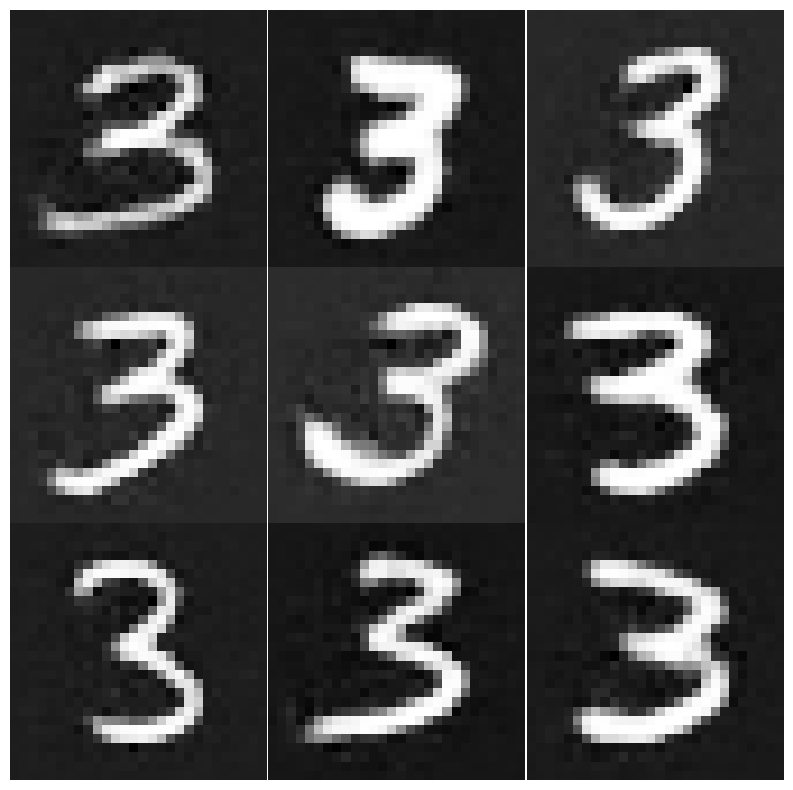

torch.Size([500, 1, 28, 28])
class tensor(4)
torch.Size([500, 20])
(2500, 20)
2500
(2500,)
(2500, 1, 28, 28)
(2500, 1, 28, 28)


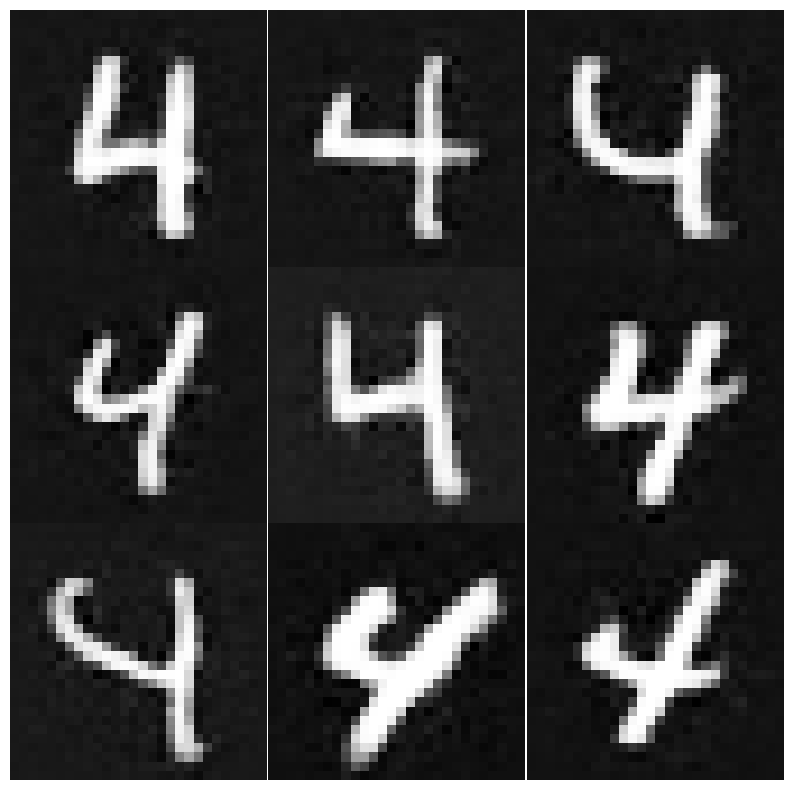

torch.Size([12, 1, 28, 28])
class tensor(5)
torch.Size([12, 20])
(2988, 20)
2988
(2988,)
(2988, 1, 28, 28)
(2988, 1, 28, 28)


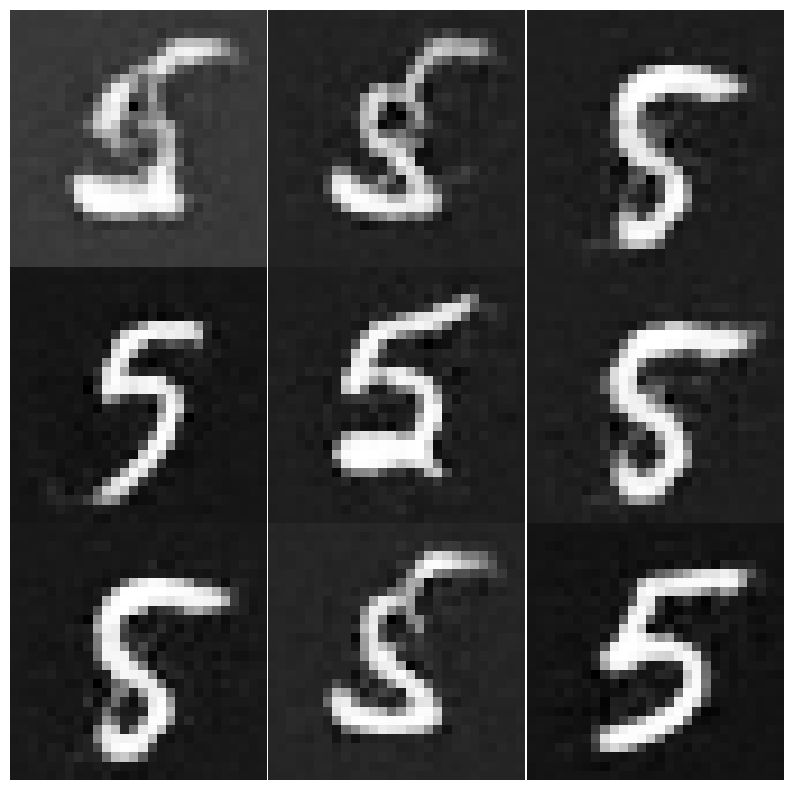

torch.Size([10, 1, 28, 28])
class tensor(6)
torch.Size([10, 20])
(2990, 20)
2990
(2990,)
(2990, 1, 28, 28)
(2990, 1, 28, 28)


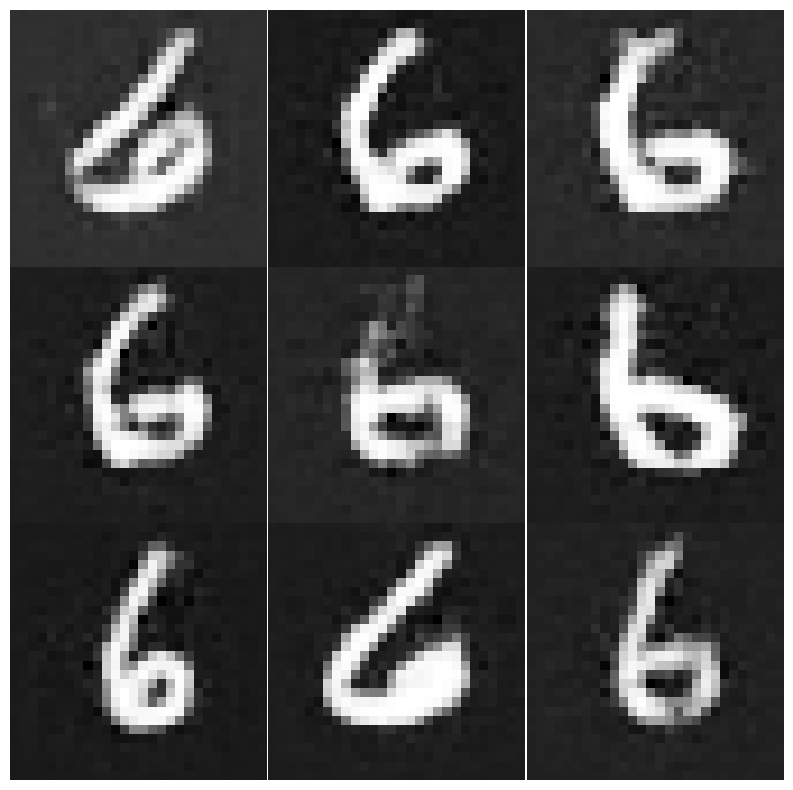

torch.Size([8, 1, 28, 28])
class tensor(7)
torch.Size([8, 20])
(2992, 20)
2992
(2992,)
(2992, 1, 28, 28)
(2992, 1, 28, 28)


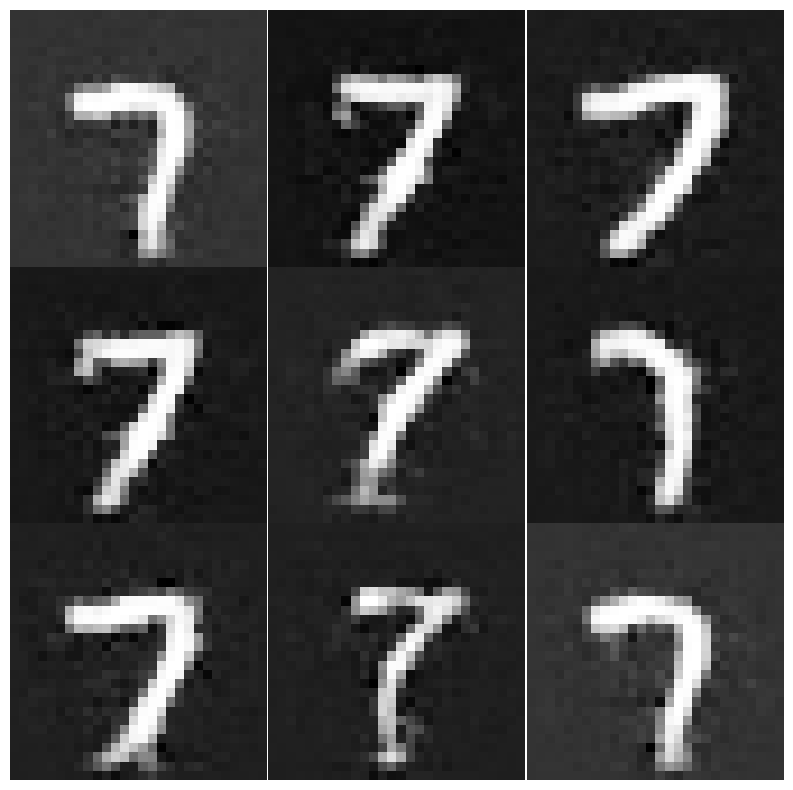

torch.Size([6, 1, 28, 28])
class tensor(8)
torch.Size([6, 20])
(2994, 20)
2994
(2994,)
(2994, 1, 28, 28)
(2994, 1, 28, 28)


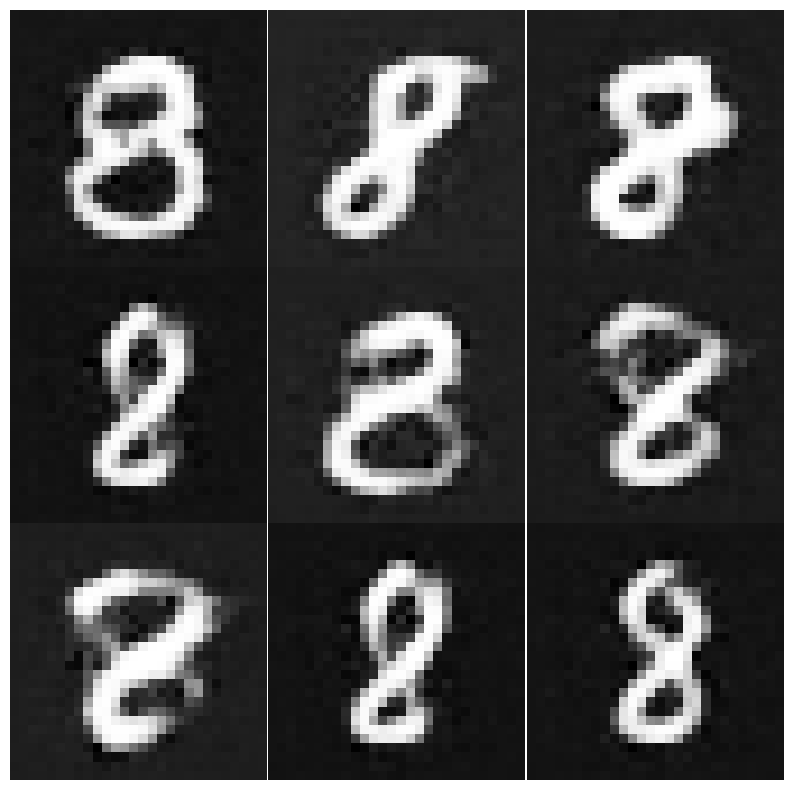

torch.Size([4, 1, 28, 28])
class tensor(9)
torch.Size([4, 20])
(2996, 20)
2996
(2996,)
(2996, 1, 28, 28)
(2996, 1, 28, 28)


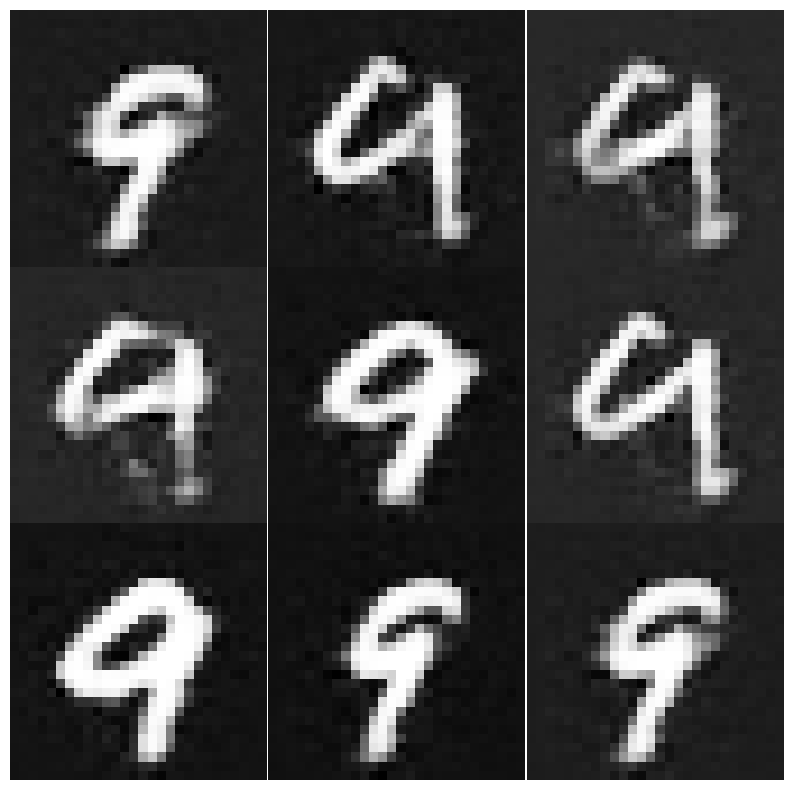

(22710, 1, 28, 28)
(22710,)
(22710, 784)
decx1  torch.Size([7290, 784])
(30000, 784)
(30000,)

final time(min): 1.10
#Dataset = 1


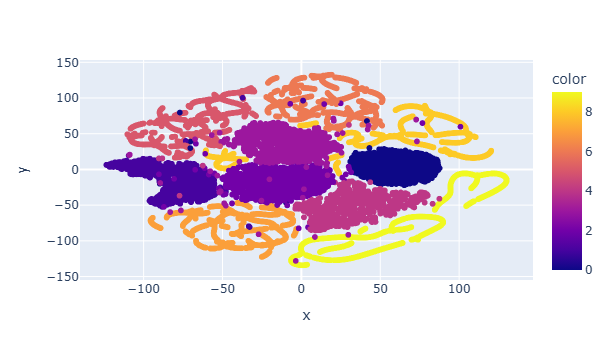

#Dataset = 1
(30000, 1, 28, 28)
(30000,)
Counter({1.0: 3000, 2.0: 3000, 3.0: 3000, 4.0: 3000, 5.0: 3000, 6.0: 3000, 7.0: 3000, 8.0: 3000, 9.0: 3000, 0.0: 3000})
train imgs after reshape  (30000, 1, 28, 28)
Train Epoch: 1 [1000/30000 (3%)]	Loss: 2.286166
Train Epoch: 1 [2000/30000 (7%)]	Loss: 2.261703
Train Epoch: 1 [3000/30000 (10%)]	Loss: 2.207752
Train Epoch: 1 [4000/30000 (13%)]	Loss: 2.107153
Train Epoch: 1 [5000/30000 (17%)]	Loss: 1.787162
Train Epoch: 1 [6000/30000 (20%)]	Loss: 1.058635
Train Epoch: 1 [7000/30000 (23%)]	Loss: 0.496248
Train Epoch: 1 [8000/30000 (27%)]	Loss: 0.463077
Train Epoch: 1 [9000/30000 (30%)]	Loss: 0.124576
Train Epoch: 1 [10000/30000 (33%)]	Loss: 0.285338
Train Epoch: 1 [11000/30000 (37%)]	Loss: 0.224303
Train Epoch: 1 [12000/30000 (40%)]	Loss: 0.149708
Train Epoch: 1 [13000/30000 (43%)]	Loss: 0.207279
Train Epoch: 1 [14000/30000 (47%)]	Loss: 0.103142
Train Epoch: 1 [15000/30000 (50%)]	Loss: 0.125298
Train Epoch: 1 [16000/30000 (53%)]	Loss: 0.225180
Train

Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 0 	Train Loss: 15.277317 	mse loss: 15.174263 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 1 	Train Loss: 4.914626 	mse loss: 4.814030 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 2 	Train Loss: 3.529116 	mse loss: 3.432103 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 3 	Train Loss: 2.777958 	mse loss: 2.677752 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.18s/it]


Epoch: 4 	Train Loss: 2.436827 	mse loss: 2.339986 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 5 	Train Loss: 2.241573 	mse loss: 2.144750 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 6 	Train Loss: 1.905485 	mse loss: 1.809455 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 7 	Train Loss: 1.780407 	mse loss: 1.691839 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 8 	Train Loss: 1.645257 	mse loss: 1.555985 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 9 	Train Loss: 1.591409 	mse loss: 1.501456 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 10 	Train Loss: 1.453757 	mse loss: 1.362861 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.10s/it]


Epoch: 11 	Train Loss: 1.378115 	mse loss: 1.292886 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 12 	Train Loss: 1.342294 	mse loss: 1.261144 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 13 	Train Loss: 1.266766 	mse loss: 1.186645 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 14 	Train Loss: 1.213210 	mse loss: 1.131818 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 15 	Train Loss: 1.193881 	mse loss: 1.108908 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 16 	Train Loss: 1.164817 	mse loss: 1.084523 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 17 	Train Loss: 1.168170 	mse loss: 1.088013 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 18 	Train Loss: 1.094962 	mse loss: 1.020014 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 19 	Train Loss: 1.066159 	mse loss: 0.988873 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 20 	Train Loss: 1.059893 	mse loss: 0.984012 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 21 	Train Loss: 1.054206 	mse loss: 0.979491 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 22 	Train Loss: 0.999443 	mse loss: 0.925771 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 23 	Train Loss: 0.992746 	mse loss: 0.920220 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 24 	Train Loss: 0.958203 	mse loss: 0.883234 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 25 	Train Loss: 0.953311 	mse loss: 0.882170 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 26 	Train Loss: 0.941380 	mse loss: 0.866942 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 27 	Train Loss: 0.955411 	mse loss: 0.881982 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 28 	Train Loss: 0.915765 	mse loss: 0.842148 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.11s/it]


Epoch: 29 	Train Loss: 0.910619 	mse loss: 0.835252 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 30 	Train Loss: 0.892719 	mse loss: 0.819486 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.11s/it]


Epoch: 31 	Train Loss: 0.887961 	mse loss: 0.817653 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 32 	Train Loss: 0.875127 	mse loss: 0.804242 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 33 	Train Loss: 0.847538 	mse loss: 0.779109 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 34 	Train Loss: 0.830707 	mse loss: 0.761426 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 35 	Train Loss: 0.820980 	mse loss: 0.752115 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 36 	Train Loss: 0.810579 	mse loss: 0.739241 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 37 	Train Loss: 0.821558 	mse loss: 0.753759 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 38 	Train Loss: 0.791607 	mse loss: 0.722839 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 39 	Train Loss: 0.757660 	mse loss: 0.689070 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.10s/it]


Epoch: 40 	Train Loss: 0.809466 	mse loss: 0.737896 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 41 	Train Loss: 0.837021 	mse loss: 0.766582 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 42 	Train Loss: 0.752510 	mse loss: 0.682908 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 43 	Train Loss: 0.764645 	mse loss: 0.695432 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 44 	Train Loss: 0.723471 	mse loss: 0.658206 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 45 	Train Loss: 0.728293 	mse loss: 0.659813 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 46 	Train Loss: 0.715664 	mse loss: 0.648986 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 47 	Train Loss: 0.742065 	mse loss: 0.674085 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.11s/it]


Epoch: 48 	Train Loss: 0.736469 	mse loss: 0.666212 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.10s/it]


Epoch: 49 	Train Loss: 0.697826 	mse loss: 0.627066 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 50 	Train Loss: 0.698779 	mse loss: 0.631917 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 51 	Train Loss: 0.697337 	mse loss: 0.629361 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 52 	Train Loss: 0.691875 	mse loss: 0.625186 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 53 	Train Loss: 0.678186 	mse loss: 0.612648 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 54 	Train Loss: 0.655389 	mse loss: 0.589151 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 55 	Train Loss: 0.656435 	mse loss: 0.589707 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 56 	Train Loss: 0.666963 	mse loss: 0.600871 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 57 	Train Loss: 0.648777 	mse loss: 0.584341 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 58 	Train Loss: 0.640826 	mse loss: 0.577240 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 59 	Train Loss: 0.634543 	mse loss: 0.567319 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 60 	Train Loss: 0.639490 	mse loss: 0.575187 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 61 	Train Loss: 0.616635 	mse loss: 0.550251 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 62 	Train Loss: 0.643049 	mse loss: 0.578675 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 63 	Train Loss: 0.623248 	mse loss: 0.557171 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 64 	Train Loss: 0.609942 	mse loss: 0.544071 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 65 	Train Loss: 0.607079 	mse loss: 0.544700 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 66 	Train Loss: 0.598449 	mse loss: 0.534364 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 67 	Train Loss: 0.603917 	mse loss: 0.541259 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 68 	Train Loss: 0.586317 	mse loss: 0.523983 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 69 	Train Loss: 0.583315 	mse loss: 0.518545 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 70 	Train Loss: 0.579953 	mse loss: 0.514187 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 71 	Train Loss: 0.574099 	mse loss: 0.510512 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 72 	Train Loss: 0.567743 	mse loss: 0.504716 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 73 	Train Loss: 0.572251 	mse loss: 0.509600 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 74 	Train Loss: 0.549305 	mse loss: 0.487398 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 75 	Train Loss: 0.555143 	mse loss: 0.491552 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 76 	Train Loss: 0.538128 	mse loss: 0.475142 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 77 	Train Loss: 0.552844 	mse loss: 0.488050 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 78 	Train Loss: 0.546956 	mse loss: 0.480980 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 79 	Train Loss: 0.537437 	mse loss: 0.475194 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 80 	Train Loss: 0.523860 	mse loss: 0.459818 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 81 	Train Loss: 0.523108 	mse loss: 0.458944 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 82 	Train Loss: 0.523781 	mse loss: 0.460939 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 83 	Train Loss: 0.516603 	mse loss: 0.455761 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 84 	Train Loss: 0.522130 	mse loss: 0.460129 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 85 	Train Loss: 0.521765 	mse loss: 0.457978 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 86 	Train Loss: 0.523245 	mse loss: 0.461851 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 87 	Train Loss: 0.509871 	mse loss: 0.447152 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 88 	Train Loss: 0.504857 	mse loss: 0.443710 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 89 	Train Loss: 0.493052 	mse loss: 0.433417 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 90 	Train Loss: 0.510249 	mse loss: 0.448868 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 91 	Train Loss: 0.492204 	mse loss: 0.430861 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 92 	Train Loss: 0.479296 	mse loss: 0.418586 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 93 	Train Loss: 0.474033 	mse loss: 0.413525 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 94 	Train Loss: 0.473721 	mse loss: 0.413227 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 95 	Train Loss: 0.499593 	mse loss: 0.437358 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 96 	Train Loss: 0.544932 	mse loss: 0.483534 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:26<00:00,  1.18s/it]


Epoch: 97 	Train Loss: 0.562451 	mse loss: 0.499926 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 98 	Train Loss: 0.498068 	mse loss: 0.438386 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 99 	Train Loss: 0.470136 	mse loss: 0.408905 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 100 	Train Loss: 0.464048 	mse loss: 0.401171 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 101 	Train Loss: 0.463003 	mse loss: 0.401357 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 102 	Train Loss: 0.463773 	mse loss: 0.402026 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 103 	Train Loss: 0.472368 	mse loss: 0.413064 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 104 	Train Loss: 0.461369 	mse loss: 0.401556 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 105 	Train Loss: 0.446700 	mse loss: 0.387308 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:26<00:00,  1.19s/it]


Epoch: 106 	Train Loss: 0.454044 	mse loss: 0.395610 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.18s/it]


Epoch: 107 	Train Loss: 0.450377 	mse loss: 0.389093 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.21s/it]


Epoch: 108 	Train Loss: 0.432898 	mse loss: 0.373494 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 109 	Train Loss: 0.440291 	mse loss: 0.378476 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 110 	Train Loss: 0.425018 	mse loss: 0.365554 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 111 	Train Loss: 0.446143 	mse loss: 0.384661 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 112 	Train Loss: 0.425302 	mse loss: 0.364066 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 113 	Train Loss: 0.414455 	mse loss: 0.352646 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 114 	Train Loss: 0.415888 	mse loss: 0.356451 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 115 	Train Loss: 0.415947 	mse loss: 0.358512 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 116 	Train Loss: 0.422775 	mse loss: 0.363472 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 117 	Train Loss: 0.416329 	mse loss: 0.356897 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 118 	Train Loss: 0.408985 	mse loss: 0.348829 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 119 	Train Loss: 0.415672 	mse loss: 0.356568 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 120 	Train Loss: 0.412431 	mse loss: 0.354133 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 121 	Train Loss: 0.399562 	mse loss: 0.340056 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 122 	Train Loss: 0.407876 	mse loss: 0.349024 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 123 	Train Loss: 0.399502 	mse loss: 0.341219 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 124 	Train Loss: 0.398890 	mse loss: 0.340436 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 125 	Train Loss: 0.409745 	mse loss: 0.351303 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.10s/it]


Epoch: 126 	Train Loss: 0.393514 	mse loss: 0.335716 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 127 	Train Loss: 0.403512 	mse loss: 0.343857 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:26<00:00,  1.19s/it]


Epoch: 128 	Train Loss: 0.401477 	mse loss: 0.342609 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.23s/it]


Epoch: 129 	Train Loss: 0.393920 	mse loss: 0.334643 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 130 	Train Loss: 0.380757 	mse loss: 0.324276 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 131 	Train Loss: 0.385231 	mse loss: 0.326089 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 132 	Train Loss: 0.379993 	mse loss: 0.319273 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 133 	Train Loss: 0.379157 	mse loss: 0.320109 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.12s/it]


Epoch: 134 	Train Loss: 0.384088 	mse loss: 0.325947 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 135 	Train Loss: 0.376868 	mse loss: 0.317324 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 136 	Train Loss: 0.385707 	mse loss: 0.327808 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 137 	Train Loss: 0.364147 	mse loss: 0.307266 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 138 	Train Loss: 0.379081 	mse loss: 0.320071 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 139 	Train Loss: 0.388640 	mse loss: 0.329465 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 140 	Train Loss: 0.360747 	mse loss: 0.303961 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 141 	Train Loss: 0.354522 	mse loss: 0.295551 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 142 	Train Loss: 0.359237 	mse loss: 0.303021 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 143 	Train Loss: 0.356581 	mse loss: 0.299457 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 144 	Train Loss: 0.361216 	mse loss: 0.303167 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 145 	Train Loss: 0.376732 	mse loss: 0.318815 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 146 	Train Loss: 0.358502 	mse loss: 0.300654 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 147 	Train Loss: 0.353851 	mse loss: 0.297209 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 148 	Train Loss: 0.352502 	mse loss: 0.296117 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 149 	Train Loss: 0.353752 	mse loss: 0.291400 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 150 	Train Loss: 0.358243 	mse loss: 0.301074 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 151 	Train Loss: 0.353827 	mse loss: 0.296190 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 152 	Train Loss: 0.351258 	mse loss: 0.290946 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 153 	Train Loss: 0.343963 	mse loss: 0.285058 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.10s/it]


Epoch: 154 	Train Loss: 0.353821 	mse loss: 0.293935 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 155 	Train Loss: 0.343506 	mse loss: 0.284957 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 156 	Train Loss: 0.339165 	mse loss: 0.283469 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 157 	Train Loss: 0.340633 	mse loss: 0.281566 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 158 	Train Loss: 0.343894 	mse loss: 0.284120 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 159 	Train Loss: 0.339284 	mse loss: 0.279893 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 160 	Train Loss: 0.337737 	mse loss: 0.282256 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 161 	Train Loss: 0.352511 	mse loss: 0.292055 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.10s/it]


Epoch: 162 	Train Loss: 0.328779 	mse loss: 0.271181 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 163 	Train Loss: 0.330889 	mse loss: 0.275568 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 164 	Train Loss: 0.332506 	mse loss: 0.277185 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 165 	Train Loss: 0.330345 	mse loss: 0.272973 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 166 	Train Loss: 0.336531 	mse loss: 0.277169 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 167 	Train Loss: 0.328171 	mse loss: 0.267655 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 168 	Train Loss: 0.318651 	mse loss: 0.261759 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 169 	Train Loss: 0.331673 	mse loss: 0.274842 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:04<00:00,  1.13it/s]


Epoch: 170 	Train Loss: 0.316153 	mse loss: 0.260848 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:12<00:00,  1.01it/s]


Epoch: 171 	Train Loss: 0.316984 	mse loss: 0.261579 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:10<00:00,  1.03it/s]


Epoch: 172 	Train Loss: 0.320502 	mse loss: 0.259595 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [00:59<00:00,  1.22it/s]


Epoch: 173 	Train Loss: 0.318701 	mse loss: 0.259939 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:00<00:00,  1.21it/s]


Epoch: 174 	Train Loss: 0.319918 	mse loss: 0.265676 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:00<00:00,  1.21it/s]


Epoch: 175 	Train Loss: 0.319159 	mse loss: 0.263249 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:00<00:00,  1.21it/s]


Epoch: 176 	Train Loss: 0.319323 	mse loss: 0.262795 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [00:59<00:00,  1.22it/s]


Epoch: 177 	Train Loss: 0.312177 	mse loss: 0.255772 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:15<00:00,  1.03s/it]


Epoch: 178 	Train Loss: 0.315145 	mse loss: 0.256580 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 179 	Train Loss: 0.321246 	mse loss: 0.262177 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 180 	Train Loss: 0.305830 	mse loss: 0.247611 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 181 	Train Loss: 0.321958 	mse loss: 0.265251 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 182 	Train Loss: 0.300279 	mse loss: 0.244361 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 183 	Train Loss: 0.308137 	mse loss: 0.251798 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 184 	Train Loss: 0.298806 	mse loss: 0.242577 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 185 	Train Loss: 0.310657 	mse loss: 0.252294 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 186 	Train Loss: 0.309722 	mse loss: 0.255192 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 187 	Train Loss: 0.306936 	mse loss: 0.250769 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 188 	Train Loss: 0.295017 	mse loss: 0.239416 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 189 	Train Loss: 0.292711 	mse loss: 0.235746 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 190 	Train Loss: 0.292231 	mse loss: 0.238393 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 191 	Train Loss: 0.298175 	mse loss: 0.241861 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 192 	Train Loss: 0.295085 	mse loss: 0.238496 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 193 	Train Loss: 0.290711 	mse loss: 0.236021 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 194 	Train Loss: 0.295503 	mse loss: 0.238167 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 195 	Train Loss: 0.286415 	mse loss: 0.230198 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.12s/it]


Epoch: 196 	Train Loss: 0.287394 	mse loss: 0.229991 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 197 	Train Loss: 0.294645 	mse loss: 0.237508 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 198 	Train Loss: 0.292567 	mse loss: 0.236938 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 199 	Train Loss: 0.289287 	mse loss: 0.234517 	mse2 loss: 0.000000
C:/Users/admin/Desktop/Suvaporn_Lab/DeepSMOTE/CLDeepSMOTE/model/enc.pth
C:/Users/admin/Desktop/Suvaporn_Lab/DeepSMOTE/CLDeepSMOTE/model/dec.pth

total time(min): 274.97


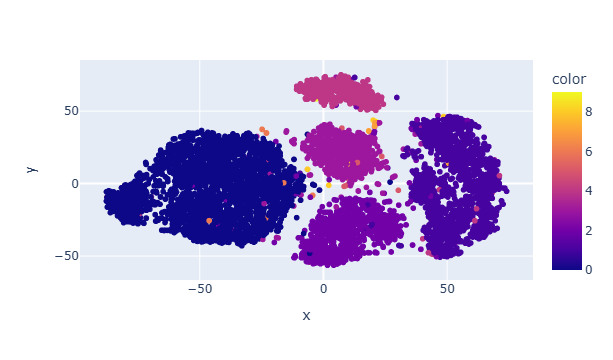

0
torch.Size([2000, 1, 28, 28])
class tensor(1)
torch.Size([2000, 20])
(1000, 20)
1000
(1000,)
(1000, 1, 28, 28)
(1000, 1, 28, 28)


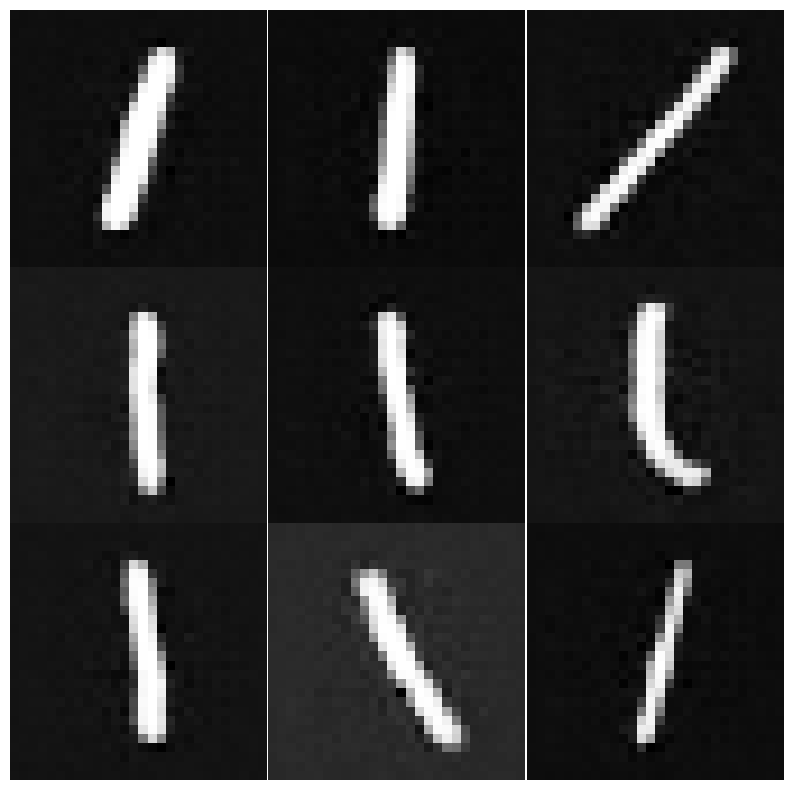

torch.Size([1000, 1, 28, 28])
class tensor(2)
torch.Size([1000, 20])
(2000, 20)
2000
(2000,)
(2000, 1, 28, 28)
(2000, 1, 28, 28)


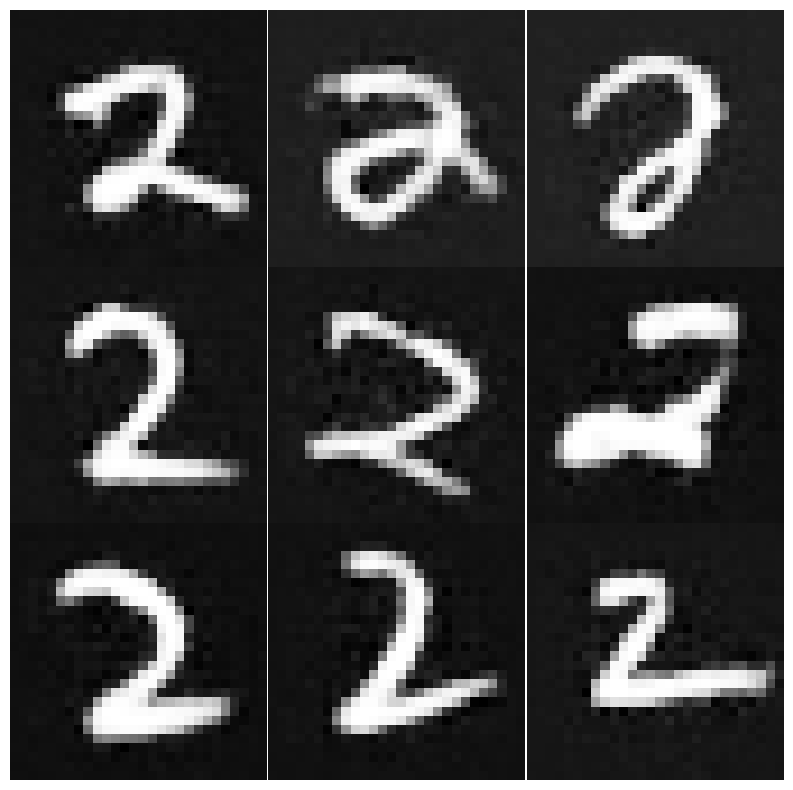

torch.Size([750, 1, 28, 28])
class tensor(3)
torch.Size([750, 20])
(2250, 20)
2250
(2250,)
(2250, 1, 28, 28)
(2250, 1, 28, 28)


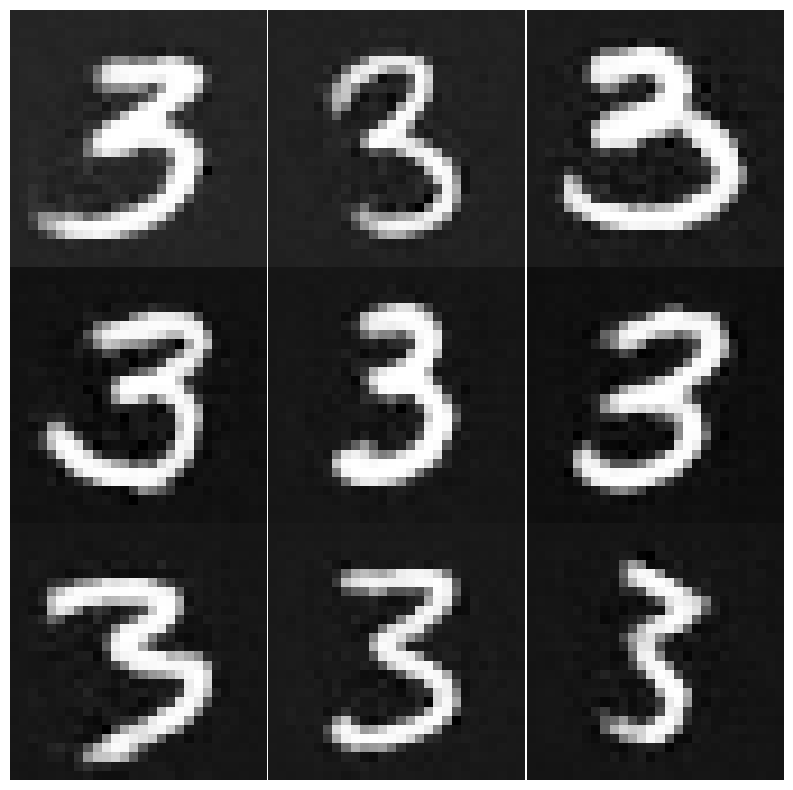

torch.Size([500, 1, 28, 28])
class tensor(4)
torch.Size([500, 20])
(2500, 20)
2500
(2500,)
(2500, 1, 28, 28)
(2500, 1, 28, 28)


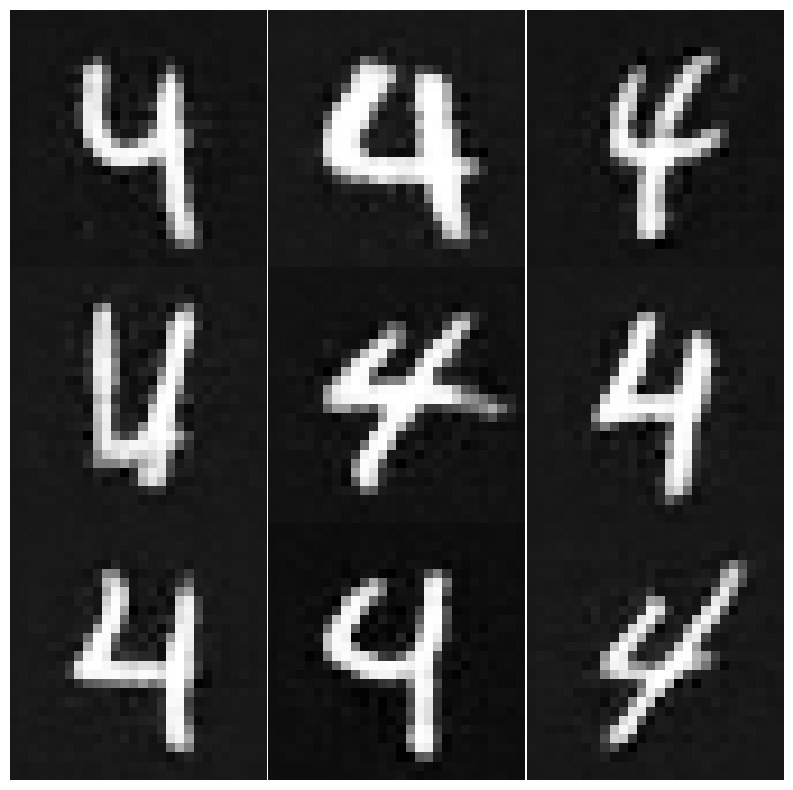

torch.Size([12, 1, 28, 28])
class tensor(5)
torch.Size([12, 20])
(2988, 20)
2988
(2988,)
(2988, 1, 28, 28)
(2988, 1, 28, 28)


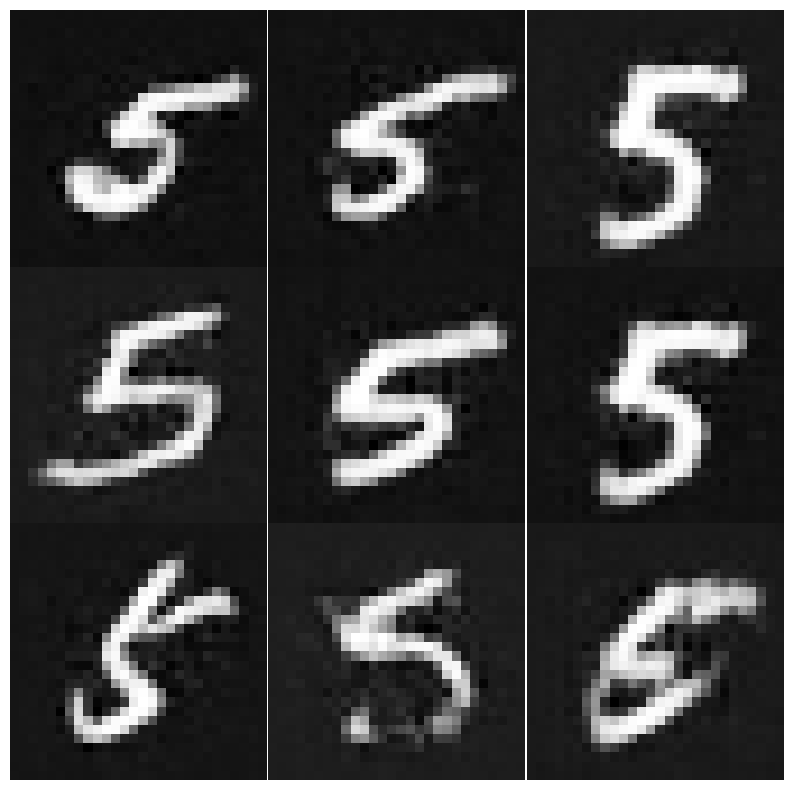

torch.Size([10, 1, 28, 28])
class tensor(6)
torch.Size([10, 20])
(2990, 20)
2990
(2990,)
(2990, 1, 28, 28)
(2990, 1, 28, 28)


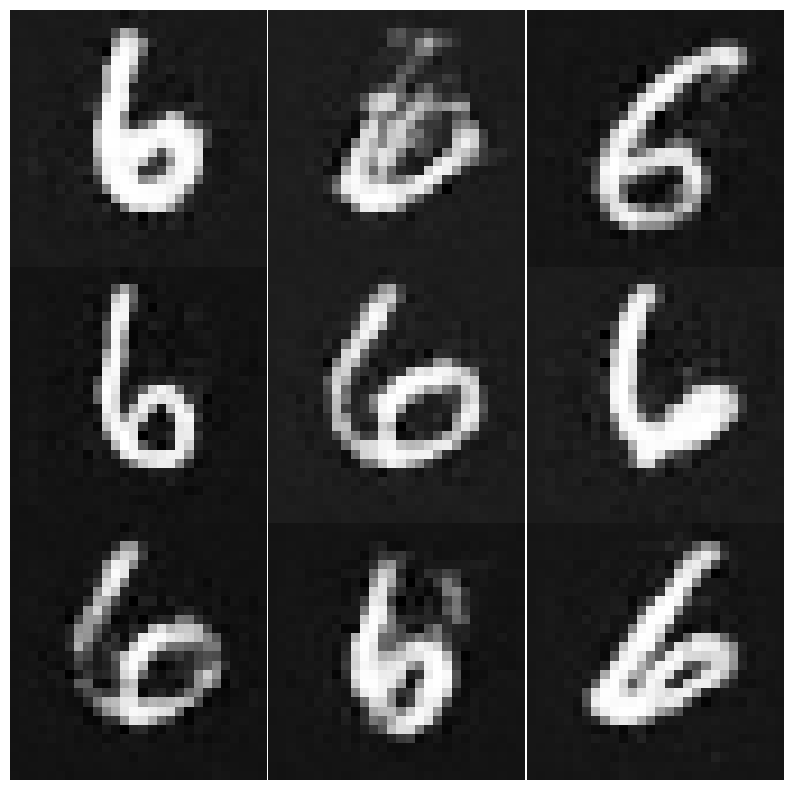

torch.Size([8, 1, 28, 28])
class tensor(7)
torch.Size([8, 20])
(2992, 20)
2992
(2992,)
(2992, 1, 28, 28)
(2992, 1, 28, 28)


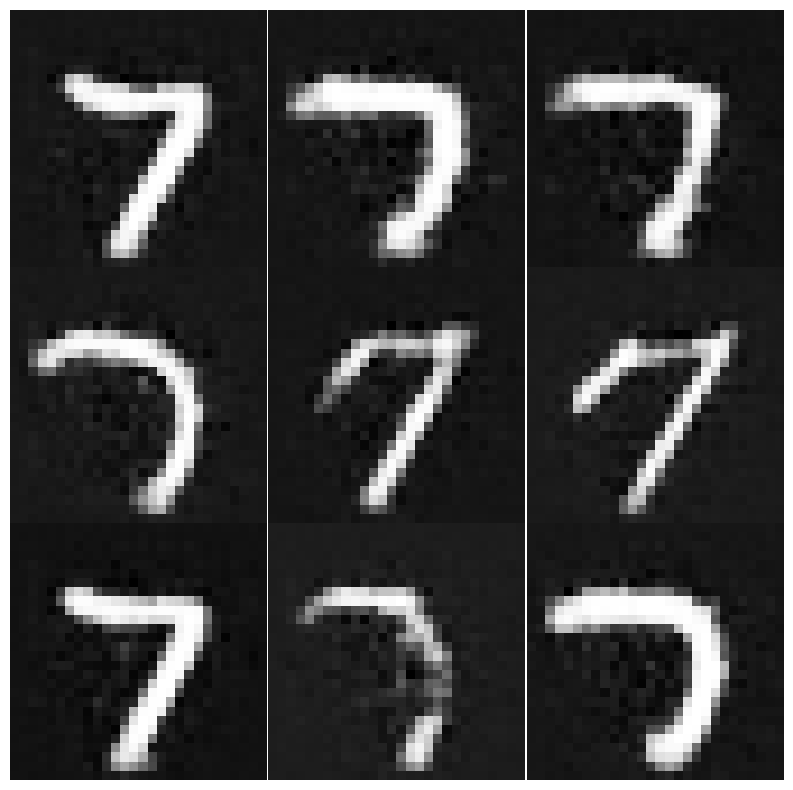

torch.Size([6, 1, 28, 28])
class tensor(8)
torch.Size([6, 20])
(2994, 20)
2994
(2994,)
(2994, 1, 28, 28)
(2994, 1, 28, 28)


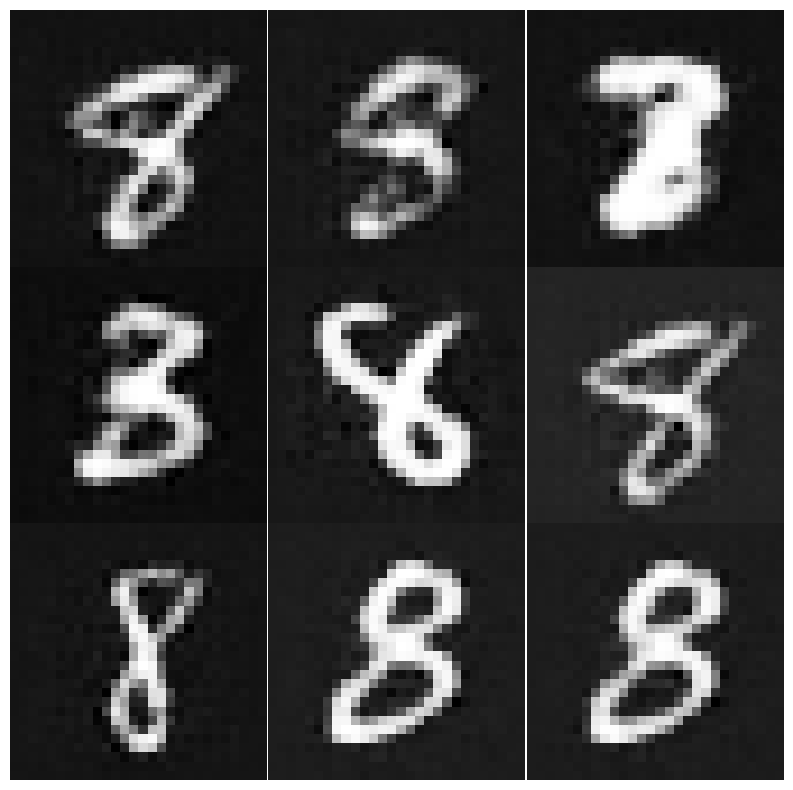

torch.Size([4, 1, 28, 28])
class tensor(9)
torch.Size([4, 20])
(2996, 20)
2996
(2996,)
(2996, 1, 28, 28)
(2996, 1, 28, 28)


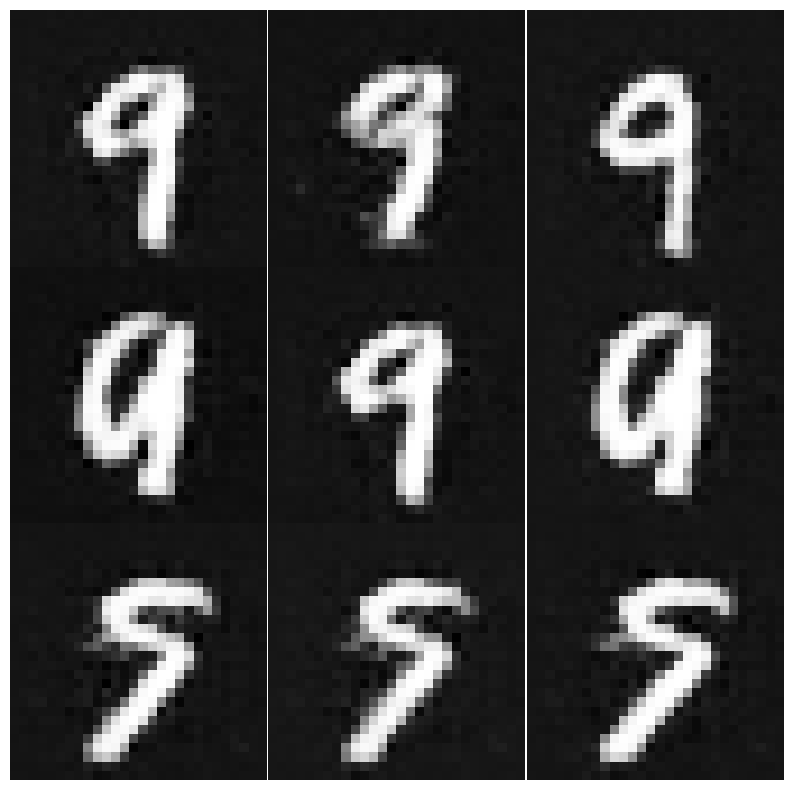

(22710, 1, 28, 28)
(22710,)
(22710, 784)
decx1  torch.Size([7290, 784])
(30000, 784)
(30000,)

final time(min): 0.89
#Dataset = 1


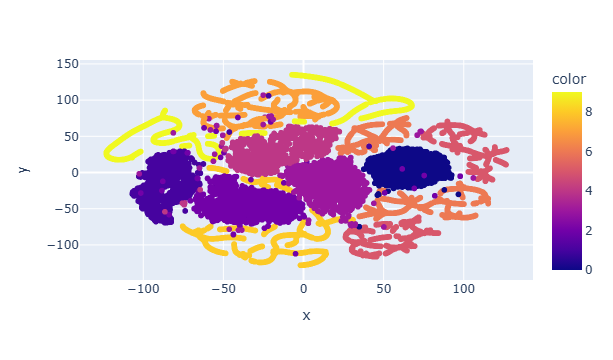

#Dataset = 1
(30000, 1, 28, 28)
(30000,)
Counter({1.0: 3000, 2.0: 3000, 3.0: 3000, 4.0: 3000, 5.0: 3000, 6.0: 3000, 7.0: 3000, 8.0: 3000, 9.0: 3000, 0.0: 3000})
train imgs after reshape  (30000, 1, 28, 28)
Train Epoch: 1 [1000/30000 (3%)]	Loss: 2.283543
Train Epoch: 1 [2000/30000 (7%)]	Loss: 2.252541
Train Epoch: 1 [3000/30000 (10%)]	Loss: 2.185645
Train Epoch: 1 [4000/30000 (13%)]	Loss: 2.020888
Train Epoch: 1 [5000/30000 (17%)]	Loss: 1.584355
Train Epoch: 1 [6000/30000 (20%)]	Loss: 0.710695
Train Epoch: 1 [7000/30000 (23%)]	Loss: 0.569970
Train Epoch: 1 [8000/30000 (27%)]	Loss: 0.505652
Train Epoch: 1 [9000/30000 (30%)]	Loss: 0.397422
Train Epoch: 1 [10000/30000 (33%)]	Loss: 0.183559
Train Epoch: 1 [11000/30000 (37%)]	Loss: 0.329352
Train Epoch: 1 [12000/30000 (40%)]	Loss: 0.085272
Train Epoch: 1 [13000/30000 (43%)]	Loss: 0.213233
Train Epoch: 1 [14000/30000 (47%)]	Loss: 0.051376
Train Epoch: 1 [15000/30000 (50%)]	Loss: 0.151253
Train Epoch: 1 [16000/30000 (53%)]	Loss: 0.122039
Train

Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 0 	Train Loss: 10.242580 	mse loss: 10.154426 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 1 	Train Loss: 3.543172 	mse loss: 3.465113 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 2 	Train Loss: 2.644926 	mse loss: 2.571141 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 3 	Train Loss: 2.207865 	mse loss: 2.132571 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 4 	Train Loss: 1.971391 	mse loss: 1.900454 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 5 	Train Loss: 1.774505 	mse loss: 1.701350 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 6 	Train Loss: 1.644811 	mse loss: 1.577029 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 7 	Train Loss: 1.559479 	mse loss: 1.489910 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 8 	Train Loss: 1.453611 	mse loss: 1.387478 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 9 	Train Loss: 1.415611 	mse loss: 1.349689 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 10 	Train Loss: 1.337737 	mse loss: 1.273007 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 11 	Train Loss: 1.282213 	mse loss: 1.217021 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 12 	Train Loss: 1.256552 	mse loss: 1.188301 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 13 	Train Loss: 1.201603 	mse loss: 1.134400 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 14 	Train Loss: 1.166704 	mse loss: 1.102102 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 15 	Train Loss: 1.131607 	mse loss: 1.067924 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 16 	Train Loss: 1.093907 	mse loss: 1.030496 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 17 	Train Loss: 1.077954 	mse loss: 1.013750 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 18 	Train Loss: 1.063741 	mse loss: 1.001008 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 19 	Train Loss: 1.040044 	mse loss: 0.978683 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:26<00:00,  1.18s/it]


Epoch: 20 	Train Loss: 1.011374 	mse loss: 0.948536 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 21 	Train Loss: 0.981633 	mse loss: 0.920494 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 22 	Train Loss: 0.976738 	mse loss: 0.915111 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 23 	Train Loss: 0.949920 	mse loss: 0.886990 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 24 	Train Loss: 0.946000 	mse loss: 0.883228 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 25 	Train Loss: 0.920028 	mse loss: 0.859861 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 26 	Train Loss: 0.900769 	mse loss: 0.840289 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 27 	Train Loss: 0.881848 	mse loss: 0.823166 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 28 	Train Loss: 0.878570 	mse loss: 0.815886 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 29 	Train Loss: 0.877479 	mse loss: 0.815691 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 30 	Train Loss: 0.861208 	mse loss: 0.798952 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 31 	Train Loss: 0.846733 	mse loss: 0.785432 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 32 	Train Loss: 0.839495 	mse loss: 0.777085 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 33 	Train Loss: 0.816153 	mse loss: 0.754287 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 34 	Train Loss: 0.811938 	mse loss: 0.752253 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 35 	Train Loss: 0.798693 	mse loss: 0.740703 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 36 	Train Loss: 0.784848 	mse loss: 0.725013 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.10s/it]


Epoch: 37 	Train Loss: 0.776664 	mse loss: 0.714886 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 38 	Train Loss: 0.758125 	mse loss: 0.698595 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 39 	Train Loss: 0.744107 	mse loss: 0.686826 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 40 	Train Loss: 0.755589 	mse loss: 0.697191 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 41 	Train Loss: 0.737390 	mse loss: 0.675868 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 42 	Train Loss: 0.722316 	mse loss: 0.661594 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 43 	Train Loss: 0.729931 	mse loss: 0.671417 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 44 	Train Loss: 0.711328 	mse loss: 0.652992 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 45 	Train Loss: 0.715428 	mse loss: 0.656080 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 46 	Train Loss: 0.710197 	mse loss: 0.651012 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 47 	Train Loss: 0.706617 	mse loss: 0.650071 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 48 	Train Loss: 0.687239 	mse loss: 0.630844 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 49 	Train Loss: 0.685753 	mse loss: 0.626970 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 50 	Train Loss: 0.657430 	mse loss: 0.600591 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 51 	Train Loss: 0.669643 	mse loss: 0.612571 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.11s/it]


Epoch: 52 	Train Loss: 0.661067 	mse loss: 0.601931 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 53 	Train Loss: 0.663867 	mse loss: 0.606471 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 54 	Train Loss: 0.648818 	mse loss: 0.590046 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 55 	Train Loss: 0.647082 	mse loss: 0.588438 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 56 	Train Loss: 0.645037 	mse loss: 0.587468 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.10s/it]


Epoch: 57 	Train Loss: 0.643974 	mse loss: 0.584379 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 58 	Train Loss: 0.652543 	mse loss: 0.595309 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 59 	Train Loss: 0.628112 	mse loss: 0.570743 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 60 	Train Loss: 0.617149 	mse loss: 0.560569 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 61 	Train Loss: 0.615904 	mse loss: 0.555343 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 62 	Train Loss: 0.589595 	mse loss: 0.532971 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 63 	Train Loss: 0.606988 	mse loss: 0.550130 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 64 	Train Loss: 0.583308 	mse loss: 0.526479 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 65 	Train Loss: 0.589510 	mse loss: 0.534699 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 66 	Train Loss: 0.576623 	mse loss: 0.521000 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 67 	Train Loss: 0.574317 	mse loss: 0.519225 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 68 	Train Loss: 0.579863 	mse loss: 0.521531 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 69 	Train Loss: 0.578593 	mse loss: 0.520024 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 70 	Train Loss: 0.560449 	mse loss: 0.502268 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 71 	Train Loss: 0.583617 	mse loss: 0.525063 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 72 	Train Loss: 0.552030 	mse loss: 0.496437 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 73 	Train Loss: 0.561769 	mse loss: 0.505521 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 74 	Train Loss: 0.545369 	mse loss: 0.487541 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 75 	Train Loss: 0.550991 	mse loss: 0.494003 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 76 	Train Loss: 0.543517 	mse loss: 0.487692 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 77 	Train Loss: 0.543168 	mse loss: 0.485456 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 78 	Train Loss: 0.534560 	mse loss: 0.478224 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 79 	Train Loss: 0.545364 	mse loss: 0.484937 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 80 	Train Loss: 0.534562 	mse loss: 0.478236 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 81 	Train Loss: 0.521624 	mse loss: 0.466911 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 82 	Train Loss: 0.508318 	mse loss: 0.452685 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 83 	Train Loss: 0.504956 	mse loss: 0.448873 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 84 	Train Loss: 0.530389 	mse loss: 0.470788 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 85 	Train Loss: 0.517950 	mse loss: 0.460783 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 86 	Train Loss: 0.509367 	mse loss: 0.452431 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 87 	Train Loss: 0.500924 	mse loss: 0.445509 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 88 	Train Loss: 0.507656 	mse loss: 0.450963 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 89 	Train Loss: 0.491492 	mse loss: 0.436885 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 90 	Train Loss: 0.502578 	mse loss: 0.446082 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 91 	Train Loss: 0.494483 	mse loss: 0.439048 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 92 	Train Loss: 0.477536 	mse loss: 0.421881 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 93 	Train Loss: 0.487484 	mse loss: 0.429661 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 94 	Train Loss: 0.488674 	mse loss: 0.433582 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 95 	Train Loss: 0.481788 	mse loss: 0.427299 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 96 	Train Loss: 0.474857 	mse loss: 0.417793 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 97 	Train Loss: 0.469947 	mse loss: 0.414152 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 98 	Train Loss: 0.468032 	mse loss: 0.411930 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 99 	Train Loss: 0.471485 	mse loss: 0.415743 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 100 	Train Loss: 0.463572 	mse loss: 0.408633 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 101 	Train Loss: 0.451436 	mse loss: 0.396597 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 102 	Train Loss: 0.453568 	mse loss: 0.395000 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 103 	Train Loss: 0.460774 	mse loss: 0.405539 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 104 	Train Loss: 0.453335 	mse loss: 0.397704 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 105 	Train Loss: 0.440321 	mse loss: 0.386879 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 106 	Train Loss: 0.450294 	mse loss: 0.393214 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 107 	Train Loss: 0.447563 	mse loss: 0.392578 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.12s/it]


Epoch: 108 	Train Loss: 0.452010 	mse loss: 0.394083 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 109 	Train Loss: 0.438637 	mse loss: 0.382171 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 110 	Train Loss: 0.428634 	mse loss: 0.374859 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 111 	Train Loss: 0.448738 	mse loss: 0.392537 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 112 	Train Loss: 0.435232 	mse loss: 0.382020 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 113 	Train Loss: 0.432589 	mse loss: 0.379576 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 114 	Train Loss: 0.420324 	mse loss: 0.365098 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 115 	Train Loss: 0.423192 	mse loss: 0.369528 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 116 	Train Loss: 0.419432 	mse loss: 0.365009 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 117 	Train Loss: 0.423455 	mse loss: 0.372364 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.12s/it]


Epoch: 118 	Train Loss: 0.424881 	mse loss: 0.370413 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 119 	Train Loss: 0.406961 	mse loss: 0.353563 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 120 	Train Loss: 0.408710 	mse loss: 0.353655 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 121 	Train Loss: 0.410967 	mse loss: 0.357300 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 122 	Train Loss: 0.410420 	mse loss: 0.354309 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 123 	Train Loss: 0.406132 	mse loss: 0.352001 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:28<00:00,  1.21s/it]


Epoch: 124 	Train Loss: 0.404867 	mse loss: 0.351115 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 125 	Train Loss: 0.404740 	mse loss: 0.351317 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 126 	Train Loss: 0.392444 	mse loss: 0.339199 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 127 	Train Loss: 0.400206 	mse loss: 0.345249 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.18s/it]


Epoch: 128 	Train Loss: 0.409040 	mse loss: 0.355157 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 129 	Train Loss: 0.392751 	mse loss: 0.339275 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.12s/it]


Epoch: 130 	Train Loss: 0.392052 	mse loss: 0.337770 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 131 	Train Loss: 0.393037 	mse loss: 0.339249 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 132 	Train Loss: 0.398109 	mse loss: 0.345992 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 133 	Train Loss: 0.376369 	mse loss: 0.323614 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 134 	Train Loss: 0.388152 	mse loss: 0.333544 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 135 	Train Loss: 0.385391 	mse loss: 0.329605 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 136 	Train Loss: 0.381605 	mse loss: 0.327570 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 137 	Train Loss: 0.383246 	mse loss: 0.326355 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 138 	Train Loss: 0.385423 	mse loss: 0.328466 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 139 	Train Loss: 0.366035 	mse loss: 0.309544 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 140 	Train Loss: 0.372122 	mse loss: 0.318460 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 141 	Train Loss: 0.370120 	mse loss: 0.315455 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 142 	Train Loss: 0.376108 	mse loss: 0.319980 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 143 	Train Loss: 0.359609 	mse loss: 0.306514 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 144 	Train Loss: 0.366525 	mse loss: 0.313154 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 145 	Train Loss: 0.361436 	mse loss: 0.307837 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 146 	Train Loss: 0.364372 	mse loss: 0.312183 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 147 	Train Loss: 0.358264 	mse loss: 0.301896 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 148 	Train Loss: 0.359738 	mse loss: 0.306824 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 149 	Train Loss: 0.353204 	mse loss: 0.299825 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 150 	Train Loss: 0.355248 	mse loss: 0.300678 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 151 	Train Loss: 0.368372 	mse loss: 0.312544 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 152 	Train Loss: 0.357305 	mse loss: 0.304422 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 153 	Train Loss: 0.356350 	mse loss: 0.303342 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 154 	Train Loss: 0.347694 	mse loss: 0.294566 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 155 	Train Loss: 0.342963 	mse loss: 0.289776 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 156 	Train Loss: 0.341888 	mse loss: 0.287747 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:25<00:00,  1.17s/it]


Epoch: 157 	Train Loss: 0.349105 	mse loss: 0.296893 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 158 	Train Loss: 0.351791 	mse loss: 0.296545 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 159 	Train Loss: 0.352122 	mse loss: 0.298500 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 160 	Train Loss: 0.339678 	mse loss: 0.285582 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.15s/it]


Epoch: 161 	Train Loss: 0.338927 	mse loss: 0.285064 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:26<00:00,  1.18s/it]


Epoch: 162 	Train Loss: 0.334982 	mse loss: 0.282238 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:32<00:00,  1.26s/it]


Epoch: 163 	Train Loss: 0.338140 	mse loss: 0.284062 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 164 	Train Loss: 0.337775 	mse loss: 0.287558 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 165 	Train Loss: 0.343344 	mse loss: 0.287883 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:24<00:00,  1.16s/it]


Epoch: 166 	Train Loss: 0.330411 	mse loss: 0.277851 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:29<00:00,  1.22s/it]


Epoch: 167 	Train Loss: 0.330541 	mse loss: 0.277222 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 168 	Train Loss: 0.336311 	mse loss: 0.282821 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 169 	Train Loss: 0.324652 	mse loss: 0.271120 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:06<00:00,  1.10it/s]


Epoch: 170 	Train Loss: 0.325946 	mse loss: 0.271422 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:07<00:00,  1.08it/s]


Epoch: 171 	Train Loss: 0.321622 	mse loss: 0.267448 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:13<00:00,  1.01s/it]


Epoch: 172 	Train Loss: 0.323250 	mse loss: 0.269513 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [00:59<00:00,  1.23it/s]


Epoch: 173 	Train Loss: 0.321211 	mse loss: 0.267842 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [00:59<00:00,  1.22it/s]


Epoch: 174 	Train Loss: 0.321727 	mse loss: 0.267692 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [00:59<00:00,  1.23it/s]


Epoch: 175 	Train Loss: 0.324777 	mse loss: 0.272815 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [00:59<00:00,  1.23it/s]


Epoch: 176 	Train Loss: 0.320496 	mse loss: 0.265633 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [00:59<00:00,  1.22it/s]


Epoch: 177 	Train Loss: 0.310520 	mse loss: 0.257555 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:17<00:00,  1.07s/it]


Epoch: 178 	Train Loss: 0.325659 	mse loss: 0.270173 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:18<00:00,  1.08s/it]


Epoch: 179 	Train Loss: 0.316296 	mse loss: 0.263316 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:19<00:00,  1.09s/it]


Epoch: 180 	Train Loss: 0.318348 	mse loss: 0.265348 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 181 	Train Loss: 0.310917 	mse loss: 0.257999 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 182 	Train Loss: 0.313011 	mse loss: 0.262108 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.10s/it]


Epoch: 183 	Train Loss: 0.315505 	mse loss: 0.261936 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.15s/it]


Epoch: 184 	Train Loss: 0.300619 	mse loss: 0.249241 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 185 	Train Loss: 0.310550 	mse loss: 0.257062 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.11s/it]


Epoch: 186 	Train Loss: 0.308564 	mse loss: 0.256119 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.14s/it]


Epoch: 187 	Train Loss: 0.309295 	mse loss: 0.255458 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 188 	Train Loss: 0.314468 	mse loss: 0.262134 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 189 	Train Loss: 0.299642 	mse loss: 0.247532 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 190 	Train Loss: 0.305183 	mse loss: 0.249205 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 191 	Train Loss: 0.295751 	mse loss: 0.243187 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.10s/it]


Epoch: 192 	Train Loss: 0.310340 	mse loss: 0.256109 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 193 	Train Loss: 0.298096 	mse loss: 0.244724 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.11s/it]


Epoch: 194 	Train Loss: 0.310419 	mse loss: 0.257262 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 195 	Train Loss: 0.295525 	mse loss: 0.241925 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:20<00:00,  1.10s/it]


Epoch: 196 	Train Loss: 0.294701 	mse loss: 0.240796 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:23<00:00,  1.14s/it]


Epoch: 197 	Train Loss: 0.282765 	mse loss: 0.231948 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:22<00:00,  1.13s/it]


Epoch: 198 	Train Loss: 0.298441 	mse loss: 0.247385 	mse2 loss: 0.000000


Loading...: 100%|██████████| 73/73 [01:21<00:00,  1.12s/it]


Epoch: 199 	Train Loss: 0.292674 	mse loss: 0.240510 	mse2 loss: 0.000000
C:/Users/admin/Desktop/Suvaporn_Lab/DeepSMOTE/CLDeepSMOTE/model/enc.pth
C:/Users/admin/Desktop/Suvaporn_Lab/DeepSMOTE/CLDeepSMOTE/model/dec.pth

total time(min): 275.13


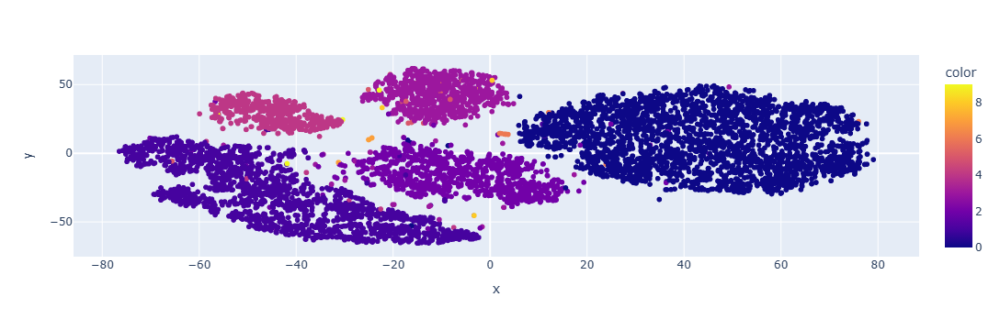

0
torch.Size([2000, 1, 28, 28])
class tensor(1)
torch.Size([2000, 20])
(1000, 20)
1000
(1000,)
(1000, 1, 28, 28)
(1000, 1, 28, 28)


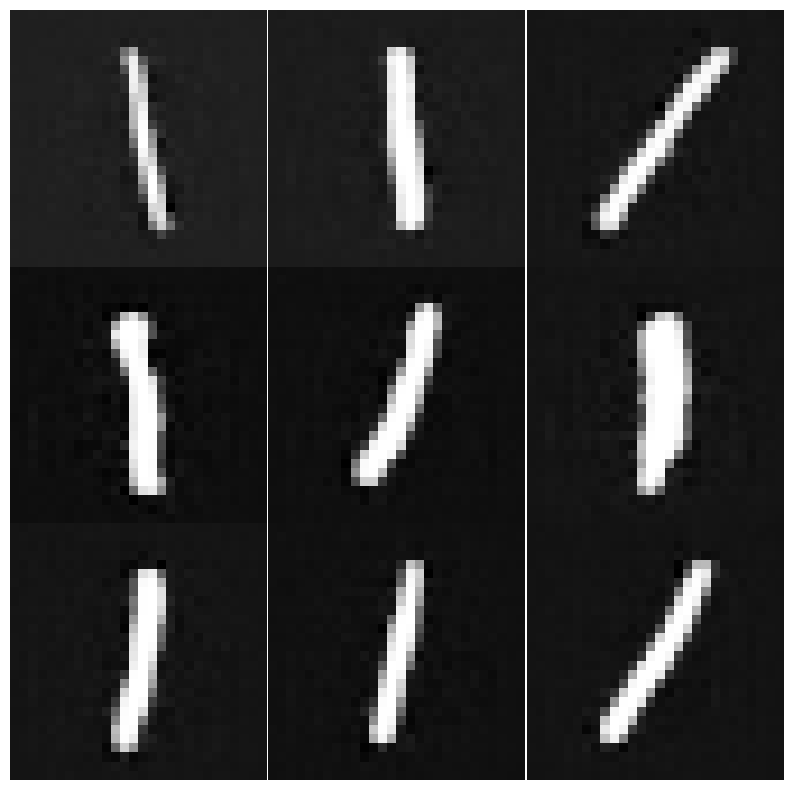

torch.Size([1000, 1, 28, 28])
class tensor(2)
torch.Size([1000, 20])
(2000, 20)
2000
(2000,)
(2000, 1, 28, 28)
(2000, 1, 28, 28)


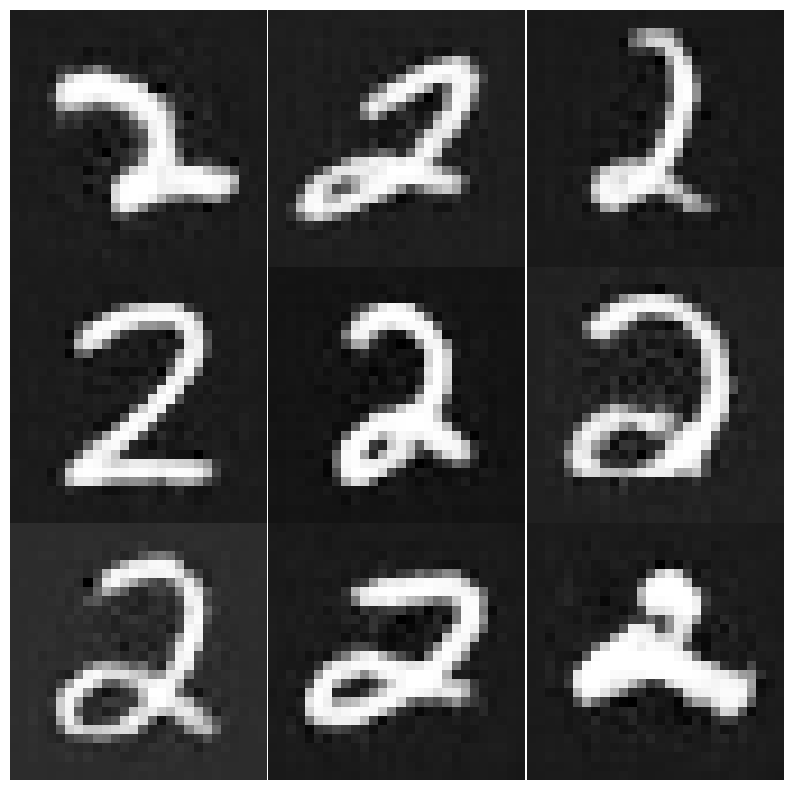

torch.Size([750, 1, 28, 28])
class tensor(3)
torch.Size([750, 20])
(2250, 20)
2250
(2250,)
(2250, 1, 28, 28)
(2250, 1, 28, 28)


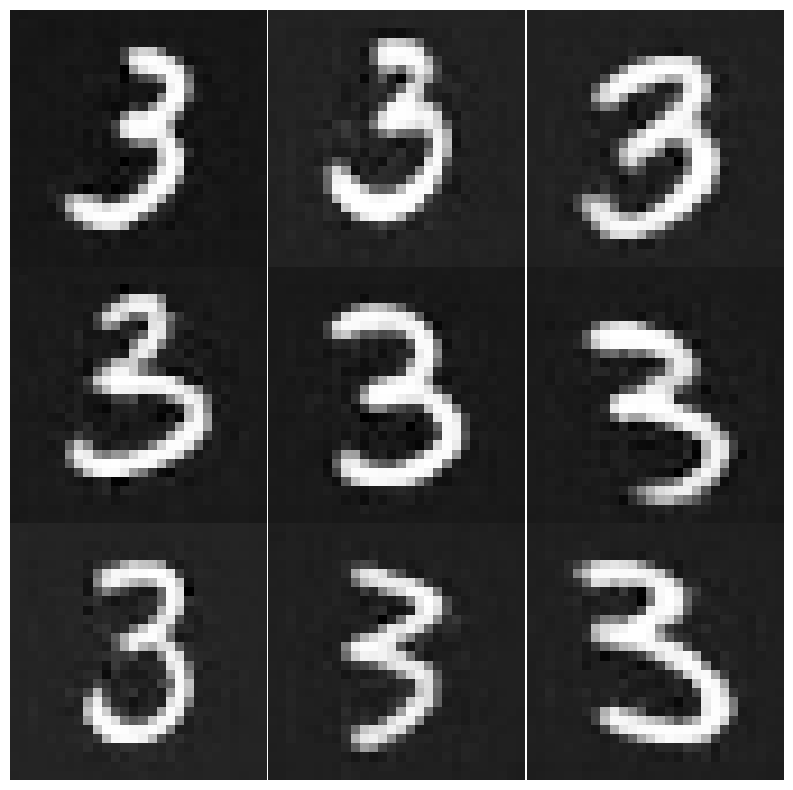

torch.Size([500, 1, 28, 28])
class tensor(4)
torch.Size([500, 20])
(2500, 20)
2500
(2500,)
(2500, 1, 28, 28)
(2500, 1, 28, 28)


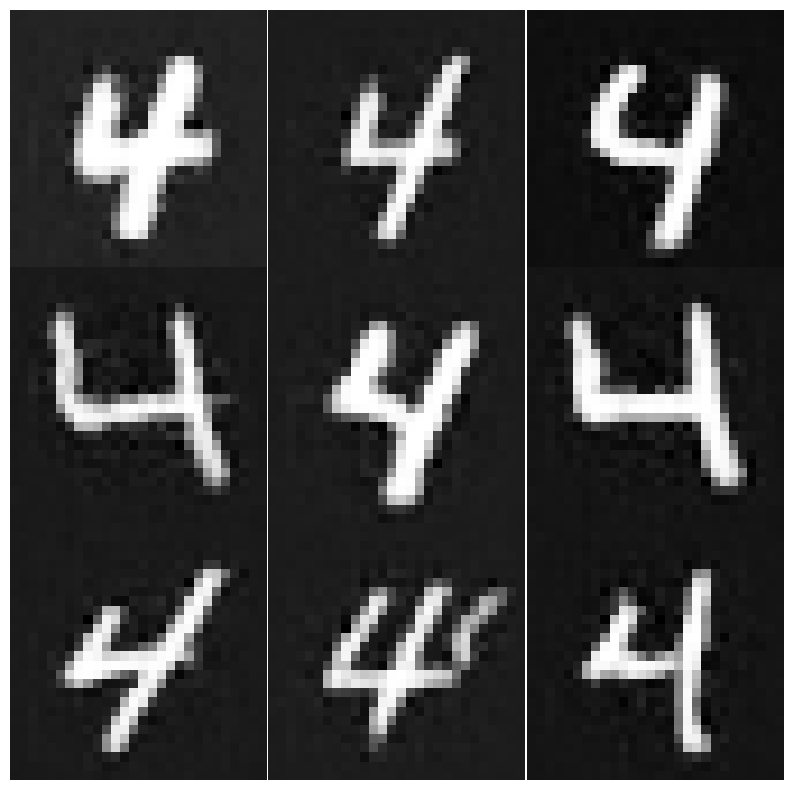

torch.Size([12, 1, 28, 28])
class tensor(5)
torch.Size([12, 20])
(2988, 20)
2988
(2988,)
(2988, 1, 28, 28)
(2988, 1, 28, 28)


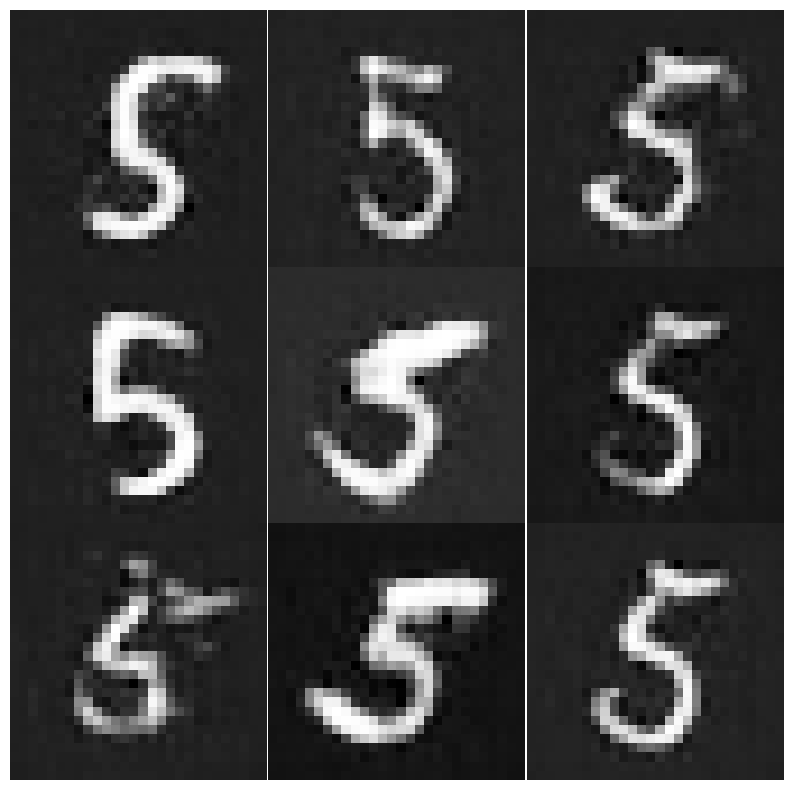

torch.Size([10, 1, 28, 28])
class tensor(6)
torch.Size([10, 20])
(2990, 20)
2990
(2990,)
(2990, 1, 28, 28)
(2990, 1, 28, 28)


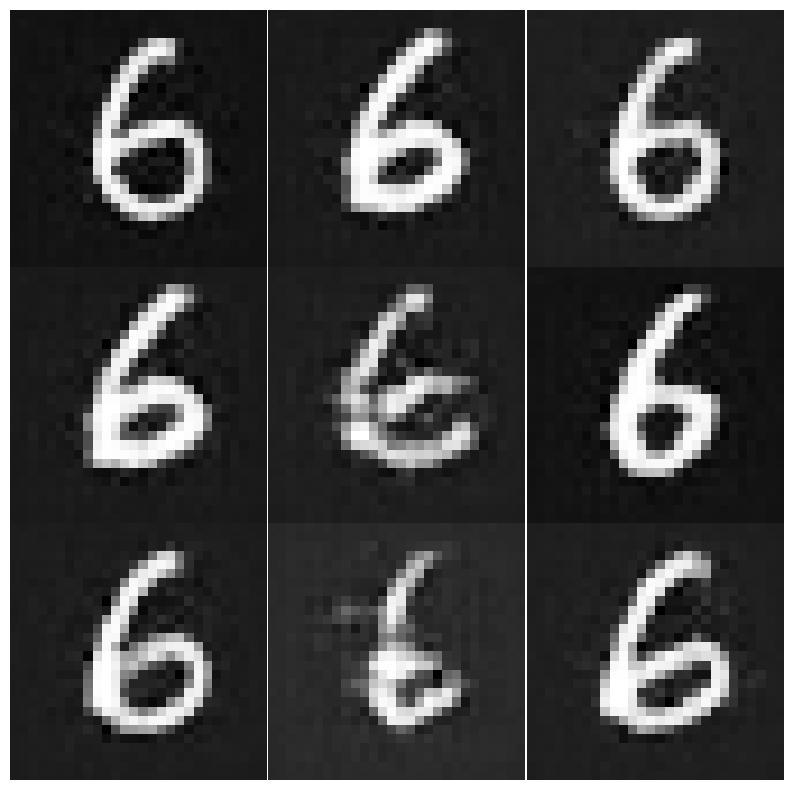

torch.Size([8, 1, 28, 28])
class tensor(7)
torch.Size([8, 20])
(2992, 20)
2992
(2992,)
(2992, 1, 28, 28)
(2992, 1, 28, 28)


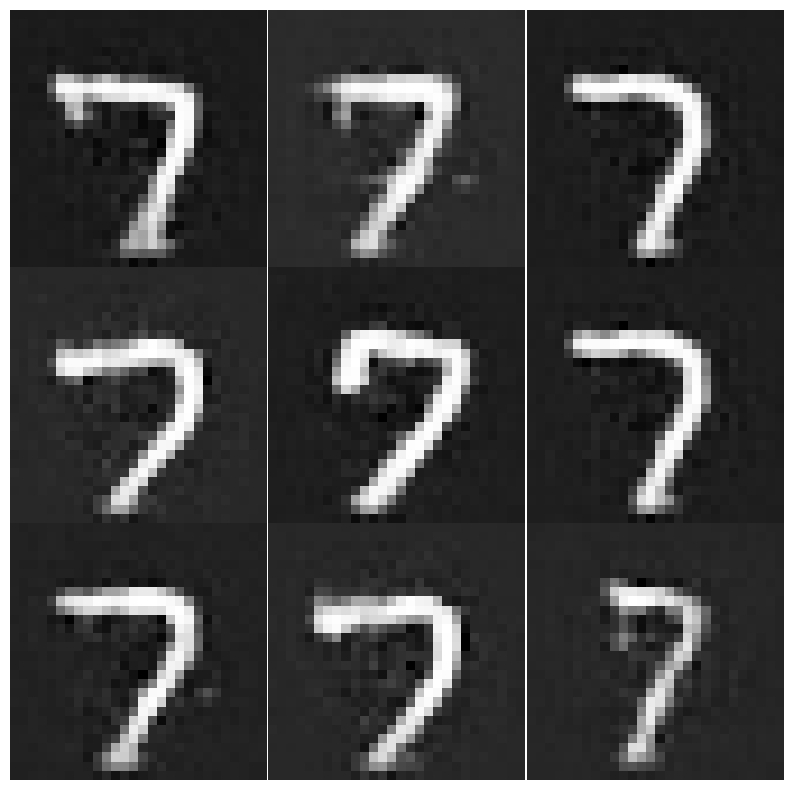

torch.Size([6, 1, 28, 28])
class tensor(8)
torch.Size([6, 20])
(2994, 20)
2994
(2994,)
(2994, 1, 28, 28)
(2994, 1, 28, 28)


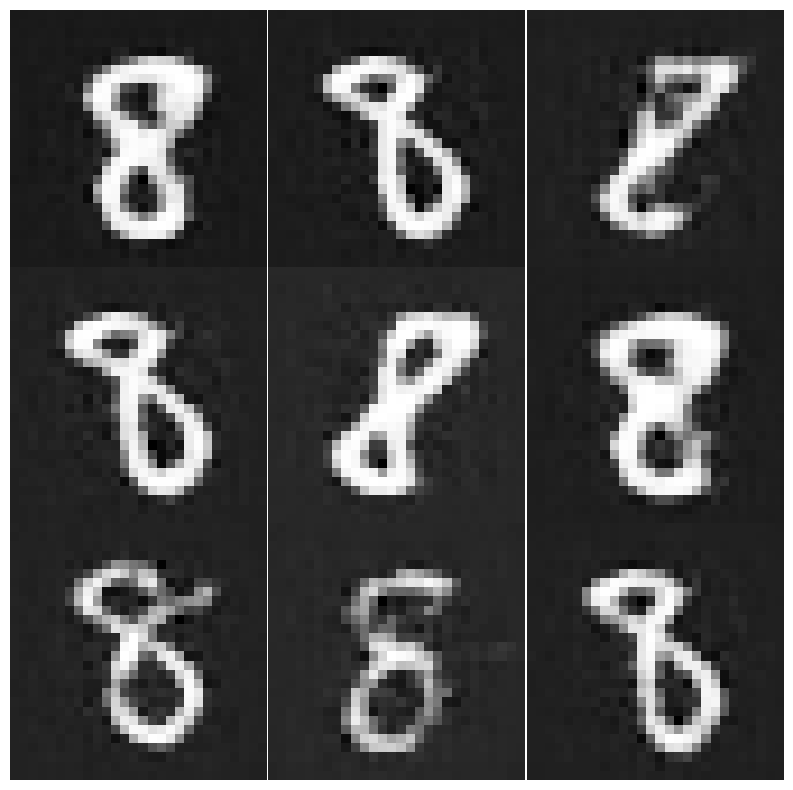

torch.Size([4, 1, 28, 28])
class tensor(9)
torch.Size([4, 20])
(2996, 20)
2996
(2996,)
(2996, 1, 28, 28)
(2996, 1, 28, 28)


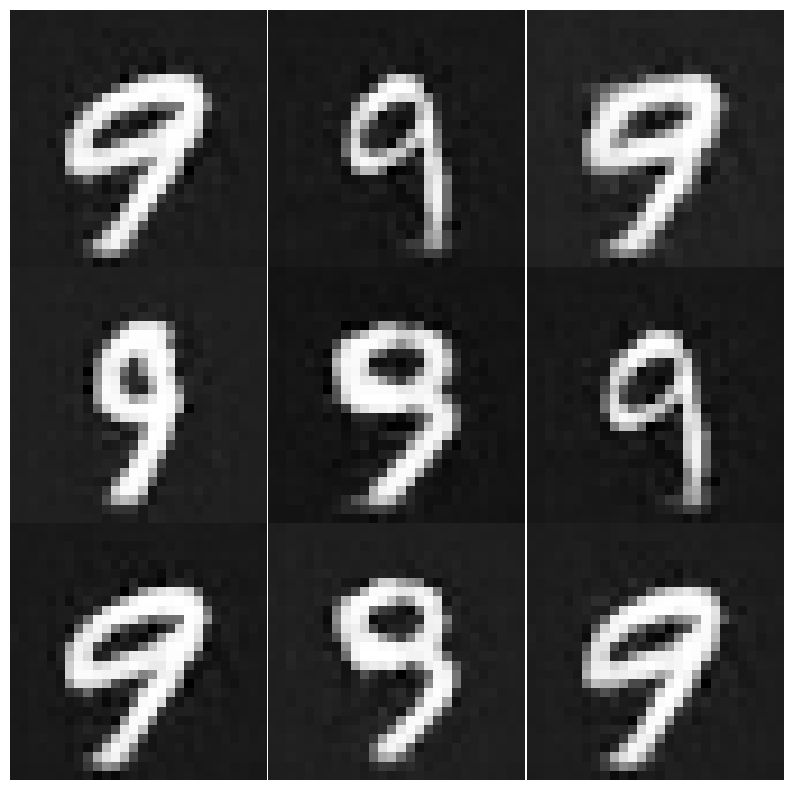

(22710, 1, 28, 28)
(22710,)
(22710, 784)
decx1  torch.Size([7290, 784])
(30000, 784)
(30000,)

final time(min): 1.00
#Dataset = 1


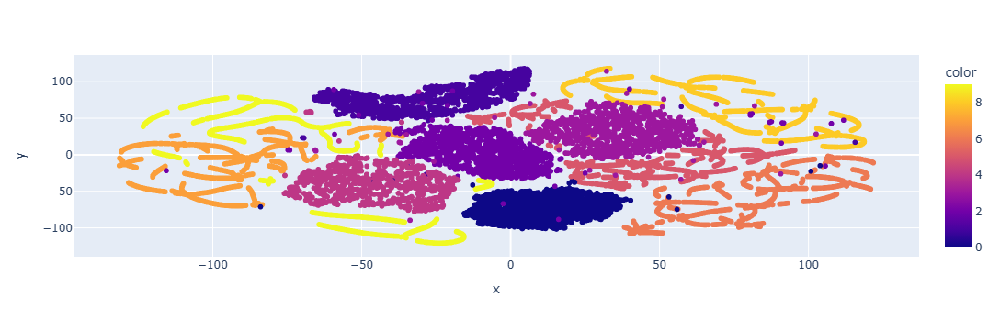

#Dataset = 1
(30000, 1, 28, 28)
(30000,)
Counter({1.0: 3000, 2.0: 3000, 3.0: 3000, 4.0: 3000, 5.0: 3000, 6.0: 3000, 7.0: 3000, 8.0: 3000, 9.0: 3000, 0.0: 3000})
train imgs after reshape  (30000, 1, 28, 28)
Train Epoch: 1 [1000/30000 (3%)]	Loss: 2.281807
Train Epoch: 1 [2000/30000 (7%)]	Loss: 2.238991
Train Epoch: 1 [3000/30000 (10%)]	Loss: 2.163981
Train Epoch: 1 [4000/30000 (13%)]	Loss: 1.891316
Train Epoch: 1 [5000/30000 (17%)]	Loss: 1.187537
Train Epoch: 1 [6000/30000 (20%)]	Loss: 0.543096
Train Epoch: 1 [7000/30000 (23%)]	Loss: 0.252582
Train Epoch: 1 [8000/30000 (27%)]	Loss: 0.105106
Train Epoch: 1 [9000/30000 (30%)]	Loss: 0.236810
Train Epoch: 1 [10000/30000 (33%)]	Loss: 0.138185
Train Epoch: 1 [11000/30000 (37%)]	Loss: 0.116140
Train Epoch: 1 [12000/30000 (40%)]	Loss: 0.065382
Train Epoch: 1 [13000/30000 (43%)]	Loss: 0.208826
Train Epoch: 1 [14000/30000 (47%)]	Loss: 0.080345
Train Epoch: 1 [15000/30000 (50%)]	Loss: 0.075915
Train Epoch: 1 [16000/30000 (53%)]	Loss: 0.034064
Train

In [67]:
trainingDataset_loss = []
avg_accuracy_list = []
avg_sensitivity_list = []
avg_specificity_list = []
avg_precision_list = []

g_mean_list = []
f_measure_list = []
acsa_list = []
cm_list = []

t3=0
for dataset,imbalanced_train in zip(folds_data,imbalanced_train_dataset_list):  #len(ids)
    print()
    print(i)
    encoder = Encoder(args)
    decoder = Decoder(args)

    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    print(device)
    decoder = decoder.to(device)
    encoder = encoder.to(device)

    train_on_gpu = torch.cuda.is_available()

    #decoder loss function
    criterion = nn.MSELoss()
    criterion = criterion.to(device)

    batch_size = 100
    num_workers = 0

    train_loader = dataset[0]

    classes = ('0', '1', '2', '3', '4',
           '5', '6', '7', '8', '9')

    best_loss = np.inf

    list_zhat_test,list_labs_test = [],[]

    t0 = time.time()
    if args['train']:
        enc_optim = torch.optim.Adam(encoder.parameters(), lr = args['lr'])
        dec_optim = torch.optim.Adam(decoder.parameters(), lr = args['lr'])

        for epoch in range(args['epochs']):
            train_loss = 0.0
            tmse_loss = 0.0
            tdiscr_loss = 0.0
            # train for one epoch -- set nets to train mode
            encoder.train()
            decoder.train()

            for images,labs in tqdm(train_loader,desc='Loading...'):

                # zero gradients for each batch
                encoder.zero_grad()
                decoder.zero_grad()
                images, labs = images.to(device), labs.to(device)
                labsn = labs.detach().cpu().numpy()

                num_clss_in_bag = np.unique(labsn) 
                train_list = [[] for _ in range(args['num_class'])]
                # run images
                z_hat,x0_hat = encoder(images,labsn)

                # Class images Bagging from z_hat
                for i, label in enumerate(labsn):
                  train_list[int(label)].append(z_hat[i])

                loss_list = [[] for _ in range(args['num_class'])]
                for j in num_clss_in_bag:

                  size = x0_hat[j].size()
                  test_x0 = torch.stack(train_list[j]).to(device)
                  test_x0 = test_x0.detach().cpu().numpy()  # Convert to NumPy array after detaching
                  test_x0 = np.resize(test_x0, size)
                  test_x0 = torch.from_numpy(test_x0).to(device)

                  mse2 = criterion(x0_hat[j],test_x0)

                  loss_list[j] = mse2


                # Convert empty lists to zero tensors to allow summation
                loss_list = [torch.tensor(0.0).to(device) if not l else l for l in loss_list ]

                # Use for plotting distribution
                if epoch == args['epochs']-1:
                      list_labs_test = np.append(list_labs_test, labsn )
                      list_zhat_test = np.append(list_zhat_test,z_hat.cpu().detach().numpy())

                x_hat = decoder(z_hat)

                mse = criterion(x_hat,images)


                total_sums = calculate_diffs(x0_hat)
                total_sums_array = np.array(total_sums)
                total_sums_array[total_sums_array == 0] = 0  
                mse3 = np.zeros_like( total_sums_array, dtype = float)
                nonzero_indices = np.where( total_sums_array != 0)
                mse3[nonzero_indices] = 1/total_sums_array[nonzero_indices]

                comb_loss = mse + sum(loss_list) + sum(mse3)
                comb_loss.backward()

                enc_optim.step()
                dec_optim.step()

                train_loss += comb_loss.item()*images.size(0)
                tmse_loss += mse.item()*images.size(0)


            # print avg training statistics
            train_loss = train_loss/len(train_loader)
            tmse_loss = tmse_loss/len(train_loader)
            tdiscr_loss = 0 #No use
            print('Epoch: {} \tTrain Loss: {:.6f} \tmse loss: {:.6f} \tmse2 loss: {:.6f}'.format(epoch,
                    train_loss,tmse_loss,tdiscr_loss))
            trainingDataset_loss.append(train_loss)

        #in addition, store the final model (may not be the best) for
        #informational purposes
        path_enc = 'C:/Users/admin/Desktop/Suvaporn_Lab/DeepSMOTE/CLDeepSMOTE/model/enc.pth'
        path_dec = 'C:/Users/admin/Desktop/Suvaporn_Lab/DeepSMOTE/CLDeepSMOTE/model/dec.pth'
        print(path_enc)
        print(path_dec)
        torch.save(encoder.state_dict(), path_enc)
        torch.save(decoder.state_dict(), path_dec)
        print()

    t1 = time.time()
    print('total time(min): {:.2f}'.format((t1 - t0)/60))
    
    ################  PLOT TRAIN DISTRIBUTION ######################
    from sklearn.decomposition import PCA
    import numpy as np
    import pandas as pd
    import plotly.express as px
    
    list_labs_test,list_zhat_test
    copy_list_zhat_test = list_zhat_test.copy()
    
    first_dim = len(list_zhat_test) // args['n_z']
    list_zhat_test_reshape =  copy_list_zhat_test.reshape(first_dim, args['n_z'])
    
    #pca = PCA(n_components=2)
    #components = pca.fit_transform(list_zhat_test_reshape )
    
    #df = pd.DataFrame(components) # Create a DataFrame from components
    #fig = px.scatter(df, x=0, y=1, color=np.array(list_labs_test)) # Use column 0 for both x and y, convert list_labs_test to numpy array
    #fig.show()
    
    from sklearn.manifold import TSNE
    tsne = TSNE(n_components=2, random_state=42)
    X_tsne = tsne.fit_transform(list_zhat_test_reshape)
    fig = px.scatter(x=X_tsne[:, 0], y=X_tsne[:, 1], color=list_labs_test)
    fig.show()
    
    ############ GENERATE ###########################################################
    import collections
    import torch
    import torch.nn as nn
    from torch.utils.data import TensorDataset
    import numpy as np
    from sklearn.neighbors import NearestNeighbors
    import time
    import os
    import sys
    import matplotlib.pyplot as plt
    np.printoptions(precision=5,suppress=True)
    
    #path on the computer where the models are stored
    latent_img,latent_lab = [],[]
    modpth = 'C:/Users/admin/Desktop/Suvaporn_Lab/DeepSMOTE/CLDeepSMOTE/model'
    
    encf = []
    decf = []
    for p in range(1):
        enc = modpth + '/' + '/enc.pth'
        dec = modpth + '/' + '/dec.pth'
        encf.append(enc)
        decf.append(dec)
    
    for m in range(1):
        print(m)
    
        classes = ('0', '1', '2', '3', '4',
               '5', '6', '7', '8', '9')
    
        #generate some images
        train_on_gpu = torch.cuda.is_available()
        device = 'cuda' if torch.cuda.is_available() else 'cpu'
        path_enc = encf[m]
        path_dec = decf[m]
    
        encoder = Encoder(args)
        # Load the encoder state dictionary and map to the available device
        encoder.load_state_dict(torch.load(path_enc, map_location=device), strict=False)
        encoder = encoder.to(device)
    
        decoder = Decoder(args)
        decoder.load_state_dict(torch.load(path_dec, map_location=device), strict=False)
        decoder = decoder.to(device)
    
        encoder.eval()
        decoder.eval()
    
        imbal = [3000, 2000, 1000, 750, 500, 12, 10, 8, 6, 4]
    
        resx = []
        resy = []
        
        data = [item[0] for item in imbalanced_train]
        target = [item[1] for item in imbalanced_train]
        data = torch.stack(data)
        target = torch.tensor(target)

        t0 = time.time()
        for i in range(1,10):
    
            xclass, yclass = biased_get_class1(i,data,target)
    
            print(xclass.shape) #(500, 3, 32, 32)
            print('class',yclass[0]) #(500,)
    
            #encode xclass to feature space
            #xclass = torch.Tensor(xclass)
            xclass = xclass.to(device)
            xclass,_ = encoder(xclass,yclass)
            print(xclass.shape) #torch.Size([500, 600])

            xclass = xclass.detach().cpu().numpy()

            latent_img = np.append(latent_img, xclass)
            latent_lab = np.append(latent_lab, yclass)
            
            n = imbal[0] - imbal[i]
    
            #SMOTE
            xsamp, ysamp = G_SM1(xclass,yclass,n,i)
            print(xsamp.shape) #(4500, 600)
            print(len(ysamp)) #4500
            ysamp = np.array(ysamp)
            print(ysamp.shape) #4500
    
            #to generate samples for resnet"""
            xsamp = torch.Tensor(xsamp)
            xsamp = xsamp.to(device)
            #xsamp = xsamp.view(xsamp.size()[0], xsamp.size()[1], 1, 1)
            #print(xsamp.size()) #torch.Size([10, 600, 1, 1])
            ximg = decoder(xsamp)
    
            ximn = ximg.detach().cpu().numpy()
            print(ximn.shape) #(4500, 3, 32, 32)
            print(ximn.shape) #(4500, 3, 32, 32)
    
            resx.append(ximn)
            resy.append(ysamp)
    
            # Squeeze the first dimension to get a compatible shape for imshow
            
            plt.figure(figsize=(10,10))
            for k in range(9):
              plt.subplot(3,3,k+1)
              ximn_squeezed = ximn[k].squeeze()
              plt.imshow(ximn_squeezed, cmap='gray')
              plt.axis('off')
            plt.subplots_adjust(wspace=0, hspace=0)
            plt.show()
    
    
        t1 = time.time()
        resx1 = np.vstack(resx)
        resy1 = np.hstack(resy)
    
        print(resx1.shape) #(34720, 3, 32, 32)
        print(resy1.shape) #(34720,)
    
        resx1 = resx1.reshape(resx1.shape[0],-1)
        print(resx1.shape) #(34720, 3072)
    
        dec_x1 = data.reshape(data.shape[0],-1)
        print('decx1 ',dec_x1.shape)
        combx = np.vstack((resx1,dec_x1))
        comby = np.hstack((resy1,target))
    
        print(combx.shape) #(45000, 3, 32, 32)
        print(comby.shape) #(45000,)
    
        ifile = 'C:/Users/admin/Desktop/Suvaporn_Lab/DeepSMOTE/CLDeepSMOTE/sampling/balimg/trn_img.txt'
        np.savetxt(ifile, combx)
    
        lfile = 'C:/Users/admin/Desktop/Suvaporn_Lab/DeepSMOTE/CLDeepSMOTE/sampling/ballab/trn_lab.txt'
        np.savetxt(lfile,comby)
    
        print()
        #sys.exit(1)
    
    
    print('final time(min): {:.2f}'.format((t1 - t0)/60))

    #  PLOT BALANCED DISTRIBUTION ##########################################################
    
    dtrnimg = 'C:/Users/admin/Desktop/Suvaporn_Lab/DeepSMOTE/CLDeepSMOTE/sampling/balimg'
    dtrnlab = 'C:/Users/admin/Desktop/Suvaporn_Lab/DeepSMOTE/CLDeepSMOTE/sampling/ballab'
    
    ids = os.listdir(dtrnimg)
    idtri_f = [os.path.join(dtrnimg, image_id) for image_id in ids]
    
    ids = os.listdir(dtrnlab)
    idtrl_f = [os.path.join(dtrnlab, image_id) for image_id in ids]
    
    print("#Dataset =",len(ids))
    
    trnimgfile = idtri_f[0]
    trnlabfile = idtrl_f[0]
    dec_x = np.loadtxt(trnimgfile)
    dec_y = np.loadtxt(trnlabfile)

    #pca = PCA(n_components=2)
    #components = pca.fit_transform(dec_x)
    
    #df = pd.DataFrame(components) # Create a DataFrame from components
    #fig = px.scatter(df, x=0, y=1, color=np.array(dec_y)) # Use column 0 for both x and y, convert list_labs_test to numpy array
    
    #fig.show()
    from sklearn.manifold import TSNE
    tsne = TSNE(n_components=2, random_state=42)
    X_tsne = tsne.fit_transform(dec_x)
    fig = px.scatter(x=X_tsne[:, 0], y=X_tsne[:, 1], color=dec_y)
    fig.show()

    #  IMPORT BL IMAGES ###########################################################
    from sklearn.model_selection import KFold
    import numpy as np
    import collections
    import torch
    from torch.utils.data import TensorDataset
    
    dtrnimg = 'C:/Users/admin/Desktop/Suvaporn_Lab/DeepSMOTE/CLDeepSMOTE/sampling/balimg'
    dtrnlab = 'C:/Users/admin/Desktop/Suvaporn_Lab/DeepSMOTE/CLDeepSMOTE/sampling/ballab'
    
    ids = os.listdir(dtrnimg)
    idtri_f = [os.path.join(dtrnimg, image_id) for image_id in ids]
    
    ids = os.listdir(dtrnlab)
    idtrl_f = [os.path.join(dtrnlab, image_id) for image_id in ids]
    
    print("#Dataset =",len(ids))
    
    trnimgfile = idtri_f[0]
    trnlabfile = idtrl_f[0]
    dec_x = np.loadtxt(trnimgfile)
    dec_y = np.loadtxt(trnlabfile)
    #Reshape
    dec_x = dec_x.reshape(dec_x.shape[0],1,28,28)
    
    batch_size = 100
    num_workers = 0
    
    #torch.Tensor returns float so if want long then use torch.tensor
    tensor_x = torch.Tensor(dec_x)
    tensor_y = torch.tensor(dec_y,dtype=torch.long)
    mnist_bal = TensorDataset(tensor_x,tensor_y)
    train_loader = torch.utils.data.DataLoader(mnist_bal,
                    batch_size=batch_size,shuffle=True,num_workers=num_workers)
    
    print(np.shape(dec_x))
    print(np.shape(dec_y))
    
    print(collections.Counter(dec_y))
    
    print('train imgs after reshape ',dec_x.shape)

    #  TRAIN CNN
    # Create model, optimizer, and loss function
    #check gpu
    import torch.optim as optim
    import torch.nn as nn
    
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    
    #set hyperparameter
    EPOCH = 2
    pre_epoch = 0
    BATCH_SIZE = 100
    LR = 0.01
    
    model = SimpleCNN().to(device)#ResNetMNIST().to(device)#SimpleCNN().to(device)
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.SGD(model.parameters(), lr=LR, momentum=0.9, weight_decay=5e-4) #optim.Adam(model.parameters())
    
    # Training loop
    num_epochs = 5
    for epoch in range(num_epochs):
        for batch_idx, (data, target) in enumerate(train_loader):
            data = data.to(device)
            target = target.to(device)
            optimizer.zero_grad()
    
            output = model(data)
    
            loss = criterion(output, target)
            loss.backward()
            optimizer.step()
    
            if (batch_idx + 1) % 10 == 0:
                print(
                    "Train Epoch: {} [{}/{} ({:.0f}%)]\tLoss: {:.6f}".format(
                        epoch + 1,
                        (batch_idx+1) * len(data),
                        len(train_loader.dataset),
                        100.0 * (batch_idx+1) / len(train_loader),
                        loss.item(),
                    )
                )
    
    print("Training finished!")


    #  TEST CNN
    # prompt: measure ACSA, GM, and FM from imbalanced_test_loader
    import numpy as np
    from sklearn.metrics import confusion_matrix
    
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.eval()  # Set the model to evaluation mode
    
    true_labels = []
    predicted_labels = []
    
    with torch.no_grad():
        for data, target in dataset[1]:
            data = data.to(device)
            target = target.to(device)
    
            output = model(data)
            _, predicted = torch.max(output.data, 1)
    
            true_labels.extend(target.cpu().numpy())
            predicted_labels.extend(predicted.cpu().numpy())
    
    cm = confusion_matrix(true_labels, predicted_labels)
    print("Confusion Matrix:")
    print(cm)
    cm_list.append(cm)
    
    # Calculate class-wise accuracy, sensitivity, specificity, and precision
    class_accuracies = []
    class_sensitivities = []
    class_specificities = []
    class_precisions = []
    
    for i in range(cm.shape[0]):
      tp = cm[i, i]
      fp = np.sum(cm[:, i]) - tp
      fn = np.sum(cm[i, :]) - tp
      tn = np.sum(cm) - tp - fp - fn
    
      class_accuracy = (tp + tn) / (tp + fp + fn + tn) if (tp + fp + fn + tn) > 0 else 0
      class_sensitivity = tp / (tp + fn) if (tp + fn) > 0 else 0
      class_specificity = tn / (tn + fp) if (tn + fp) > 0 else 0
      class_precision = tp / (tp + fp) if (tp + fp) > 0 else 0
    
      class_accuracies.append(class_accuracy)
      class_sensitivities.append(class_sensitivity)
      class_specificities.append(class_specificity)
      class_precisions.append(class_precision)
    
    # Calculate the average accuracy, sensitivity, specificity, and precision
    avg_accuracy = np.mean(class_accuracies)
    avg_sensitivity = np.mean(class_sensitivities)
    avg_specificity = np.mean(class_specificities)
    avg_precision = np.mean(class_precisions)
    
    # Calculate G-mean and F-measure
    g_mean = np.sqrt(avg_sensitivity * avg_specificity)
    f_measure = 2 * (avg_precision * avg_sensitivity) / (avg_precision + avg_sensitivity) if (avg_precision + avg_sensitivity) > 0 else 0
    
    print("\nAverage Accuracy:", avg_accuracy)
    print("Average Sensitivity:", avg_sensitivity)
    print("Average Specificity:", avg_specificity)
    print("Average Precision:", avg_precision)
    
    print("\nG-mean:", g_mean)
    print("F-measure:", f_measure)
    
    
    # Calculate ACSA (Average Class-wise Sensitivity and Accuracy)
    acsa = (avg_sensitivity + avg_accuracy) / 2
    print("\nACSA:", acsa)
    
    avg_accuracy_list.append(avg_accuracy)
    print(avg_accuracy_list)
    avg_sensitivity_list.append(avg_sensitivity)
    avg_specificity_list.append(avg_specificity)
    avg_precision_list.append(avg_precision)
    g_mean_list.append(g_mean)
    f_measure_list.append(f_measure)
    acsa_list.append(acsa)

t4 = time.time()
print('final time(min): {:.2f}'.format((t4 - t3)/60))


In [68]:
print("Average Accuracy:", statistics.mean(avg_accuracy_list))
print("Average Sensitivity:", statistics.mean(avg_sensitivity_list))
print("Average Specificity:", statistics.mean(avg_specificity_list))
print("Average Precision:", statistics.mean(avg_precision_list))

print("\nG-mean:", statistics.mean(g_mean_list))
print("F-measure:", statistics.mean(f_measure_list))
print("\nACSA:", statistics.mean(acsa_list))
print(cm_list)

Average Accuracy: 0.9580959409594095
Average Sensitivity: 0.790479704797048
Average Specificity: 0.9767199671996719
Average Precision: 0.8254577545092749

G-mean: 0.8786719784982541
F-measure: 0.8075624596006231

ACSA: 0.8742878228782288
[array([[1081,    0,    3,    0,    0,    0,    0,    0,    0,    0],
       [   1, 1070,    8,    3,    1,    0,    0,    0,    0,    1],
       [   4,    1, 1053,   12,    9,    1,    1,    0,    3,    0],
       [   1,    4,   21, 1050,    2,    1,    0,    2,    2,    1],
       [   2,    8,    4,    1, 1066,    1,    1,    1,    0,    0],
       [  38,   12,   11,  235,    7,  747,    3,    2,   29,    0],
       [ 124,    3,   30,    4,  140,   64,  717,    0,    2,    0],
       [  20,   24,   86,   54,   30,    0,    0,  839,    0,   31],
       [  65,   43,   67,  338,   23,   50,    0,    6,  482,   10],
       [  44,   22,   12,   41,  290,    1,    0,   94,   15,  565]],
      dtype=int64), array([[1075,    0,    2,    0,    6,    1,    0, 

[13.16282063  4.23285266  3.06323822  2.50534163  2.10592881  1.90346583
  1.73150631  1.60634119  1.50040645  1.43903993  1.36148347  1.29547932
  1.2595654   1.21301528  1.1760527   1.14607548  1.10573628  1.0969597
  1.06067263  1.03446778  1.01861067  0.99713097  0.97795631  0.95809291
  0.94030704  0.93012399  0.91135035  0.90389643  0.88574211  0.88441372
  0.86914367  0.85222135  0.84846431  0.83237521  0.82337784  0.80199469
  0.78869139  0.79672251  0.77653839  0.75995231  0.76481691  0.76374454
  0.74015358  0.73578366  0.72463638  0.72073935  0.71244288  0.70516864
  0.70252229  0.69081768  0.68146078  0.67731268  0.67222905  0.66860779
  0.65635637  0.6538784   0.65366227  0.64620989  0.63787573  0.62838774
  0.62860474  0.61901036  0.61372692  0.61610597  0.60396554  0.60123629
  0.58925608  0.58840273  0.58643114  0.58306538  0.58109299  0.57636961
  0.56591504  0.57328815  0.55705645  0.55591324  0.54571968  0.54918189
  0.54381577  0.5404275   0.53274432  0.53140238  0.

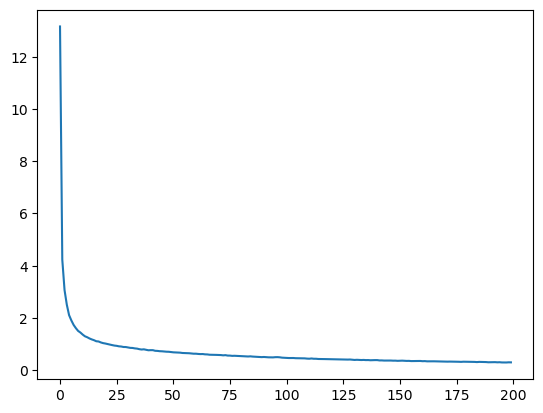

In [69]:
avg_train_loss_model1 = np.reshape(trainingDataset_loss,(num_folds,args['epochs'] )) # 5  = 5 datasets
avg_train_loss_model1 = np.sum(avg_train_loss_model1, axis=0)*(1/num_folds)
print(avg_train_loss_model1)
plt.plot(avg_train_loss_model1)

In [70]:
rank_acc.append(avg_accuracy_list)
rank_pre.append(avg_precision_list)
rank_rec.append(avg_sensitivity_list)
rank_f1.append(f_measure_list)